In [1]:
#external stuff
import h5py
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torchvision.models as models
import torch.nn.functional as F
import torchvision.transforms as transforms
from torch.autograd import Variable
import cv2
import numpy as np
import math
import mahotas
from sklearn.preprocessing import normalize
from sklearn.decomposition import PCA
from sklearn.feature_extraction.image import grid_to_graph
from sklearn.cluster import KMeans, AgglomerativeClustering, AffinityPropagation
import traceback
from uuid import uuid4 as unique_identifier
import random
import os
from time import perf_counter
from glob import glob
import pandas as pd
from scipy.optimize import linear_sum_assignment

from timm.data import resolve_data_config
from timm.data.transforms_factory import create_transform
import timm

In [2]:
#internal stuff
from contour_impl import do_contour_create, do_contour_compare
from imageprocessing import maybetogray,maybetocolor, image_preprocess, canny, recenter
from aberrations import aberrations

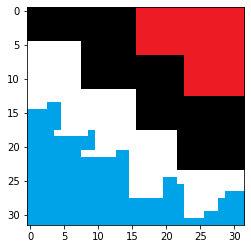

In [3]:
# load some test images
img_files=["stairtest.png","stairtest2.png","cornertest.png","cornertest2.png","cornertest3.png","cornertest4.png","tdl.png","tdl2.png","tokyo.png","tokyo2.png"]
test_images=[cv2.cvtColor(cv2.imread(iname), cv2.COLOR_BGR2RGB) for iname in img_files]
plt.imshow(test_images[0])

In [4]:
def log(kwargs,message):
    if 'log' in kwargs:
        if 'info' in kwargs:
            message['info']=kwargs['info']
        if 'type' in message and message['type']=='Error':
            message['traceback']=traceback.format_exc()
        kwargs['log'] += [message]
        
# neural and small neural work on color images
def make_neural_method():
    # Load the pretrained model
    model = models.resnet18(pretrained=True)
    #strip the final layer to get a feature vector
    model = nn.Sequential(*list(model.children())[:-1])  
    # Set model to evaluation mode
    model.eval()

    def create(img,**kwargs):
        try:
            img=maybetocolor(img)
            scaler = transforms.Resize((224, 224))
            normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406], 
                std=[0.229, 0.224, 0.225])
            to_tensor = transforms.ToTensor()
            pillize = transforms.ToPILImage()
            loader = transforms.Compose([pillize, scaler, to_tensor, normalize])
            l_img = loader(img)
            t_img = Variable(l_img).unsqueeze(0)
            f_vec = model(t_img).squeeze()
            n_vec = f_vec.detach().numpy()
            n_vec = n_vec / np.linalg.norm(n_vec)
            return n_vec
        except:
            log(kwargs,{'type':'Error', 'method':'Neural', 'fn':'create'})
            return None

    def compare(v1, v2,**kwargs):
        try:
            return np.dot(v1, v2)
        except:
            log(kwargs,{'type':'Error', 'method':'Neural', 'fn':'compare'})
            return None   
        
    return {"name":"Neural", "create":create, "compare":compare}

def make_small_neural_method():
    class IconEmbeddingNet(nn.Module):
        def __init__(self):
            super().__init__()
            self.convnet = nn.Sequential(
                nn.Conv2d(3, 32, 5),
                nn.PReLU(),
                nn.MaxPool2d(2, stride=2),
                nn.Conv2d(32, 64, 5),
                nn.PReLU(),
                nn.MaxPool2d(2, stride=2))
            self.fc = nn.Sequential(
                nn.Linear(64 * 4 * 4, 256),
                nn.PReLU(),
                nn.Linear(256, 256),
                nn.PReLU(),
                nn.Linear(256, 8)
                )
        def forward(self, x):
            output = self.convnet(x)
            output = output.view(output.size()[0], -1)
            output = self.fc(output)
            return output

        def get_embedding(self, x):
            return self.forward(x)
        
    model = IconEmbeddingNet()
    model.load_state_dict(torch.load("models/IconEmbeddingNet.pt"))
    model.eval()
    
    def create(img,**kwargs):
        try:
            img=maybetocolor(img)
            scaler = transforms.Resize((28, 28))
            normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406], 
                std=[0.229, 0.224, 0.225])
            to_tensor = transforms.ToTensor()
            pillize = transforms.ToPILImage()
            loader = transforms.Compose([pillize, scaler, to_tensor, normalize])
            l_img = loader(img)
            t_img = Variable(l_img).unsqueeze(0)
            f_vec = model(t_img).squeeze()
            n_vec = f_vec.detach().numpy()
            return n_vec
        except:
            log(kwargs,{'type':'Error', 'method':'Small_Neural', 'fn':'create'})
            return None

    def compare(v1, v2,**kwargs):
        try:
            sim = 100.0/(np.linalg.norm(v1-v2)+1)
            return sim
        except:
            log(kwargs,{'type':'Error', 'method':'Small_Neural', 'fn':'compare'})
            return None
    
    return {"name":"Small_Neural", "create":create, "compare":compare}


def make_orb_method():
    orb = cv2.ORB_create()
    matcher = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

    def create(img, **kwargs):
        try:
            img = maybetogray(img)
            # old image preprocessing
            # this will be moved to the more general framework
            img = cv2.resize(img,None, fx=13, fy=13, interpolation=cv2.INTER_AREA)

            # find the keypoints and descriptors with orb
            kp1, des1 = orb.detectAndCompute(img,None)
            if len(kp1) < 2:
                des1 = None
            return des1
        except:
            log(kwargs,{'type':'Error', 'method':'Orb', 'fn':'create'})
            return None

    def compare(img_kp1, img_kp2, **kwargs):
        try:
            matches = matcher.match(img_kp1,img_kp2)
            score = len(matches)
            return score
        except:
            log(kwargs,{'type':'Error', 'method':'Orb', 'fn':'compare'})
            return 0
        
    return {"name":"Orb", "create":create, "compare":compare}

def make_zernike_method():
    # image preprocessing
    def zcenter(img):
        _, _, min_x, min_y, max_x, max_y, edges1 = image_preprocess(img) 
        edges2 = edges1[min_y:max_y+1, min_x:max_x+1]
        edges2 = cv2.resize(edges2, dsize=(32, 32), interpolation=cv2.INTER_CUBIC)
        return edges2
    def create(img, **kwargs):
        try:
            img = maybetogray(img)
            #zcenter is the image preprocessing code that was here before,
            #but zernike_moments is the real functional part of the method
            # this will be moved to the more general framework
            edges2=zcenter(img)
            zernike = mahotas.features.zernike_moments(edges2, 16)  
            return normalize(zernike[:,np.newaxis], axis=0).ravel()
        except:
            log(kwargs,{'type':'Error', 'method':'Zernike', 'fn':'create'})
            return None

    def compare(x,y, **kwargs):
        try:
            return np.dot(x,y)
        except:
            log(kwargs,{'type':'Error', 'method':'Zernike', 'fn':'compare'})
            return 0
    return {"name":"Zernike", "create":create, "compare":compare}

def make_center_zernike_method():
    def create(img, **kwargs):
        try:
            img = recenter(img)
            img = maybetogray(img)
           
            zernike = mahotas.features.zernike_moments(img, 16)  
            return normalize(zernike[:,np.newaxis], axis=0).ravel()
        except:
            log(kwargs,{'type':'Error', 'method':'CenterZernike', 'fn':'create'})
            return None

    def compare(x,y, **kwargs):
        try:
            return np.dot(x,y)
        except:
            log(kwargs,{'type':'Error', 'method':'CenterZernike', 'fn':'compare'})
            return 0
    return {"name":"CenterZernike", "create":create, "compare":compare}

def make_color_zernike_method():
    def create(img, **kwargs):
        try:
            img = recenter(img)
            gimg = maybetogray(img)
           
            zernikes = np.array([mahotas.features.zernike_moments(gimg, 16)]+[mahotas.features.zernike_moments(img[:,:,i], 16) for i in range(img.shape[-1])])
            zernikes = normalize(zernikes, axis=1)
            return zernikes.ravel()/4
        except:
            log(kwargs,{'type':'Error', 'method':'ColorZernike', 'fn':'create'})
            return None

    def compare(x,y, **kwargs):
        try:
            return np.dot(x,y)
        except:
            log(kwargs,{'type':'Error', 'method':'ColorZernike', 'fn':'compare'})
            return 0
    return {"name":"ColorZernike", "create":create, "compare":compare}

def make_contour_method(fractions=[.05,.1,.15,.2,.25,.3,.35,.4,.45,.5,.55,.6,.65,.7,.75,.8,.85,.9,.95]):
    def create(img, **kwargs):
        try:
            return do_contour_create(img,fractions,**kwargs)
        except:
            log(kwargs,{'type':'Error', 'method':'Contour', 'fn':'create'})
            return None
        
    def compare(query1, query2, error=0.1, **kwargs):
        try:
            return do_contour_compare(query1, query2, fractions,error,**kwargs)
        except:
            log(kwargs,{'type':'Error', 'method':'Contour', 'fn':'compare'})
            return 0
    
    return {"name":"Contour", "create":create, "compare":compare}

our_methods=[make_neural_method, make_small_neural_method, make_zernike_method, make_center_zernike_method, make_color_zernike_method, make_orb_method, make_contour_method]
def method_split_hungarian(method, splitter):
    def create(img, **kwargs):
        try:
            imgs = splitter(img, **kwargs)
            return [method["create"](i, **kwargs) for i in imgs]
        except:
            log(kwargs,{'type':'Error', 'method':'SplitWrapped_'+method["name"], 'fn':'create'})
            return None

    def compare(x,y, **kwargs):
        try:
            vals = np.array([[method["compare"](i,j,**kwargs) for i in x] for j in y])
            rows, cols = linear_sum_assignment(vals)
            if len(rows==0):
                print("divide by zero incoming")
            return vals[rows,cols].sum()/len(rows)
        except:
            log(kwargs,{'type':'Error', 'method':'SplitWrapped_'+method["name"], 'fn':'compare'})
            return 0
    return {"name":'SplitWrapped_'+method["name"], "create":create, "compare":compare}
class database:
    def __init__(self, method, images=[], preprocess=None, **kwargs):
        self.name = method["name"]
        self.create = method["create"]
        self.compare = method["compare"]
        self.preprocess = preprocess[1] if preprocess is not None else noop
        self.preprocessing_name = preprocess[0] if preprocess is not None else "None"
        self.db = {i:self.create(self.preprocess(images[i]), **kwargs) for i in range(len(images))}
        
    def find(self, img, candidates=None, others=[], should_sort=True, **kwargs):
        imgq = self.create(self.preprocess(img), **kwargs)
        candidates = candidates or self.db.keys()
        tmp_db = {-i:self.create(others[i], **kwargs) for i in range(len(others))}
        results = [(i, self.compare(imgq, self.db[i], **kwargs)) for i in candidates]
        tmp_results = [(i, self.compare(imgq, tmp_db[i], **kwargs)) for i in tmp_db.keys()]
        if should_sort:
            return sorted(results+tmp_results, key=lambda x: -x[1])
        else:
            return results+tmp_results

In [5]:
# image manipulation
# for all the different methods we first make a copy of the image just in case
# something decides to modify the original.
# Thank God for gigabytes of RAM
def stack(funcs):
    #compose several image manipulations 
    def nf(img):
        img=img[:]
        for f in funcs:
            img=f(img)
        return img
    return nf
def noop(img):
    return img
def color_reduce_kmeans(img, n_colors=8):
    img=img[:]
    h,w,c=img.shape
    fimg=np.clip(img.reshape(-1,3)/255,0.05,0.95)
    km=KMeans(n_clusters=n_colors,random_state=0).fit(fimg)
    means=np.clip(km.cluster_centers_,0.0,1.0)
    labels=km.predict(fimg)
    return (means[labels].reshape(img.shape)*255).astype(np.uint8)

def smooth_median(img,ks=5,n=2):
    img=img[:]
    for i in range(n):
        img=cv2.medianBlur(img,ks)
    return img
def std_size(img):
    img=img[:]
    return cv2.resize(img,(128,128),interpolation=cv2.INTER_AREA)

def big_size(img):
    return cv2.resize(img,None, fx=13, fy=13, interpolation=cv2.INTER_AREA)

# segmentation
def scast2(x,r):
        xpad=np.pad(x,[[0,0],[0,1]],mode="constant", constant_values=r)
        return xpad/np.linalg.norm(x,axis=1,keepdims=True)
def genkeys(n,d):
    r=np.random.normal(size=(n,d))
    r=r/np.linalg.norm(r,axis=1,keepdims=True)
    r=np.pad(r,[[1,0],[0,1]],mode="constant",constant_values=0)
    r[0,-1]=1
    return r
def meancolor(img,b):
    return np.floor(np.sum(img[b],(0)) / (0.01+np.sum(b))).astype(np.uint8)
def clamp(x, m,M):
    if x < m:
        return m
    if x > M:
        return M
    return x
def gsb(s,margin=10):
    h,w=s.shape
    x,y=np.where(s)
    x1=clamp(x.min()-margin,0,w)
    y1=clamp(y.min()-margin,0,h)
    x2=clamp(x.max()+margin,0,w)
    y2=clamp(y.max()+margin,0,h)
    return x1,y1,x2,y2
    #return x.min()-margin, y.min()-margin, x.max()+margin, y.max()+margin
def cropresize(img,b,bg=None,**kwargs):
    try:
        x1,y1,x2,y2=gsb(b)
        if bg is not None:
            img=img.copy()
            img[b!=True]=bg
        diff = max(x2-x1, y2-y1)
        xc = (x2+x1)/2
        yc = (y2+y1)/2
        return cv2.resize(img[x1:x2,y1:y2,:],img.shape[:-1])
    except:
        log(kwargs,{'type':'Error', 'method':'Segmentation', 'fn':'cropresize'})
        return None
def segment_labels(img,labels,bg=None,rejection=0.0,**kwargs):
    ulabels=np.unique(labels)
    h,w=labels.shape
    total=h*w
    masks=[labels==i for i in ulabels]
    # throw away any masks that cover less than 'rejection' percent of the image
    masks=[m for m in masks if np.sum(m) >= (rejection*total)]
    segs= [cropresize(img,b,bg,**kwargs) for b in masks]
    return [s for s in segs if s is not None]

def segment_agglomerative(img,n_shapes=10,bg=None,**kwargs):
    img=img[:]
    gimg=maybetogray(img)
    fimg=gimg.reshape(-1,1)
    connectivity = grid_to_graph(*gimg.shape)
    clustering = AgglomerativeClustering(n_clusters=n_shapes, linkage="ward",connectivity=connectivity).fit(fimg)
    labels=np.array(clustering.labels_).reshape(gimg.shape)
    return segment_labels(img,labels,bg=bg,**kwargs)

def segment_kmeans(img, n_colors=10, n_shapes=10,bg=None,**kwargs):
    img=img[:]
    h,w,c=img.shape
    fimg=np.clip(img.reshape(-1,3)/255,0.05,0.95)
    km=KMeans(n_clusters=n_colors,random_state=0).fit(fimg)
    means=np.clip(km.cluster_centers_,0.0,1.0)
    labels=np.array(km.predict(fimg)).reshape(*img.shape[:-1])
    return segment_labels(img,labels,bg=bg,**kwargs)

def segment_colors(img, threshold=.98,bg=None,**kwargs):
    # image is assumed to be HxWx3
    v=np.reshape(img,(-1,3))/255
    n=scast2(v-np.mean(v,0),0.01)
    r=genkeys(200,3)

    ids=np.argmax(n.dot(r.transpose()), axis=1)
    uids=np.unique(ids)
    w=np.array([np.sum(ids==i) for i in uids])/ids.size
    ws=np.argsort(-w)
    sids=uids[ws]
    csm=np.cumsum(w[ws])
    iids=np.array([sids[i] for i in range(1,len(sids)) if csm[i-1]<threshold])
    rids=ids.reshape(img.shape[:-1])
    return segment_labels(img,rids,bg=bg,**kwargs)

def plot_many(imgs,n_c=3):
    # convenience function to plot many images
    n_r = (len(imgs)//n_c)+1
    cc=1
    fig=plt.figure(figsize=(10,10))
    for i in imgs:
        fig.add_subplot(n_r,n_c,cc)
        plt.imshow(i)
        cc+=1
        
processing_pipelines = [
    None,
    ("color_reduce_kmeans", color_reduce_kmeans),
    ("smooth_median", smooth_median),
    ("recenter", recenter),
    ("recenter, reduce, smooth", stack([recenter, color_reduce_kmeans, smooth_median]))
]

In [6]:
num_images = 1000
image_set_name = "logo100"
logdir = "Logs20220211TEST"

hdf5_file = h5py.File('LLD-logo.hdf5', 'r')
images = hdf5_file['data'][:num_images]
sizes = hdf5_file['shapes'][:num_images]

# transpose the images because they're stored in a weird color channel first format, as indicated by shape[0] being 3
images = np.array([np.transpose(i/255,(1,2,0)) for i in images])
goodsizes = [np.product(s) == 480000 for s in sizes]
goodimages = images[goodsizes]

print(len(running_images))
print("Loading Completed")

NameError: name 'running_images' is not defined

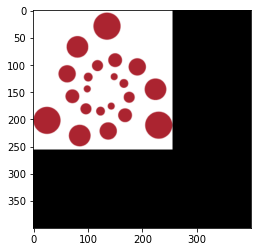

In [7]:
plt.imshow(images[24])

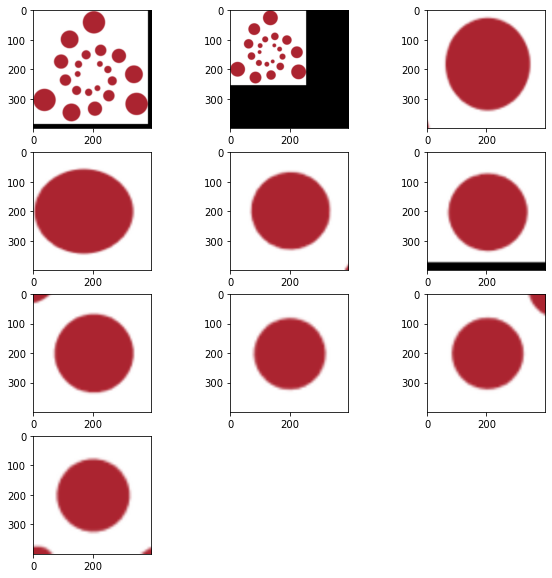

In [8]:
plot_many(segment_agglomerative(images[24]))

In [72]:
running_images=goodimages[:100]#+test_images
#running_images=np.array([maybetogray(i) for i in running_images])
#running_methods=[make_timm_method(i,cuda=True) for i in timm_names]+[m() for m in our_methods]
running_methods=[method_split_hungarian(make_small_neural_method(), segment_colors), method_split_hungarian(make_small_neural_method(), segment_agglomerative), make_small_neural_method()]
err=run_all(running_methods, running_images,aberrations,processing_pipelines,logdir=logdir)

ValueError: zero-size array to reduction operation maximum which has no identity

In [70]:
maybetogray

<function imageprocessing.maybetogray(img)>

In [57]:
sizes[goodsizes]

array([[  3, 400, 400],
       [  3, 400, 400],
       [  3, 400, 400],
       ...,
       [  3, 400, 400],
       [  3, 400, 400],
       [  3, 400, 400]], dtype=int64)

In [39]:
k=0
for i in images:
    k+=1
    print(k)
    # segment colors does not work, gives only single patch for any image tested
    #c=segment_colors(i)
    c=segment_agglomerative(i)
    if len(c)>1:
        break
    

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100


0


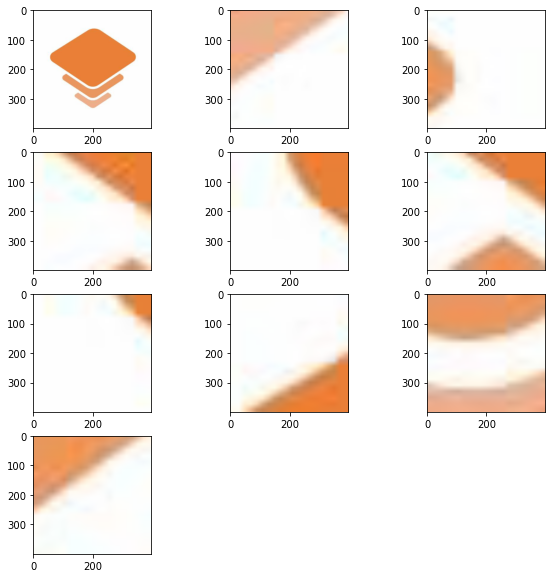

1


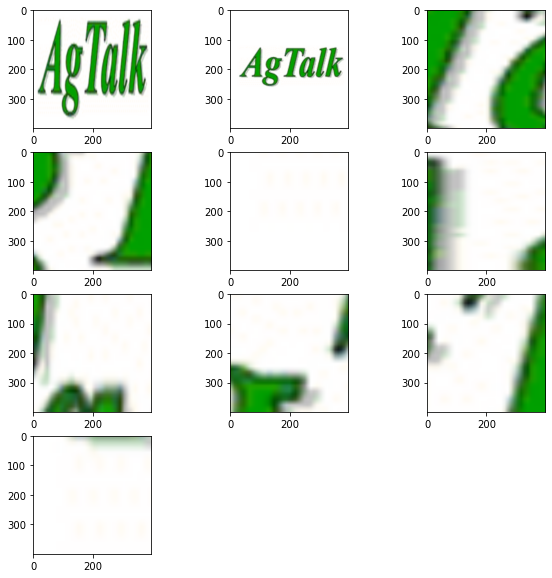

2


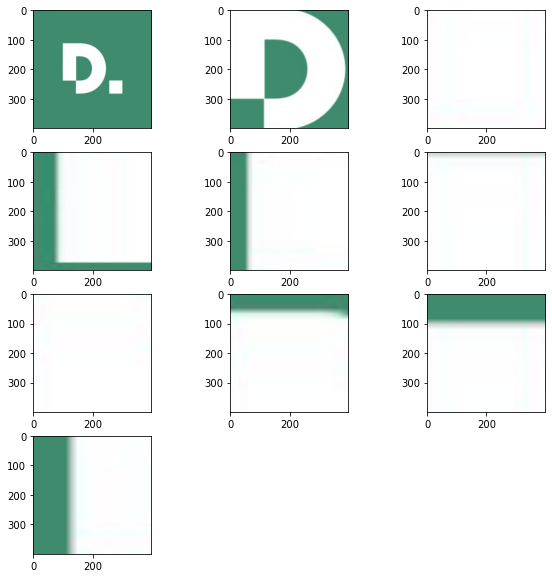

3


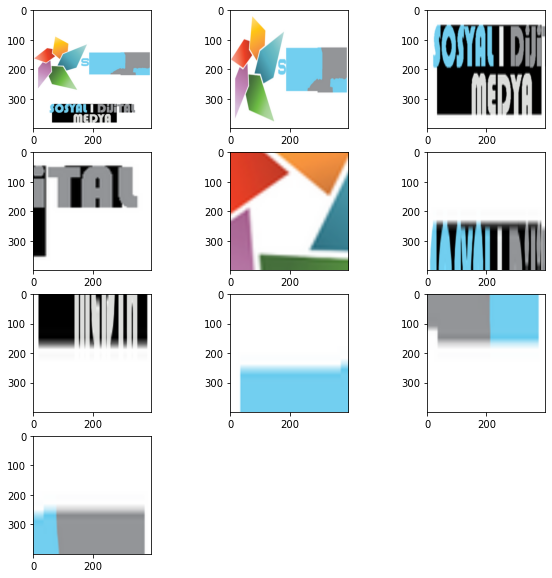

4


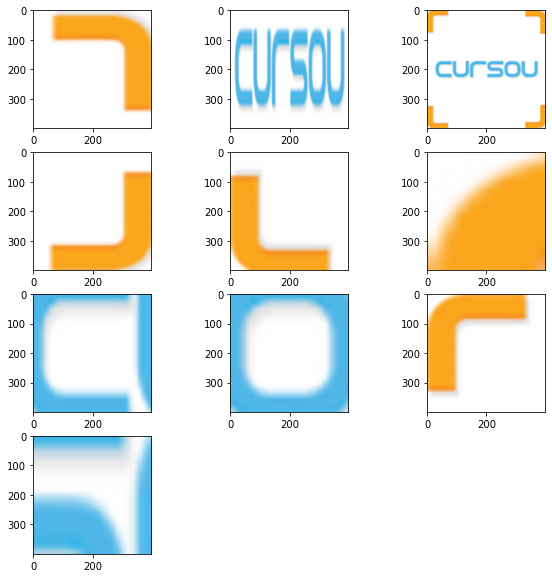

5


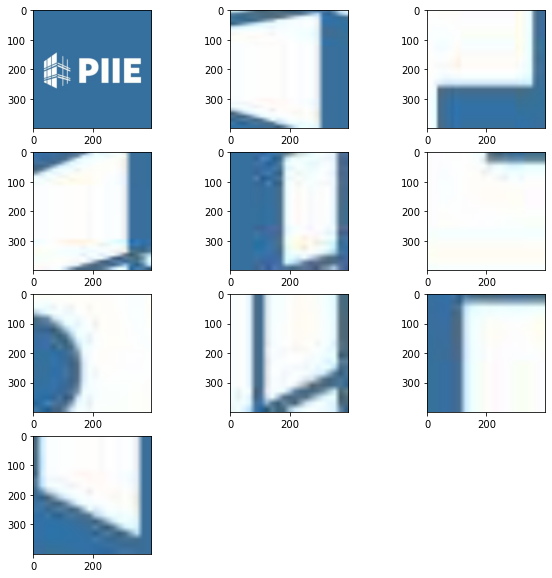

6


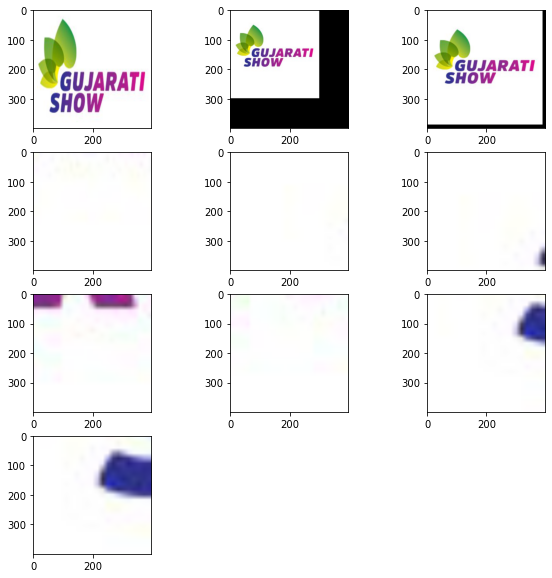

7


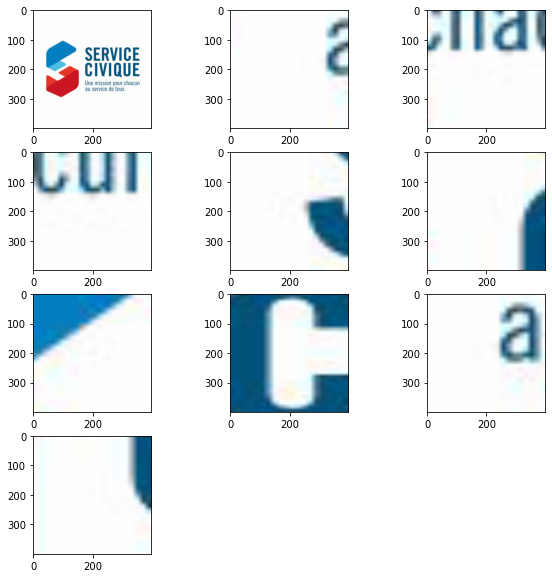

8


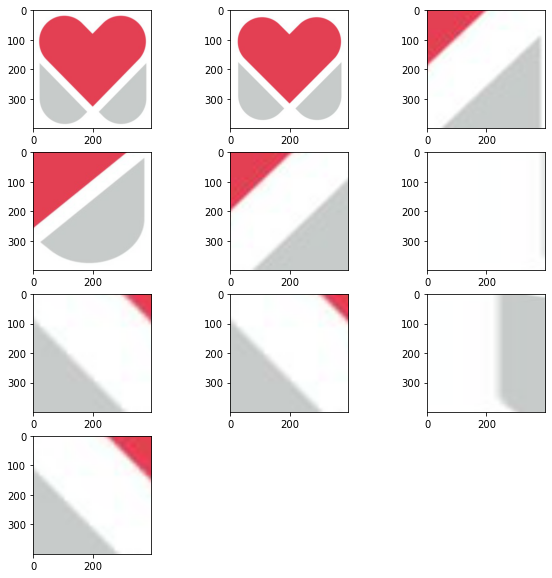

9


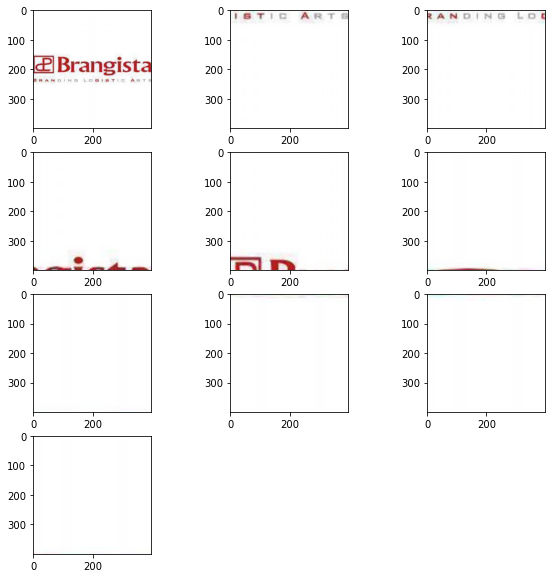

10


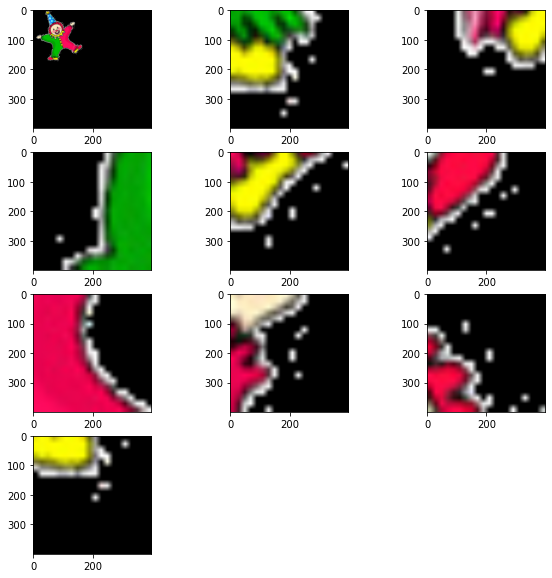

11


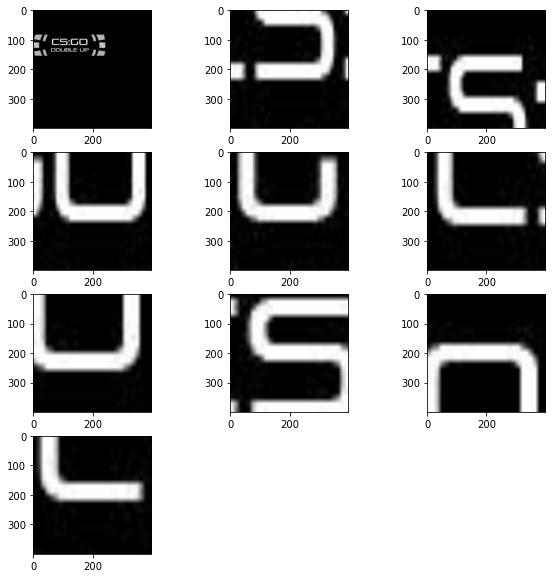

12


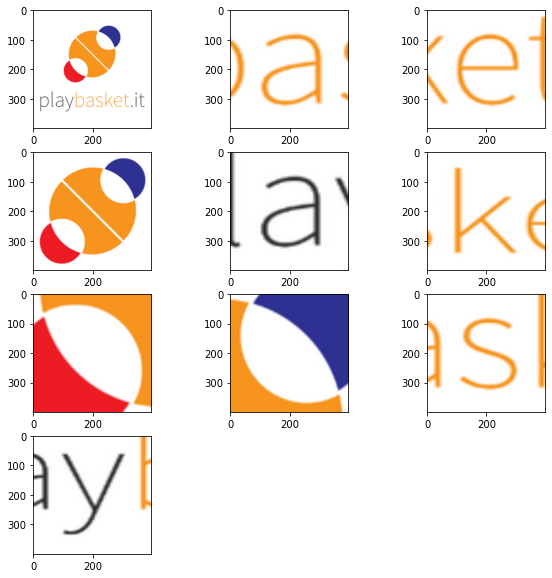

13


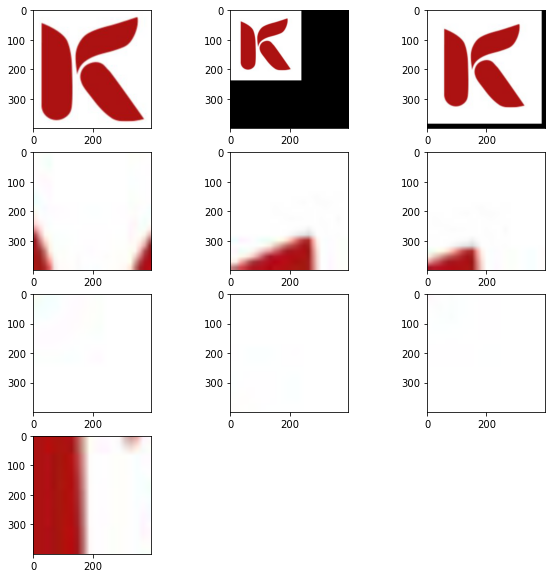

14


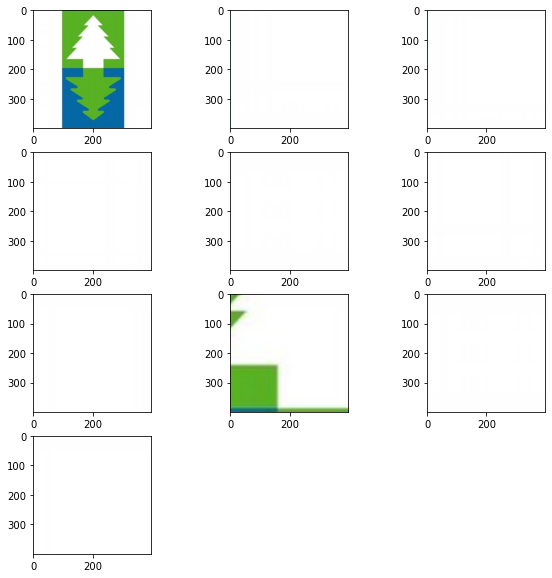

15


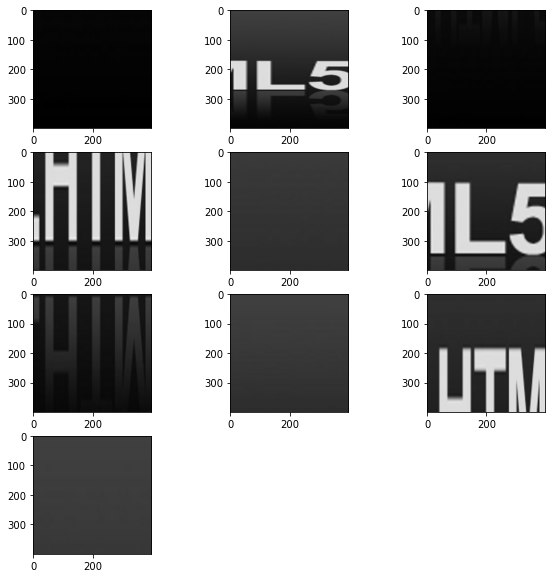

16


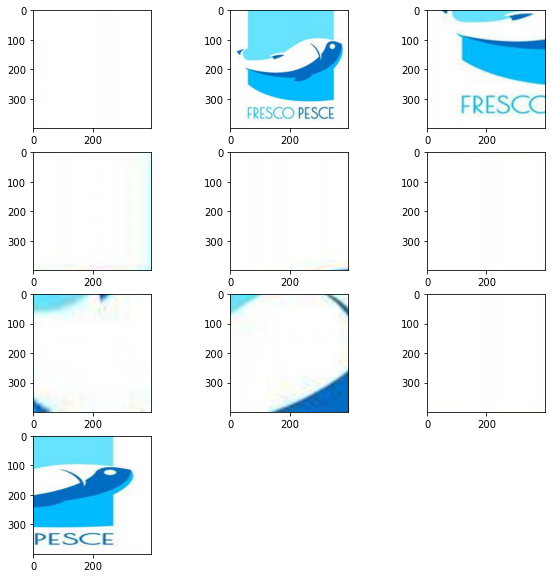

17


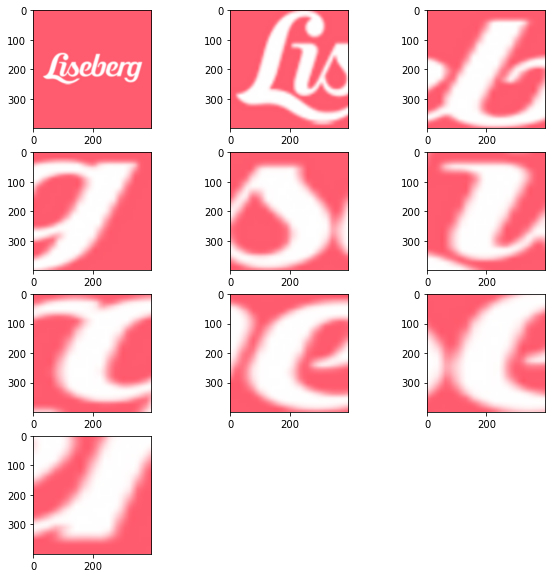

18


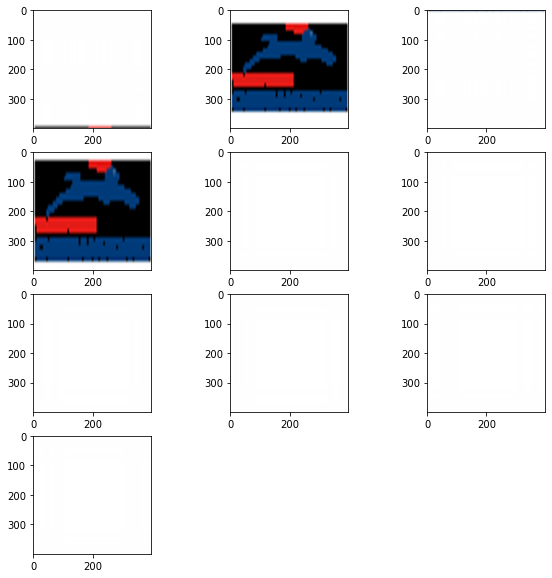

19


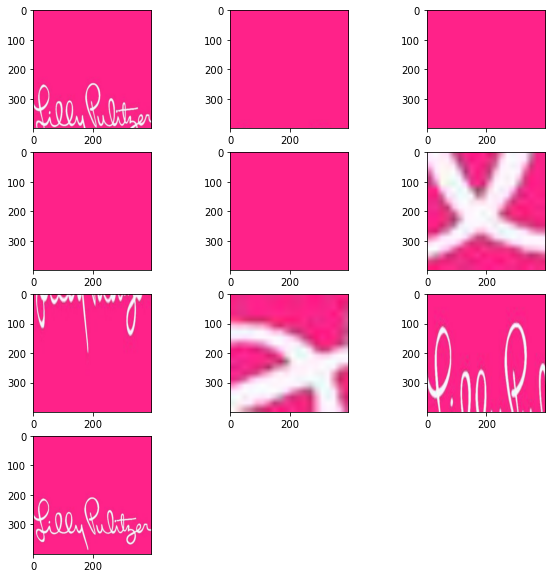

20


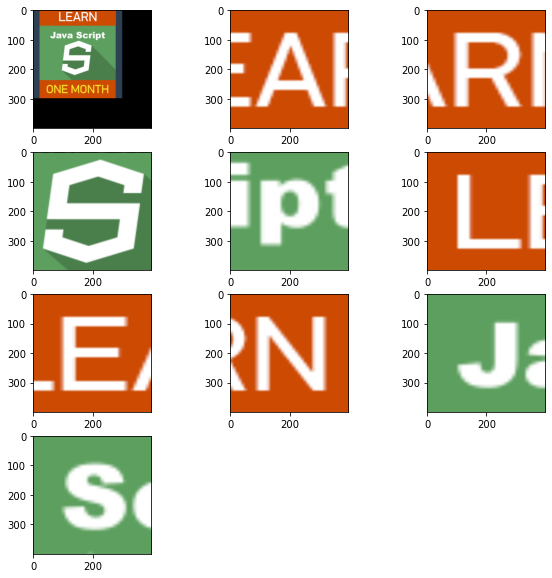

21


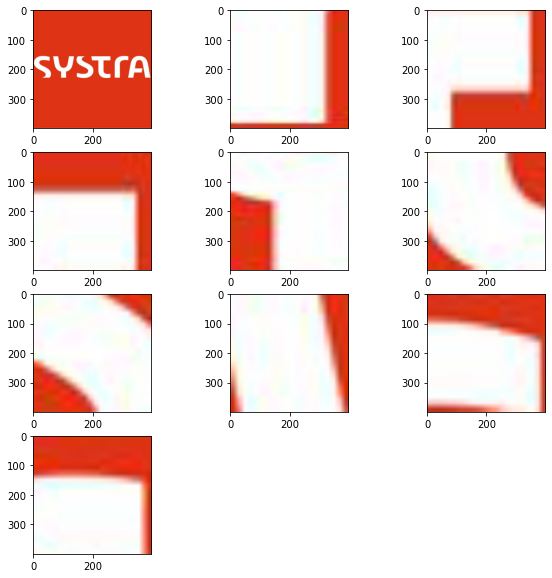

22


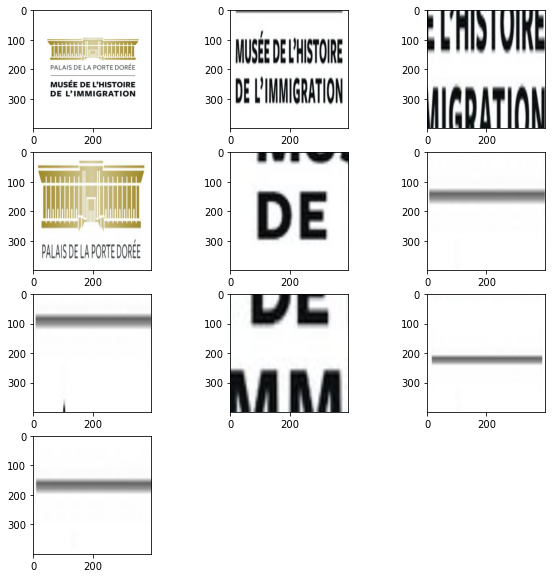

23


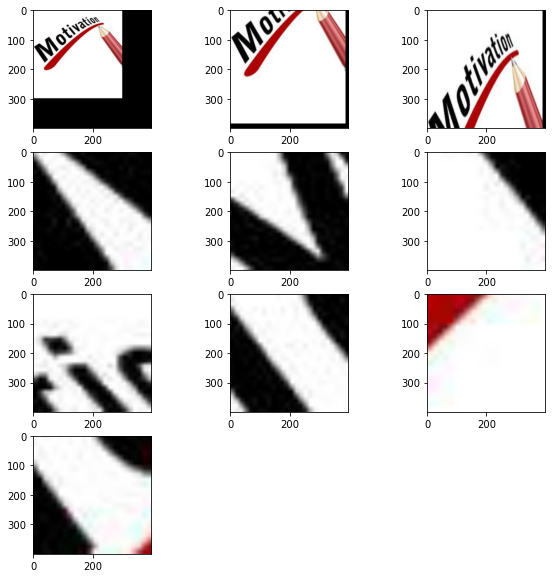

24


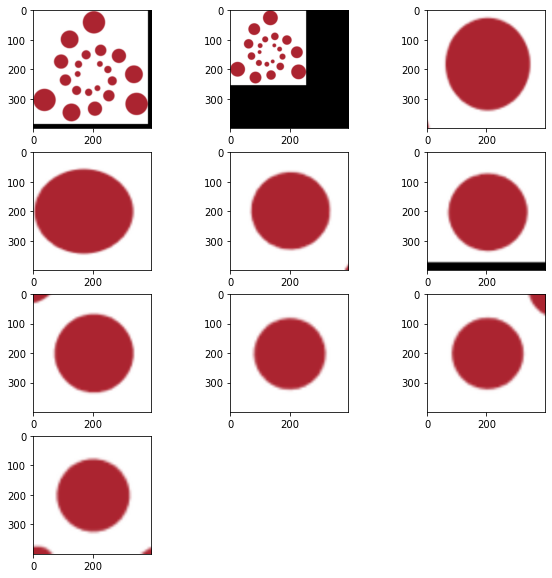

25


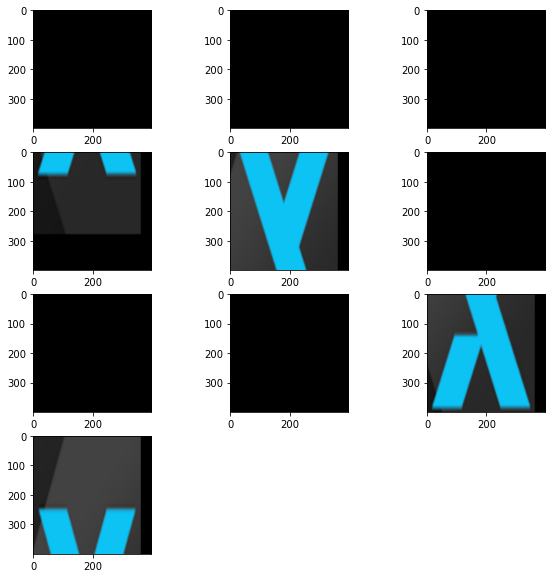

26


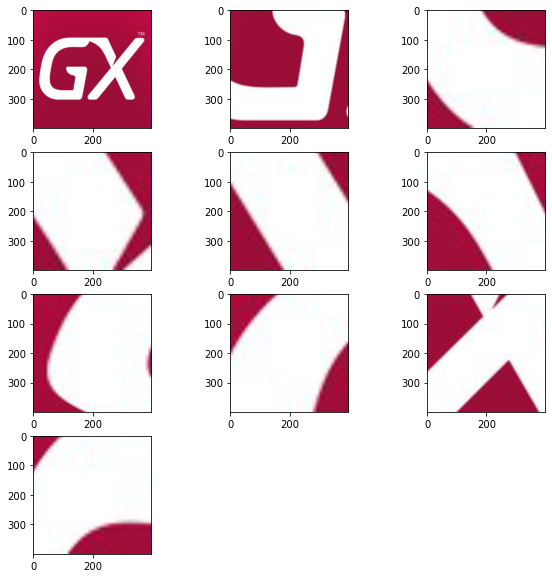

27


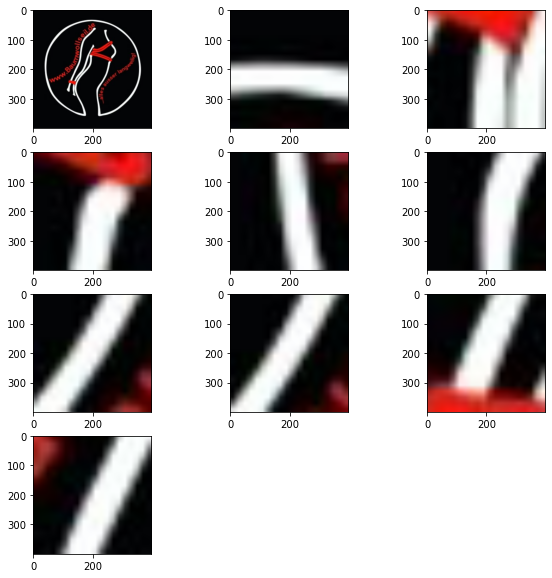

28


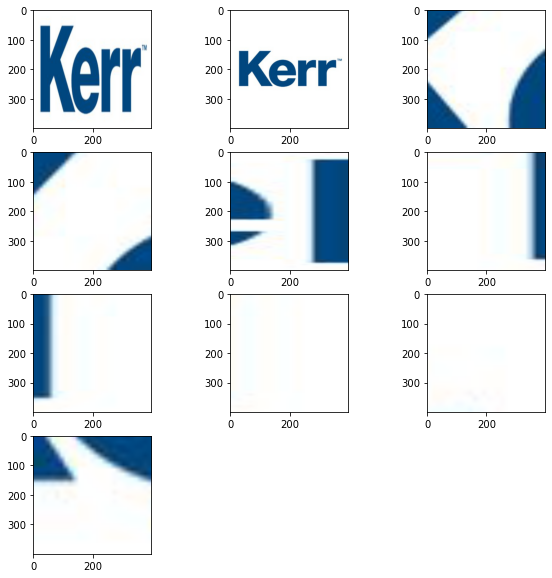

29


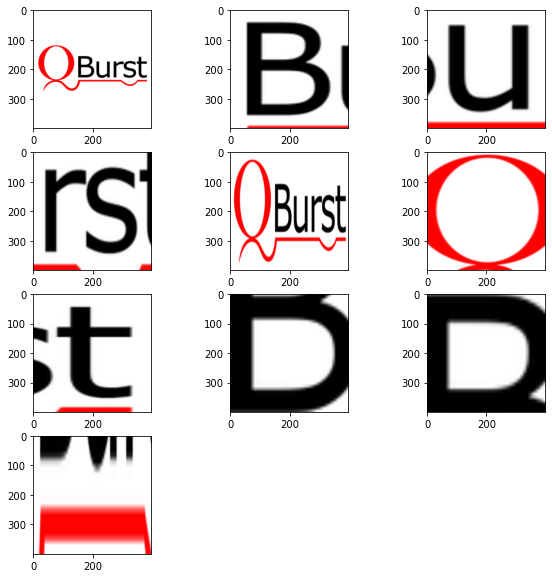

30


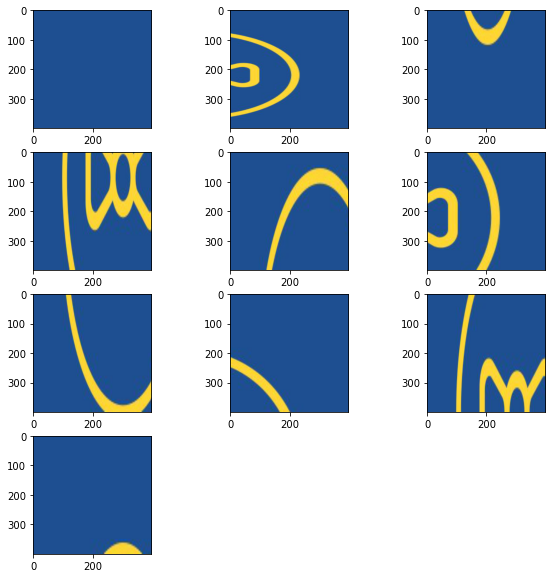

31


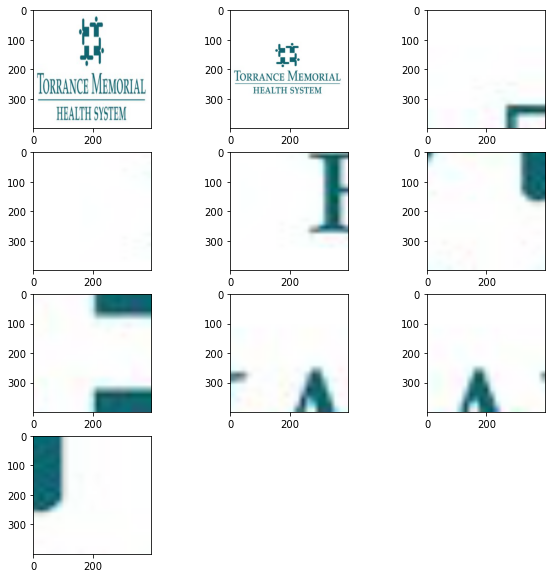

32


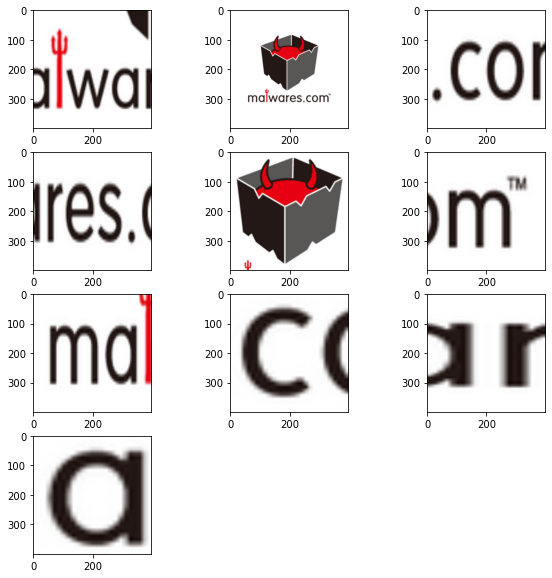

33


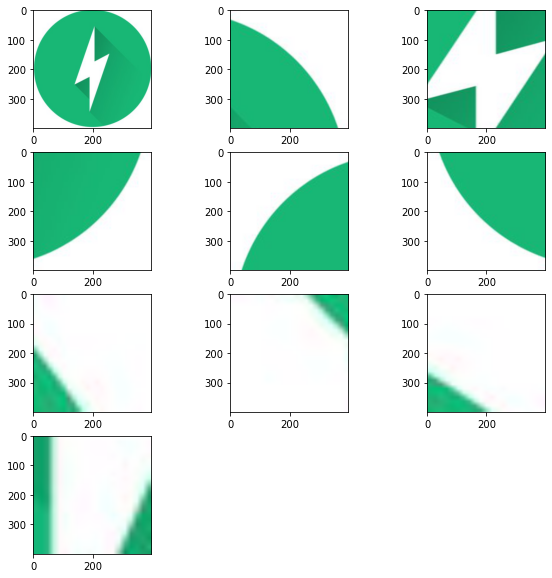

34


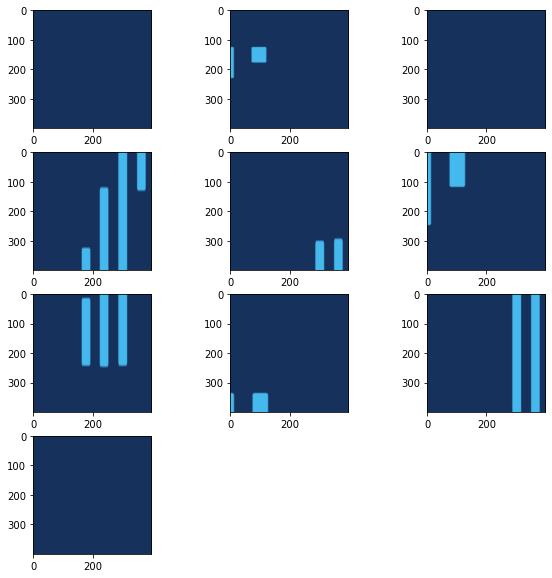

35


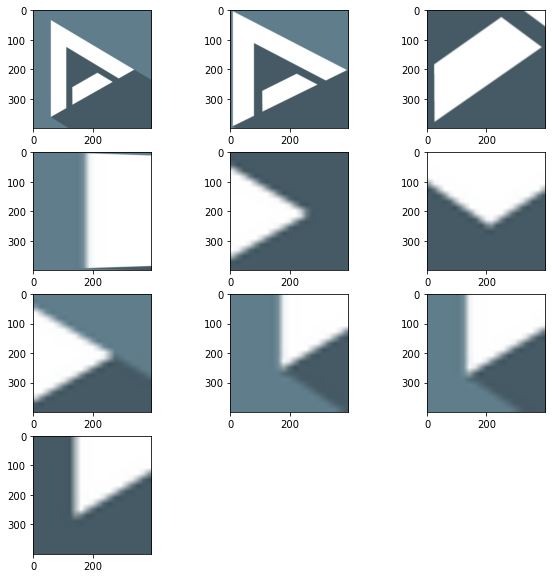

36


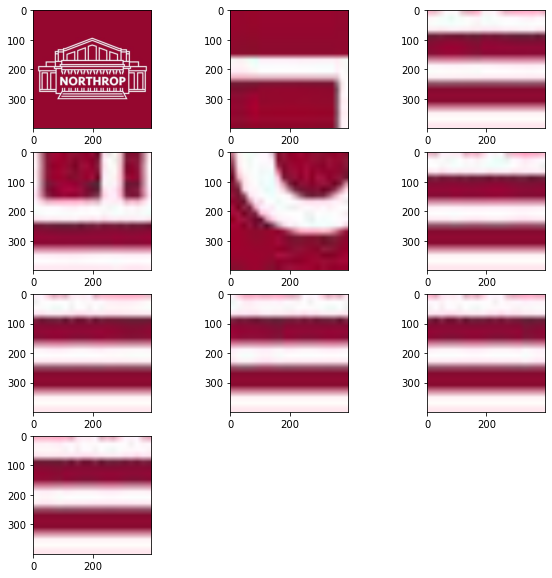

37


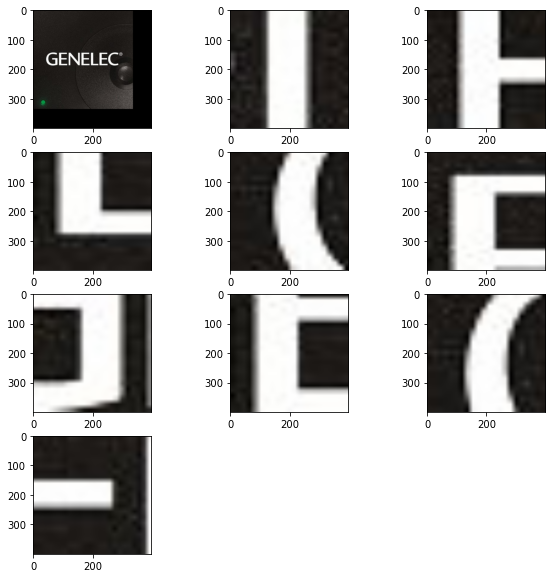

38


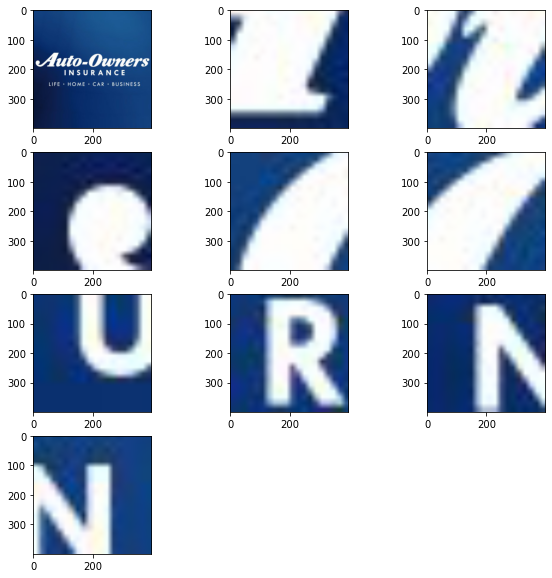

39


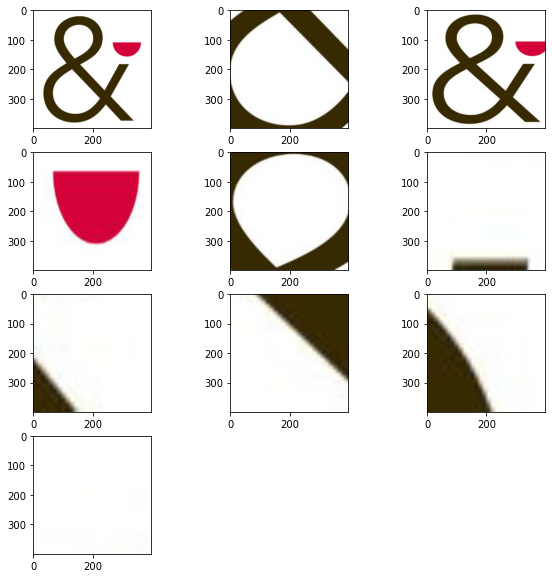

40


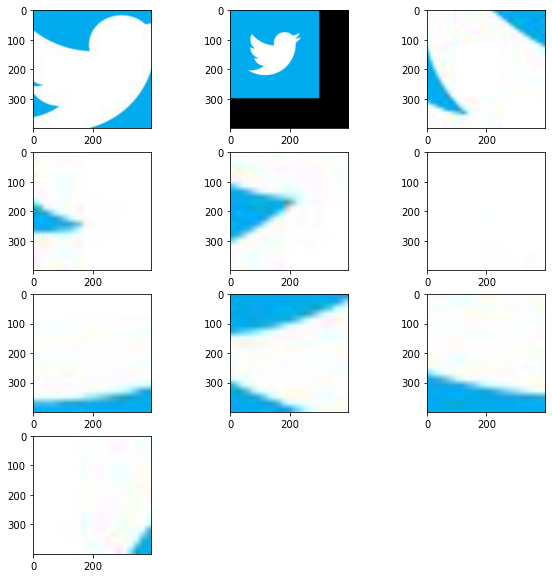

41


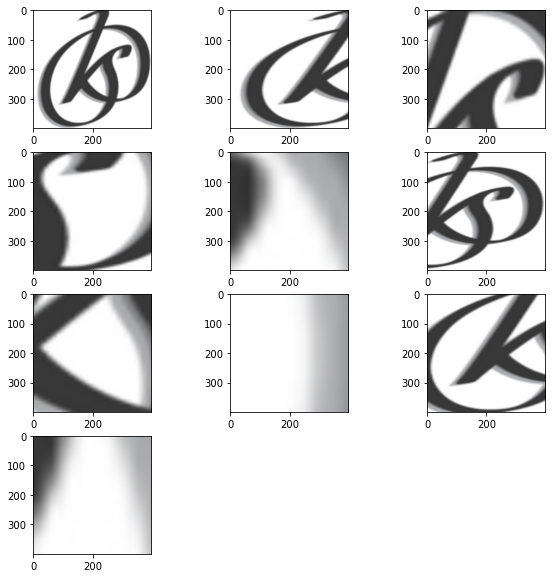

42


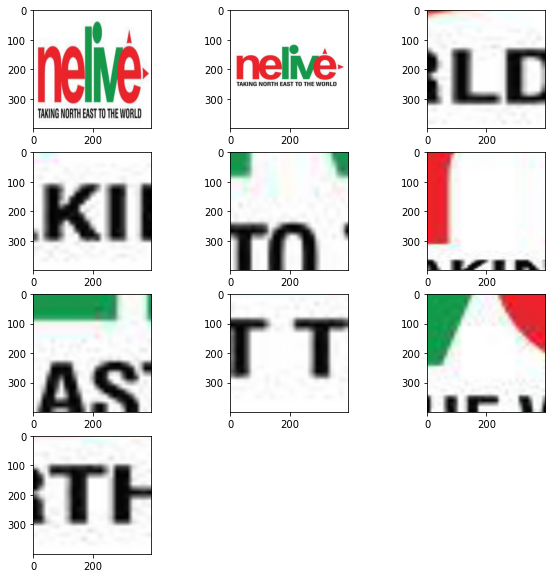

43


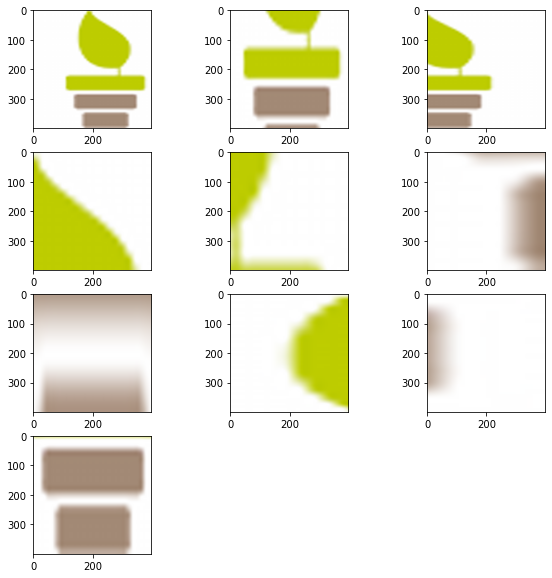

44


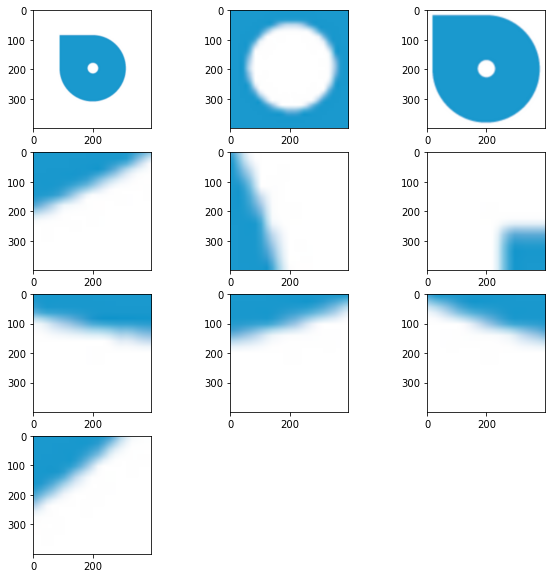

45


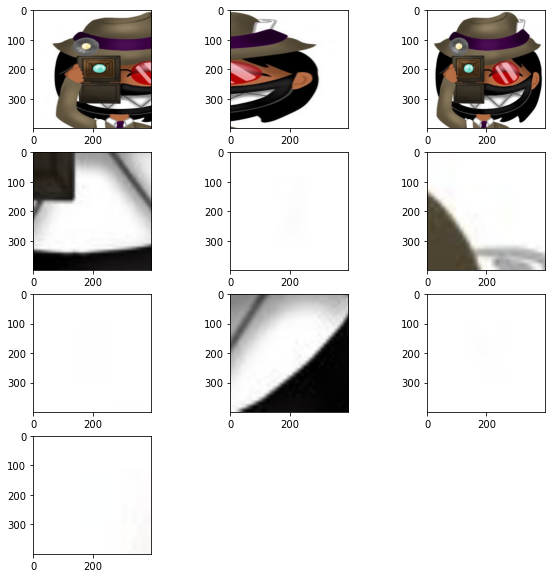

46


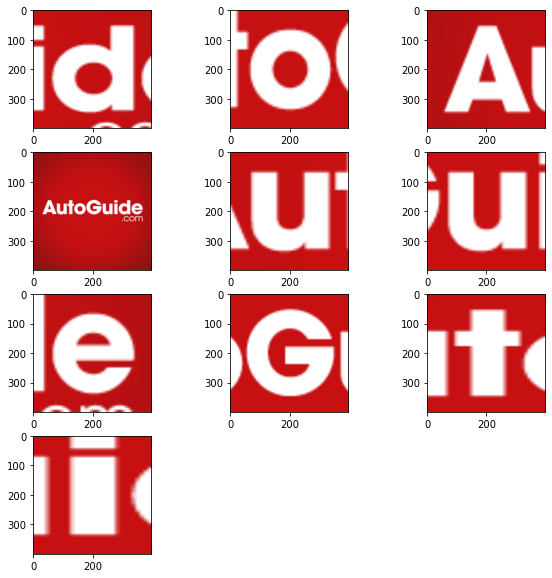

47


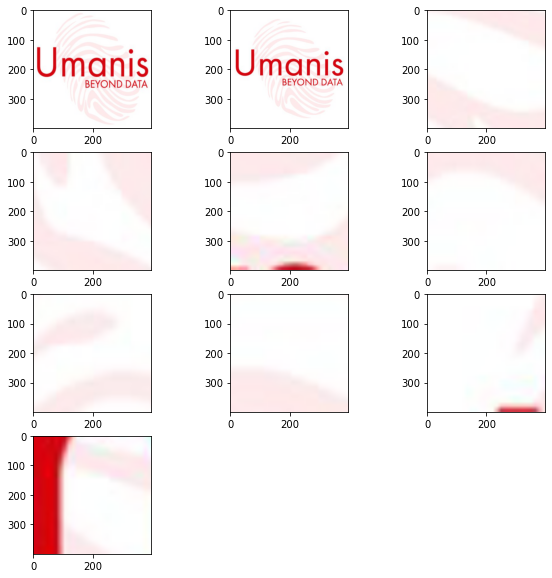

48


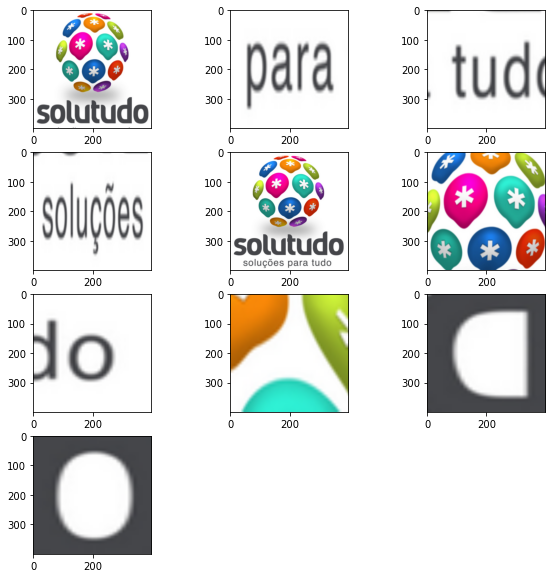

49


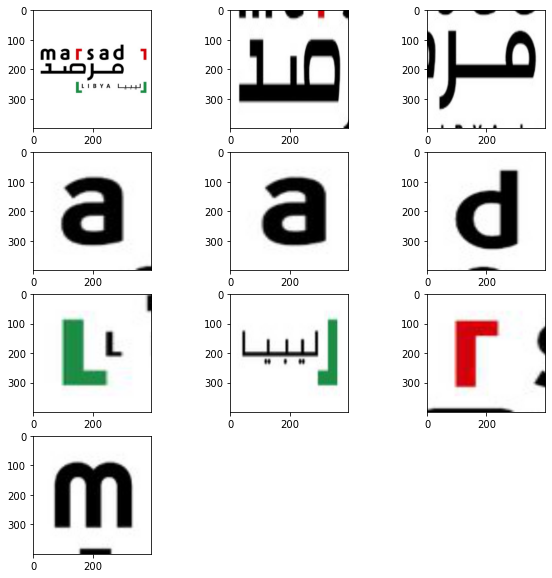

50


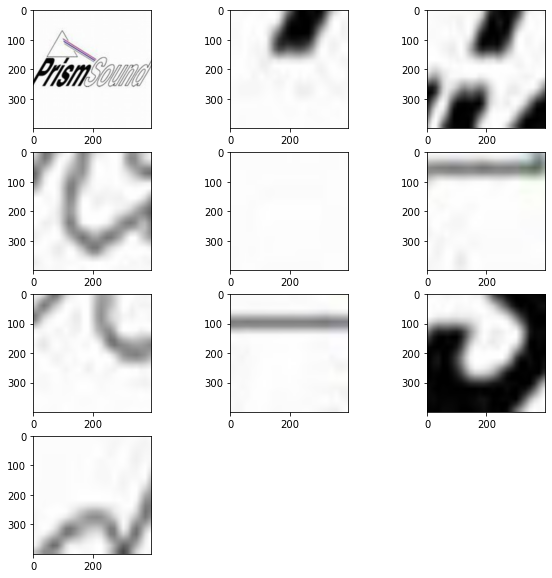

51


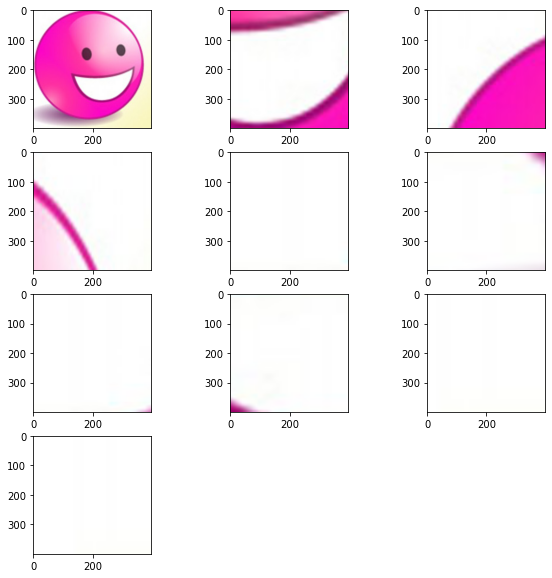

52


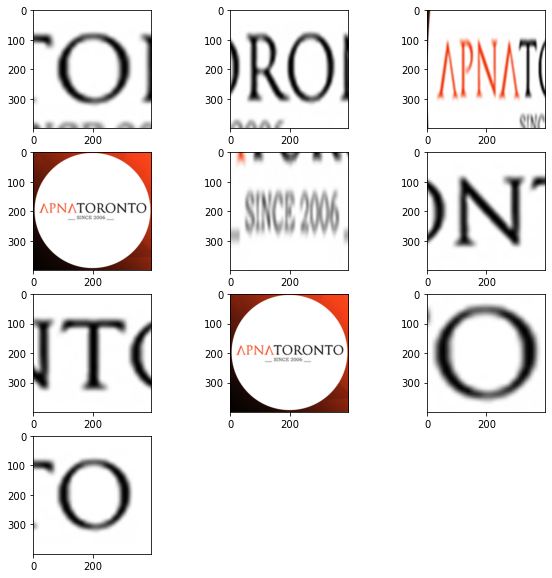

53


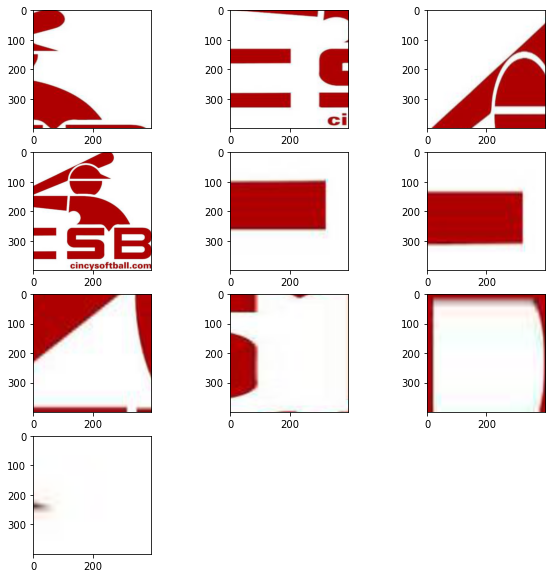

54


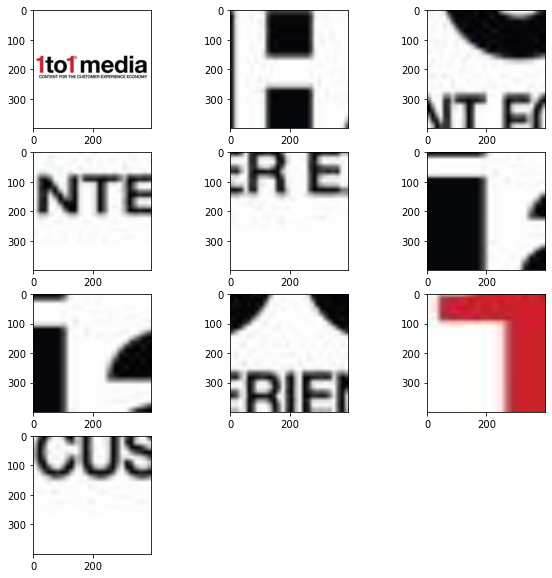

55


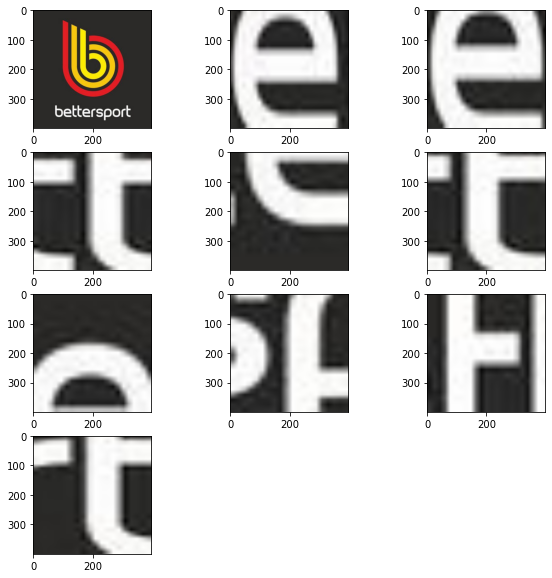

56


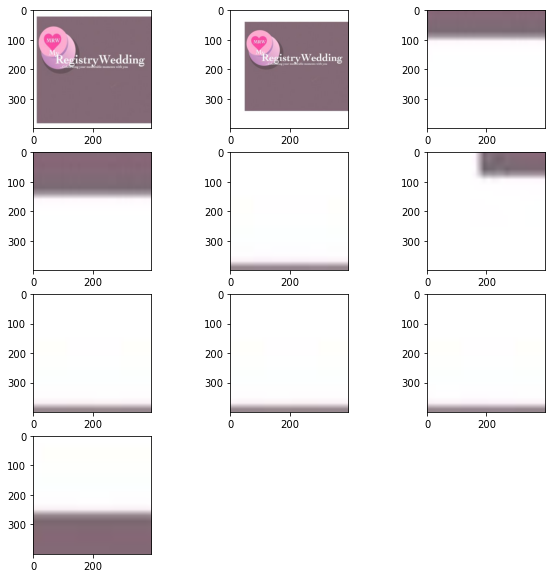

57


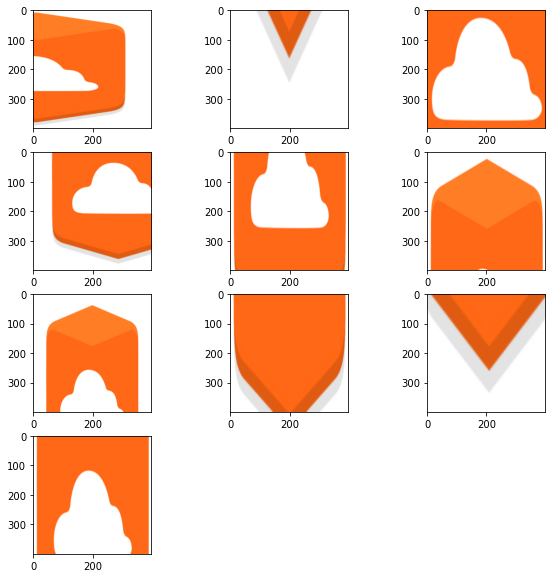

58


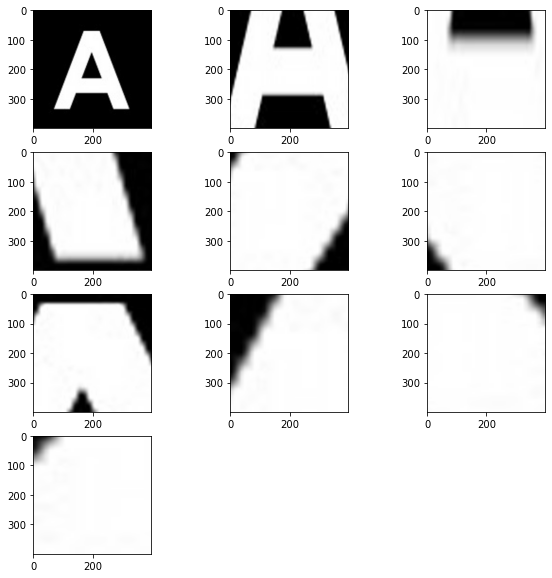

59


KeyboardInterrupt: 

In [49]:
k=-1
for i in images:
    k+=1
    print(k)
    plot_many(segment_agglomerative(i))
    plt.show()
# classes of logos on which the segmentation fails hard are those with mixed text and graphics
# image 20 shows a great example of extracting single letters, 22 is somewhat similar
# 24 is very interesting, splits a field into elements, all identical
# detailed examination of 100 logos with agglomerative splitting
# 0 sucks, bunch of undistinct diagonals
# 1 gets text and then a bunch of garbage
# 2 gets text and a bunch of garbage
# 3 idetifies the salient parts of the logo, text and graphic
# 4 is almost perfect
# 5 is totally broken, all garbage
# 6 crops out the zero padding of the logo, but not great since it doesn't actually split the logo
# 7 identifies some letters
# 8 is a lot of diagonals
# 9 is trying to extract text but not doing it well
# 10 is garbage
# 11 tries to get text
## 12 does a great job of isolating the graphic and also of splitting it
# 13 doesn't really segment the graphic but does identify the foreground
### the zero padding might really screw up a lot of logos
### so I went ahead and filtered out the zero padded images. The data above is
### for the unadulterated full set.

0


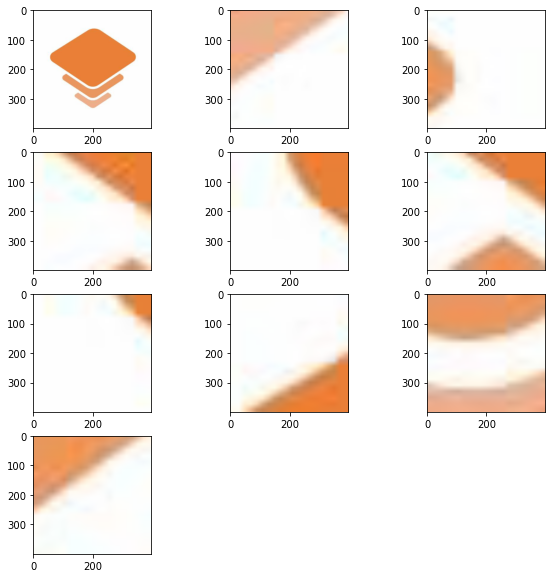

1


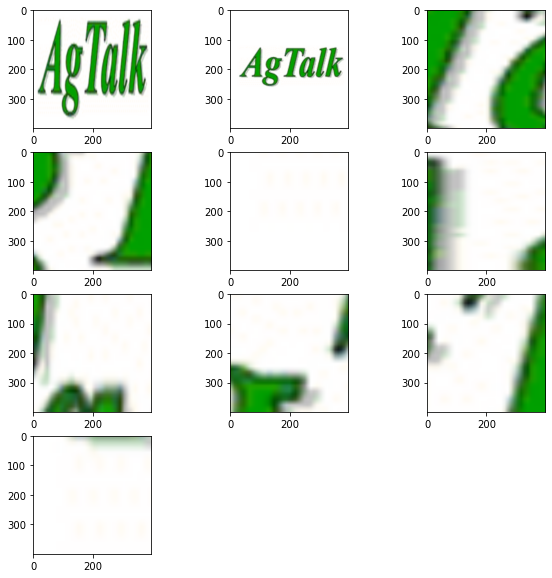

2


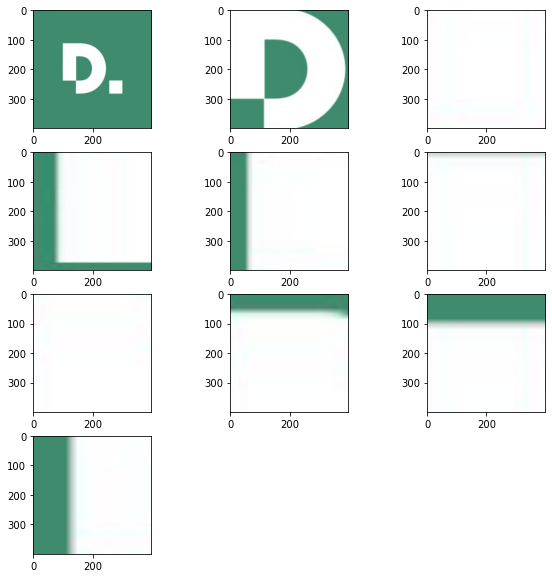

3


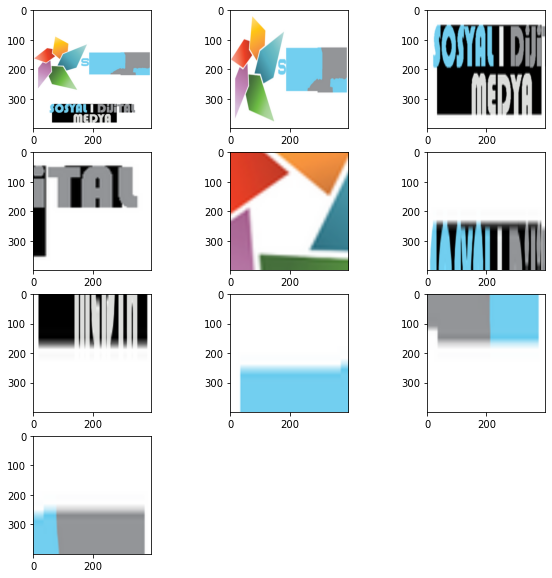

4


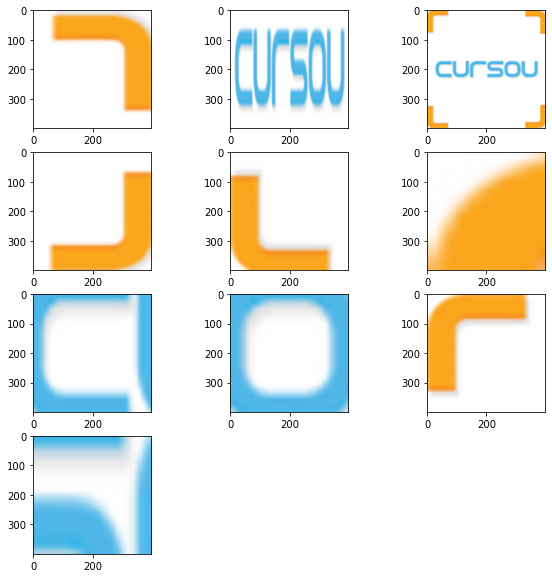

5


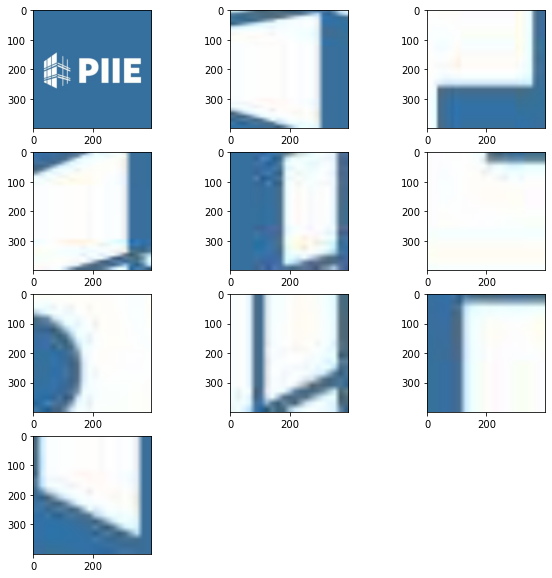

6


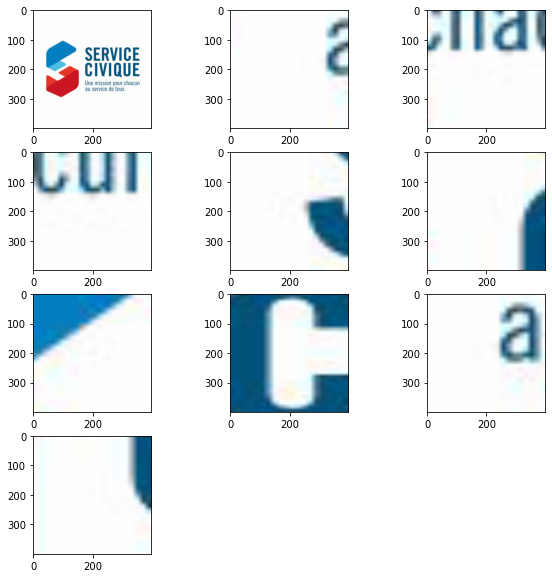

7


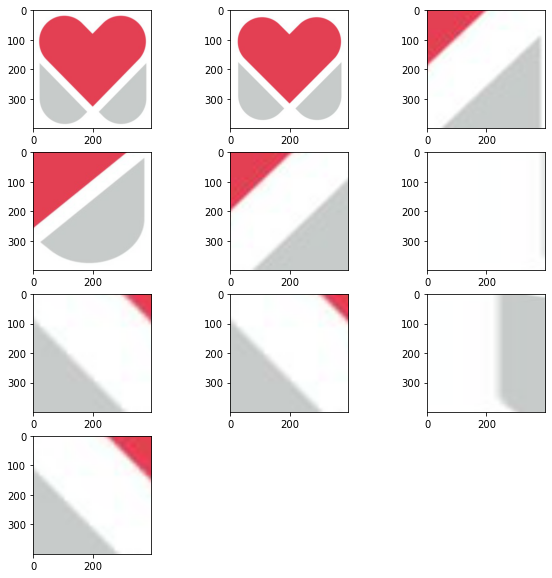

8


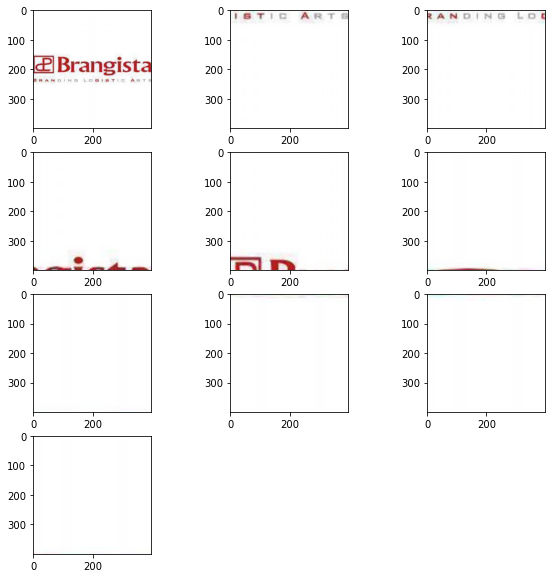

9


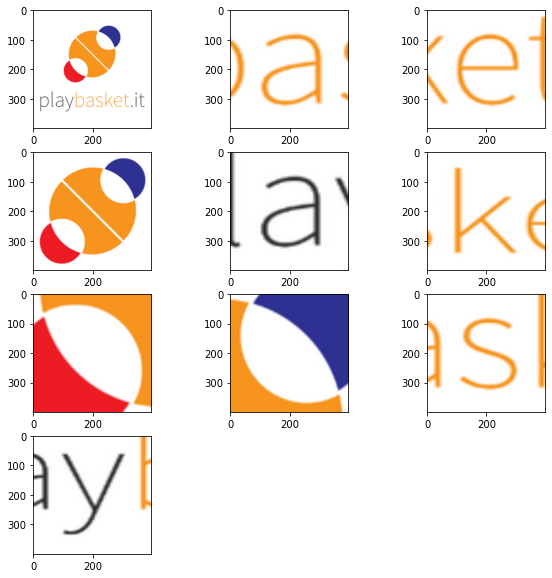

10


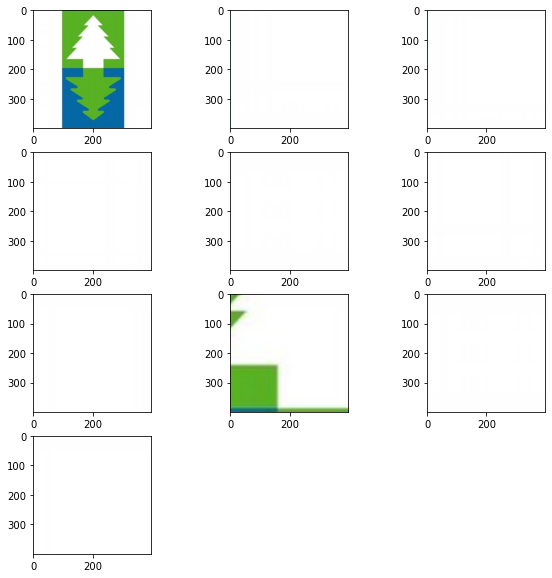

11


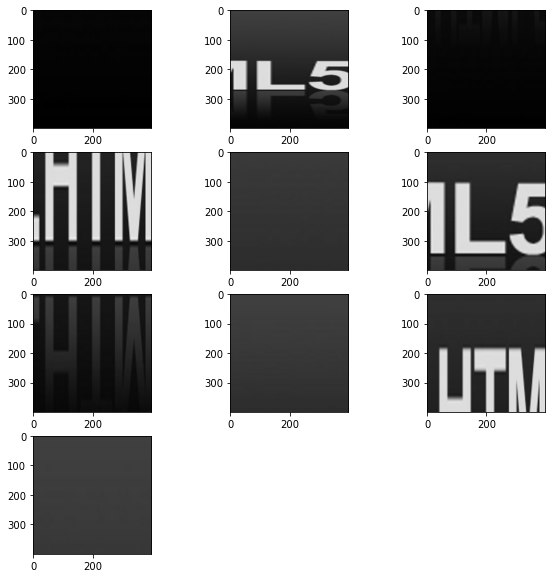

12


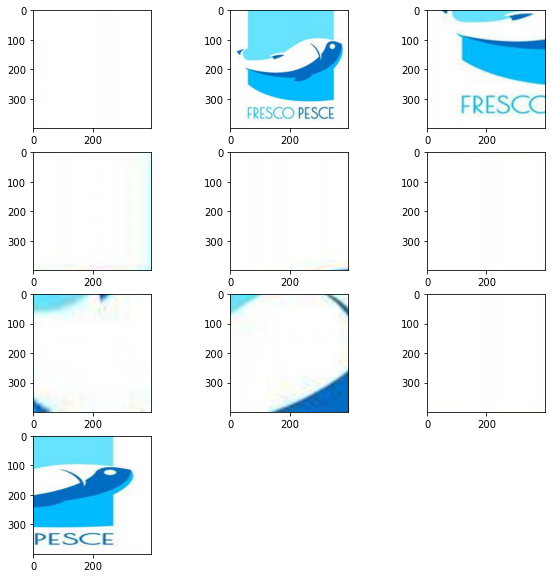

13


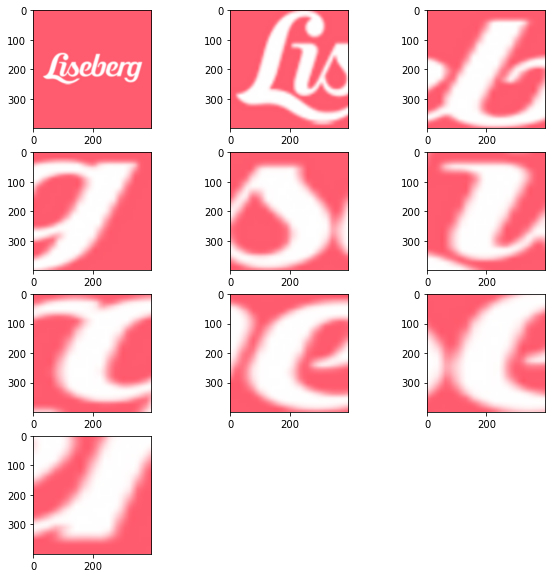

14


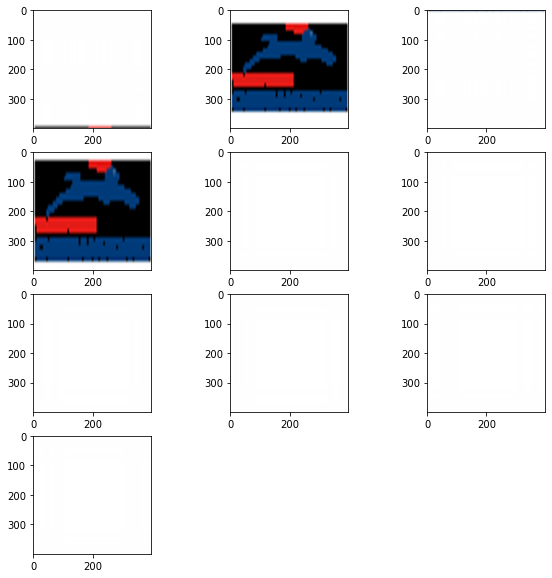

15


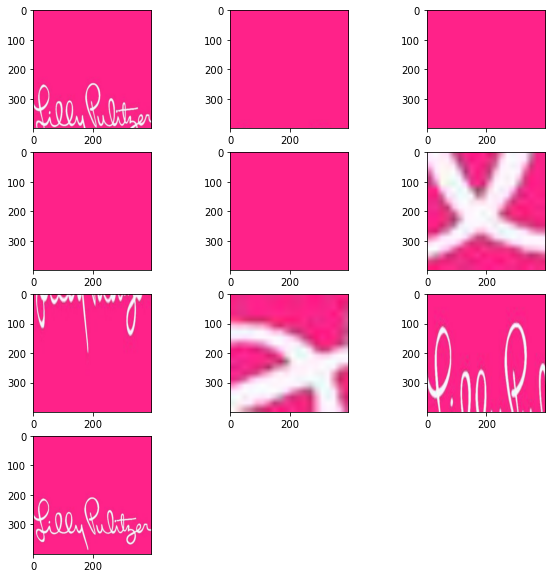

16


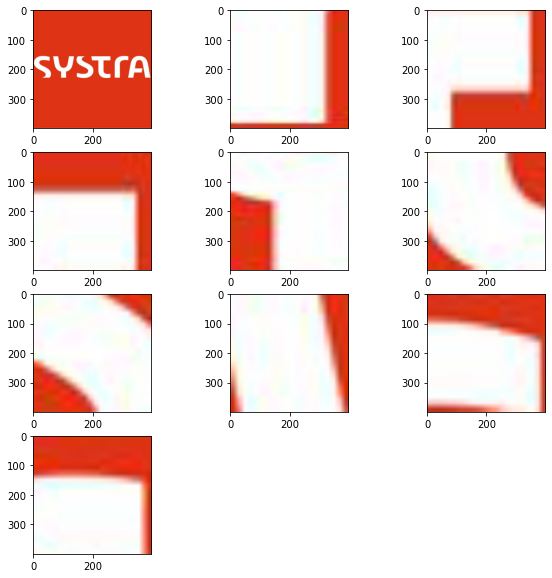

17


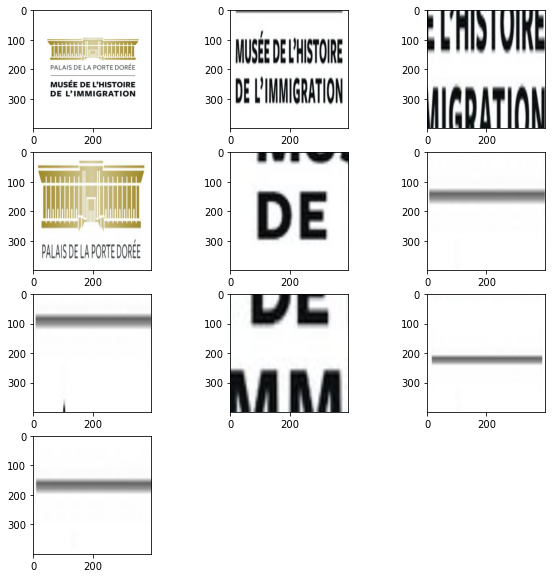

18


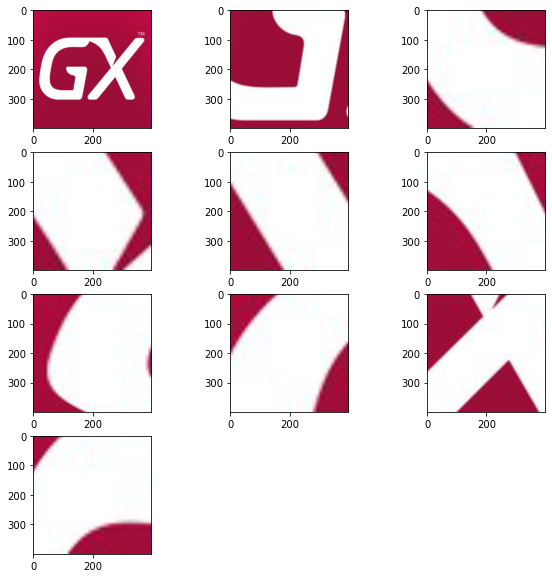

19


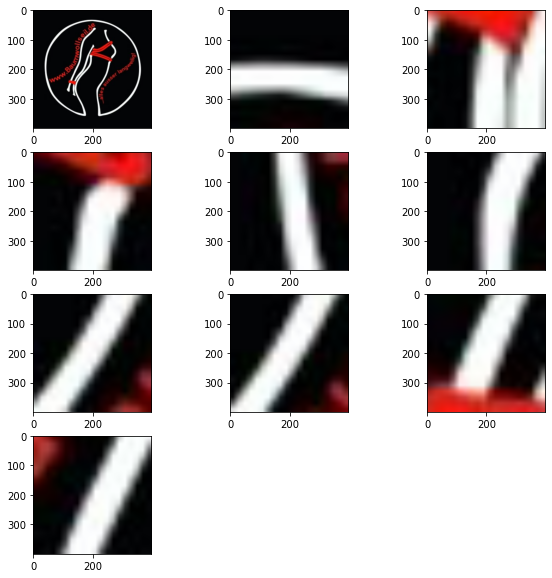

20


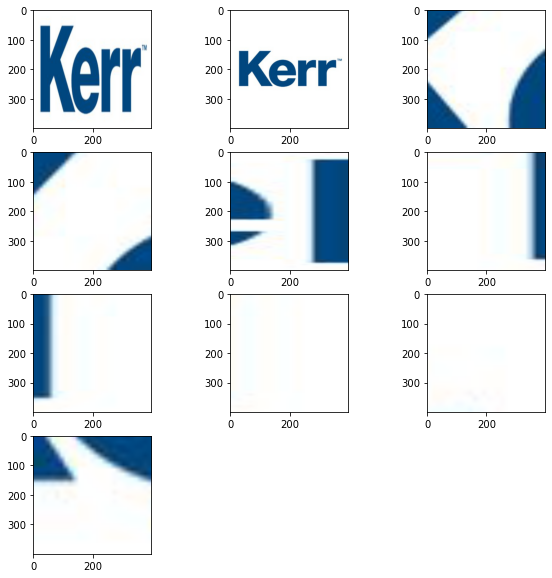

21


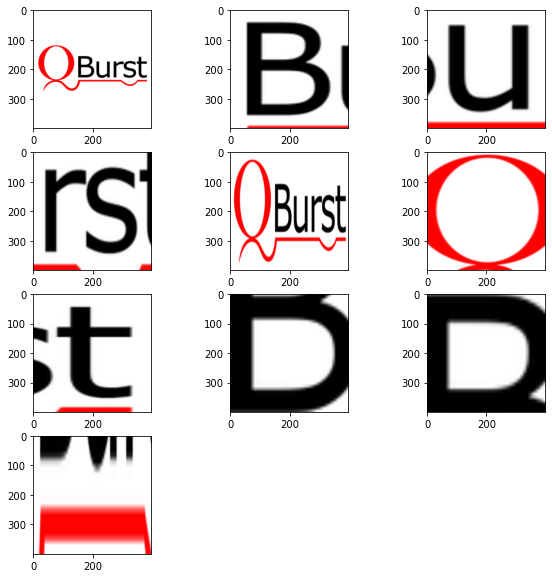

22


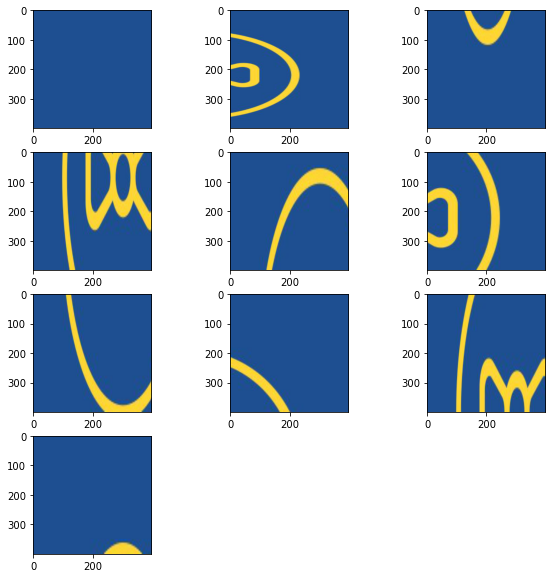

23


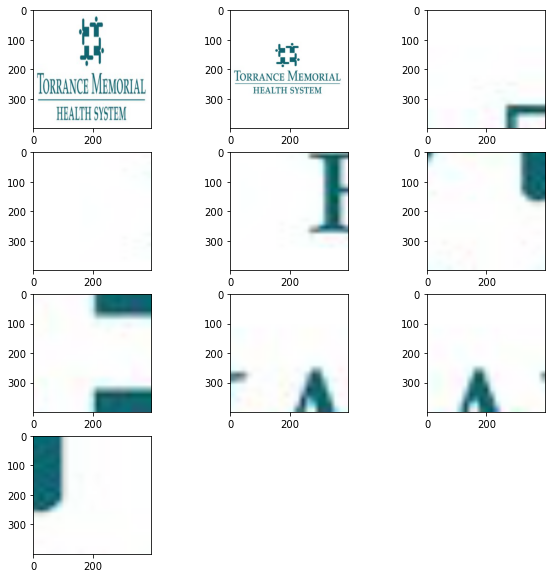

24


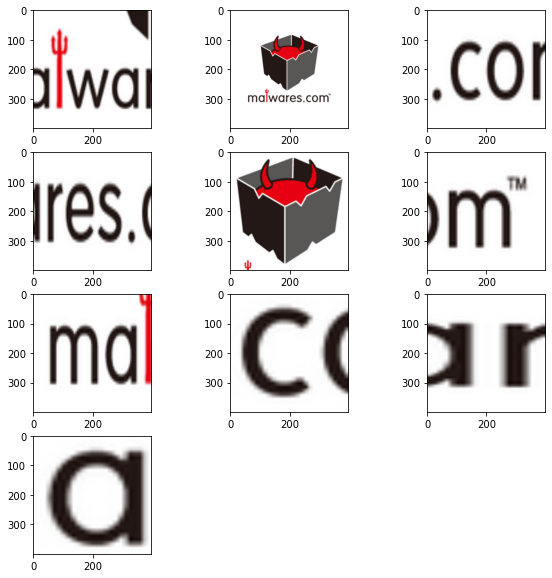

25


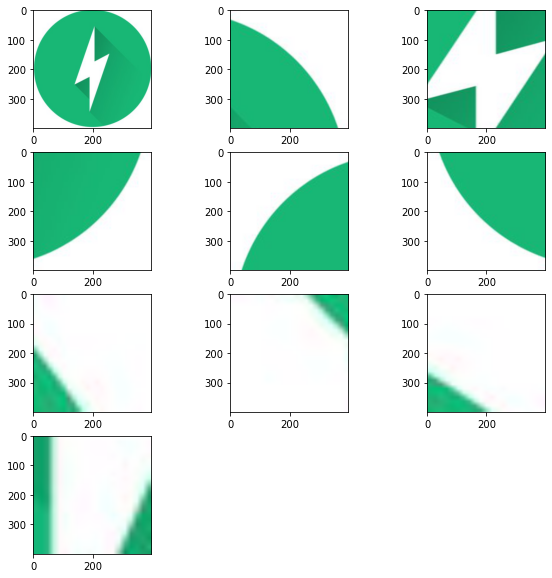

26


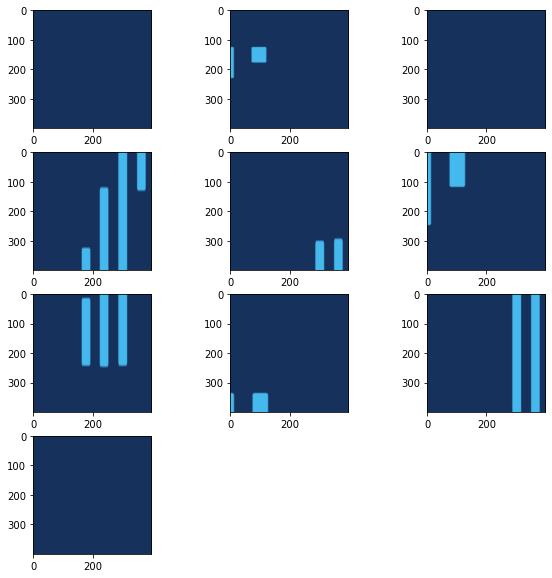

27


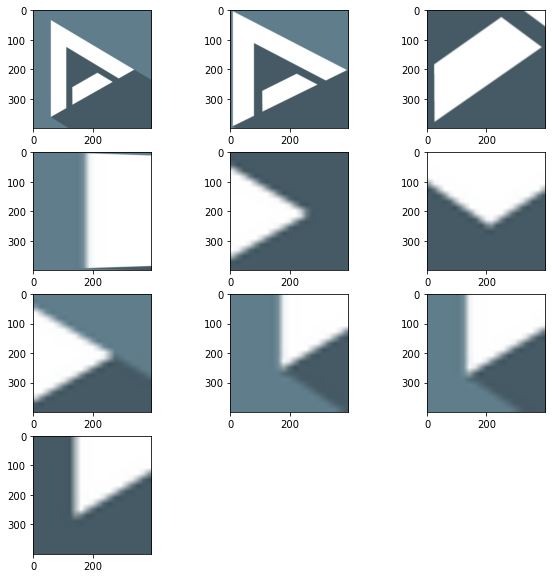

28


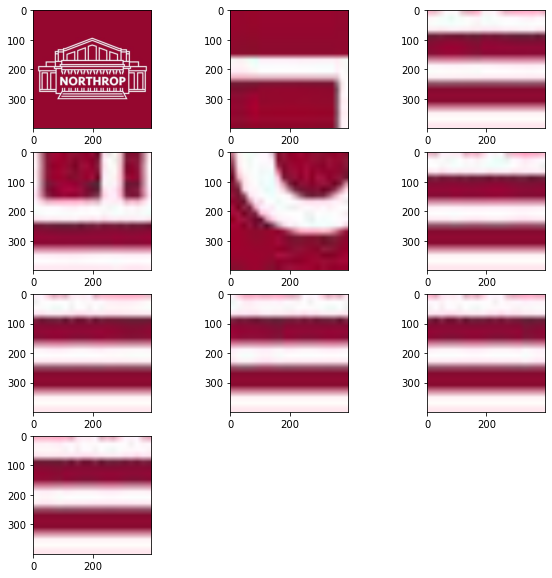

29


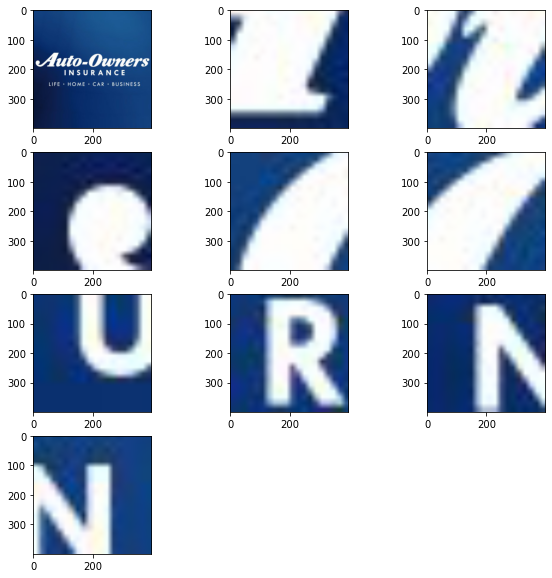

30


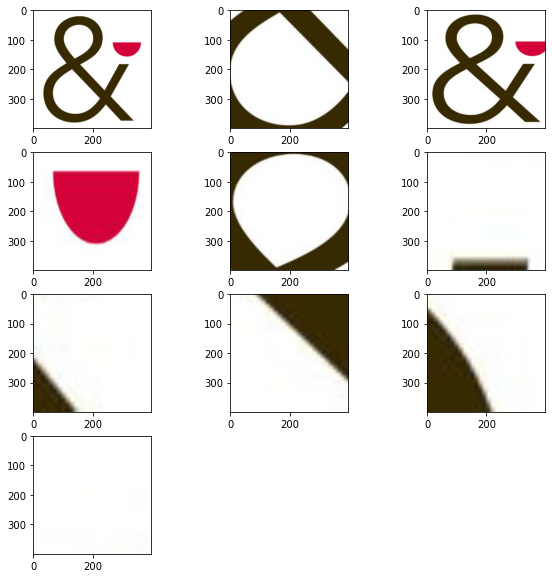

31


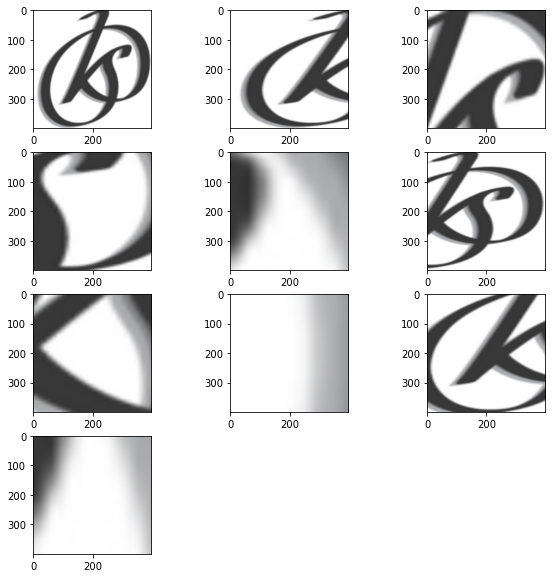

32


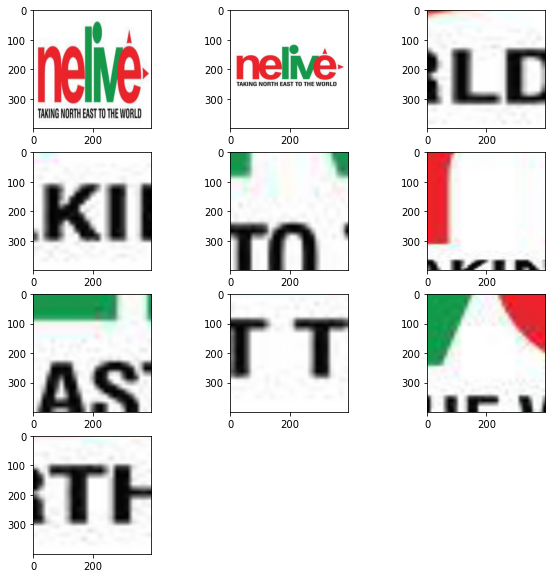

33


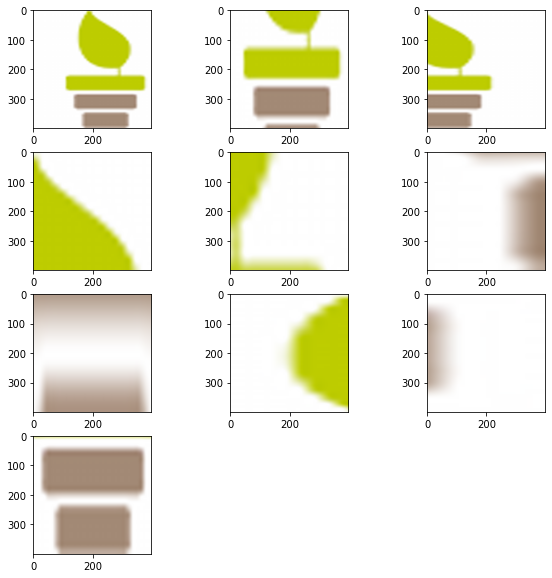

34


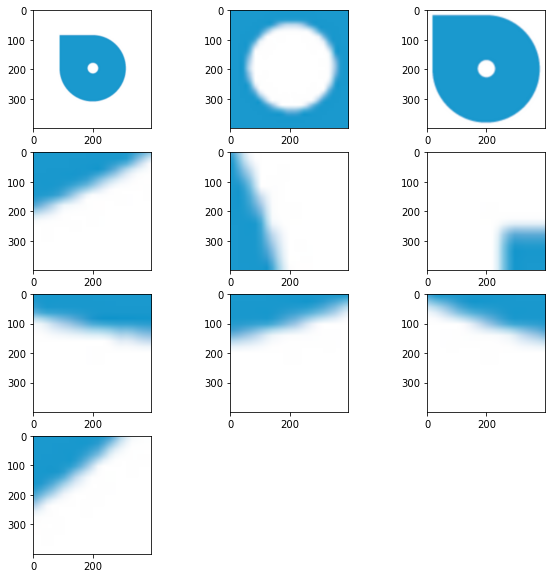

35


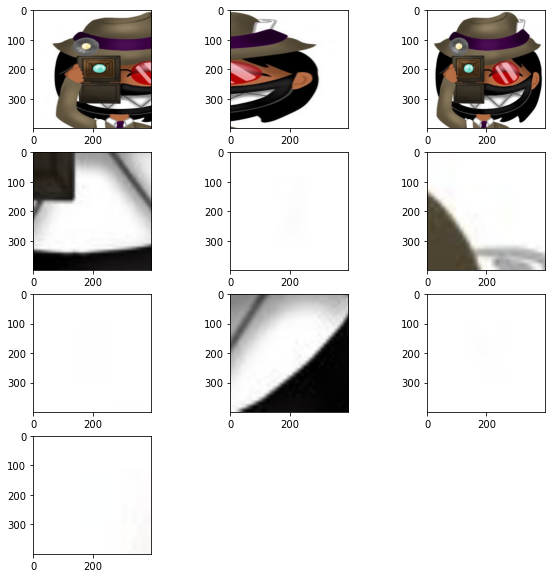

36


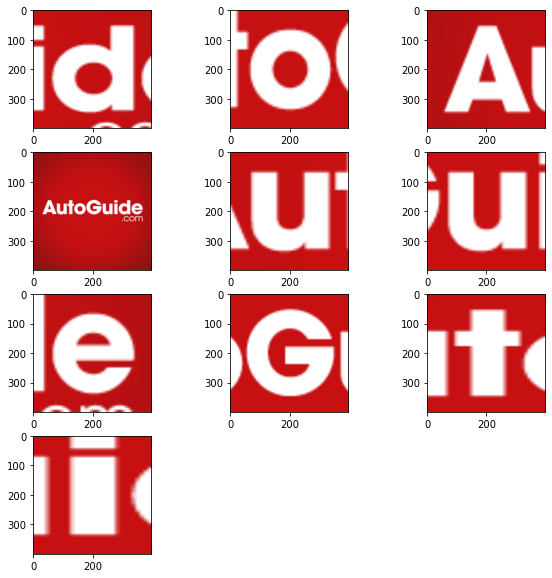

37


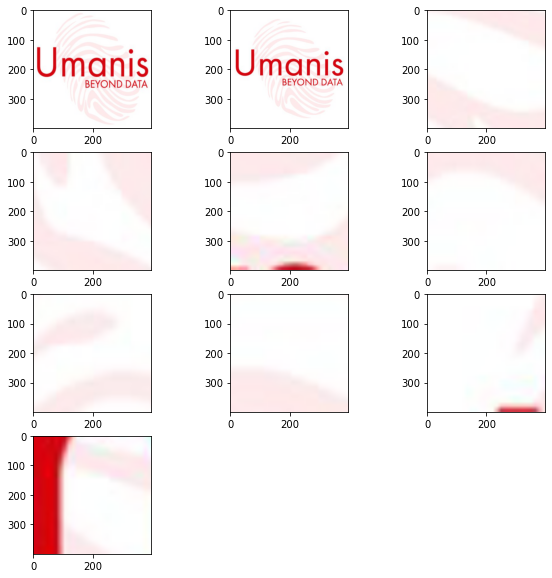

38


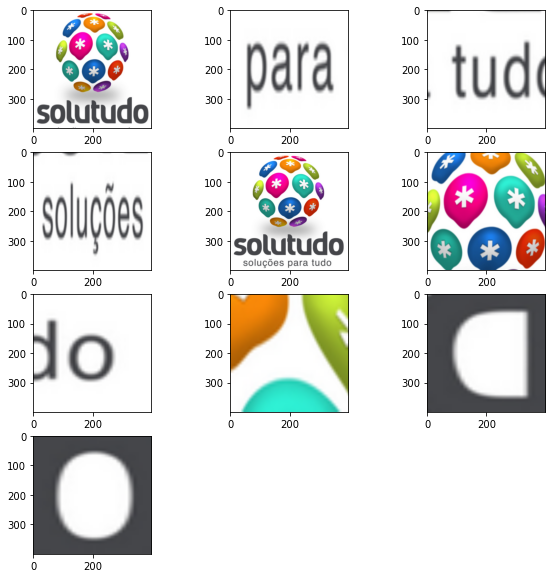

39


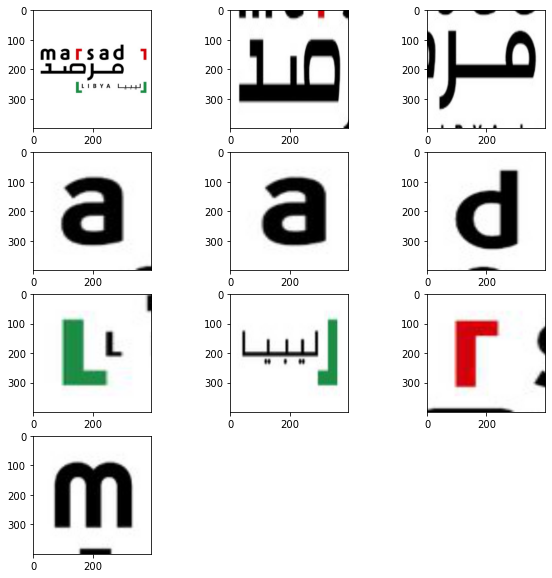

40


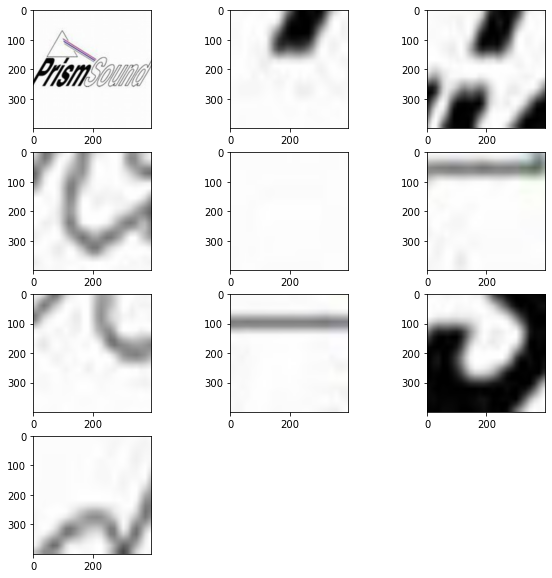

41


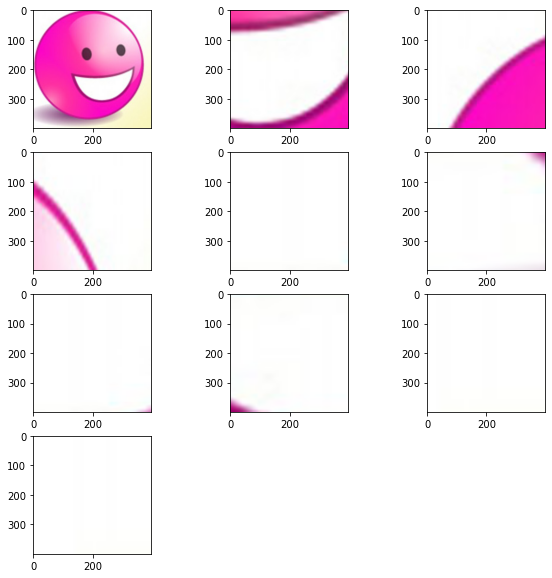

42


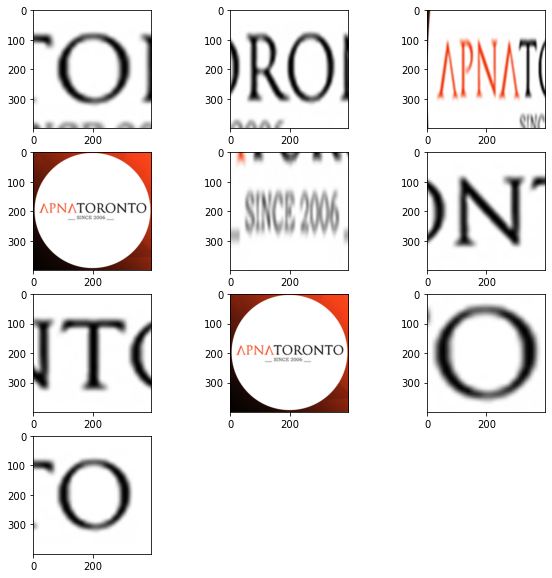

43


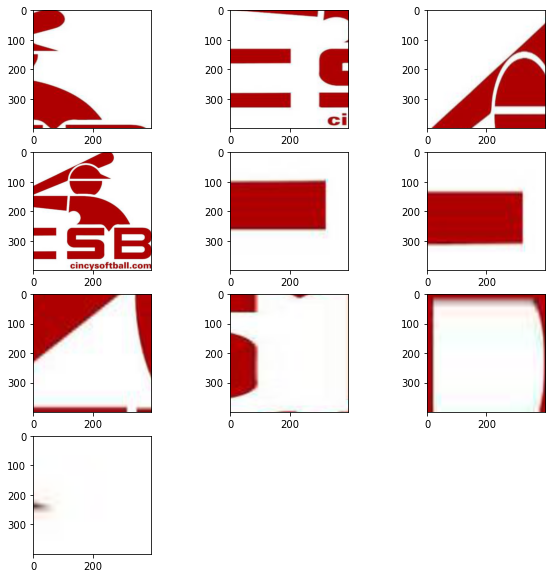

44


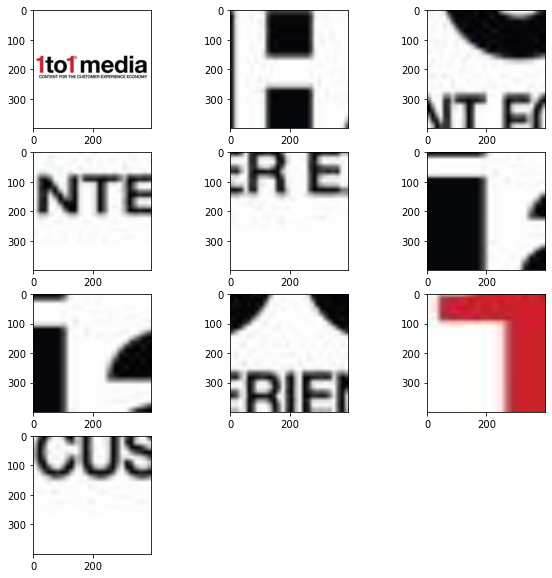

45


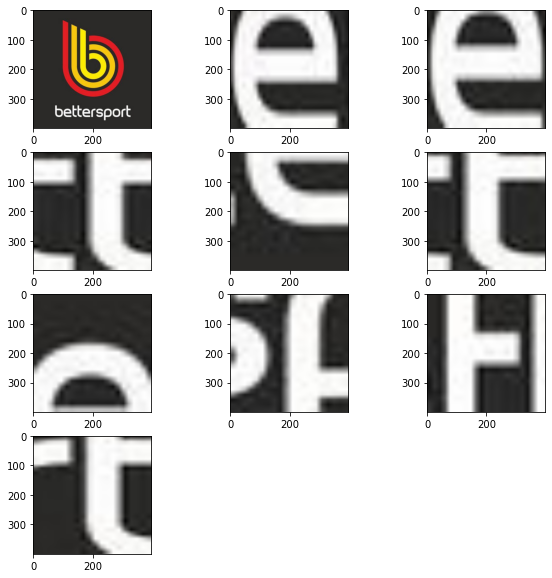

46


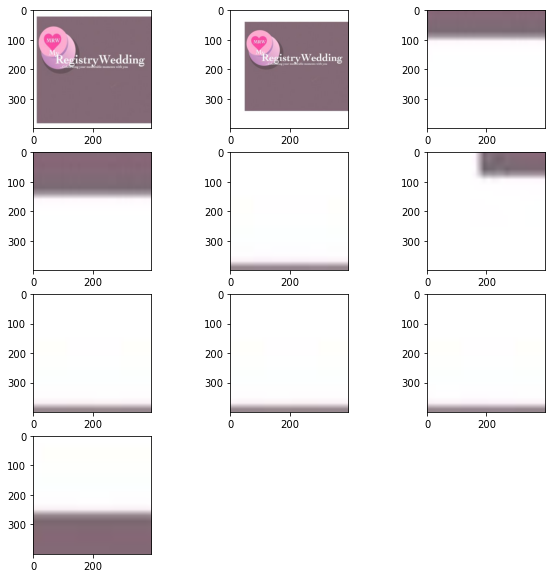

47


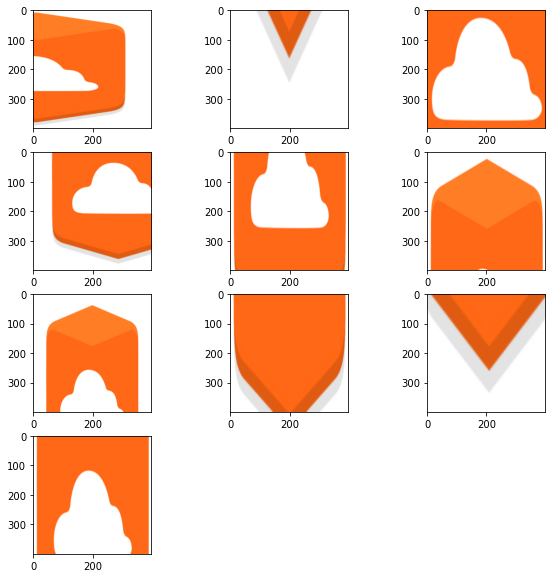

48


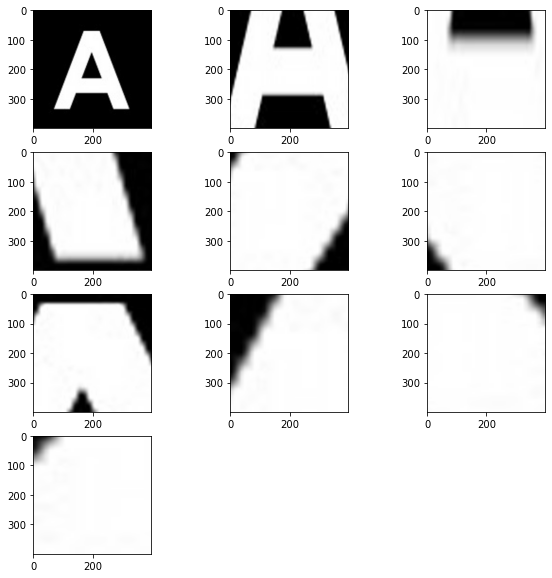

49


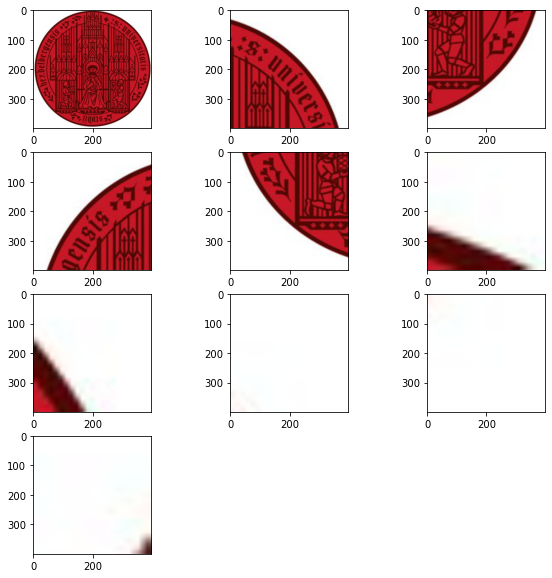

50


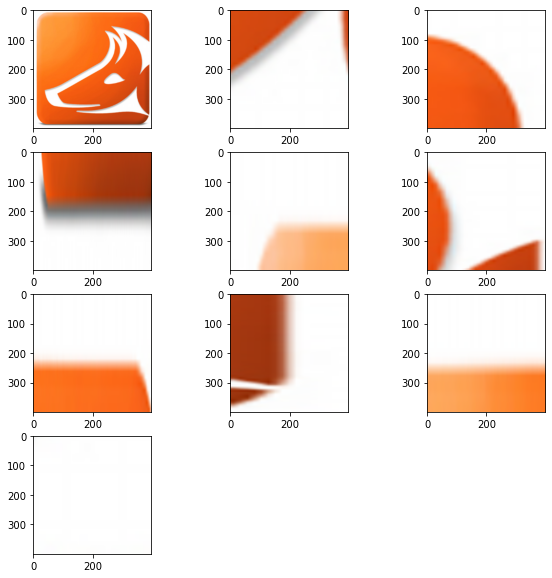

51


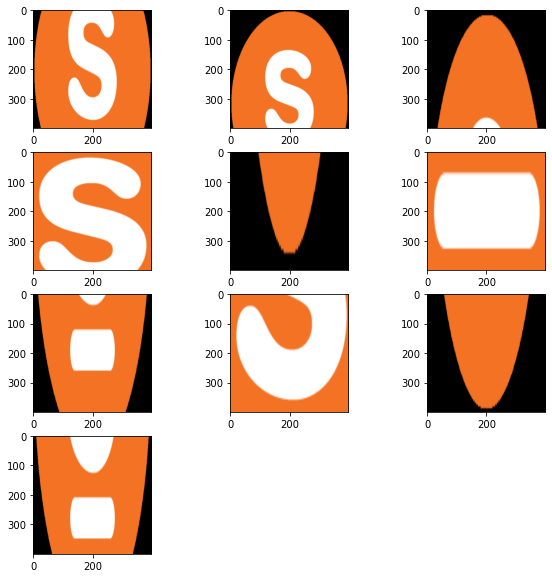

52


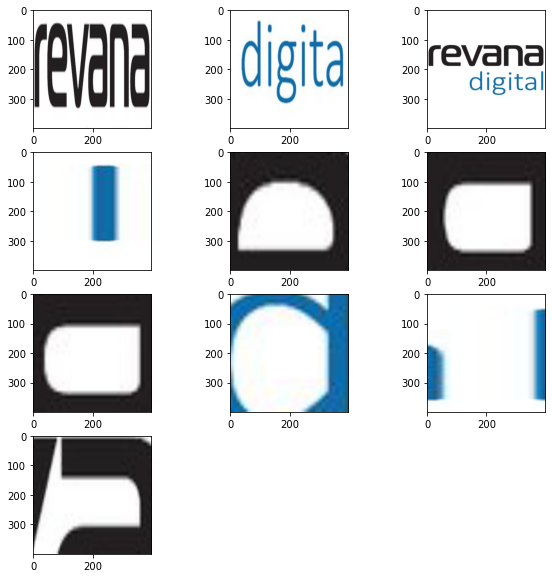

53


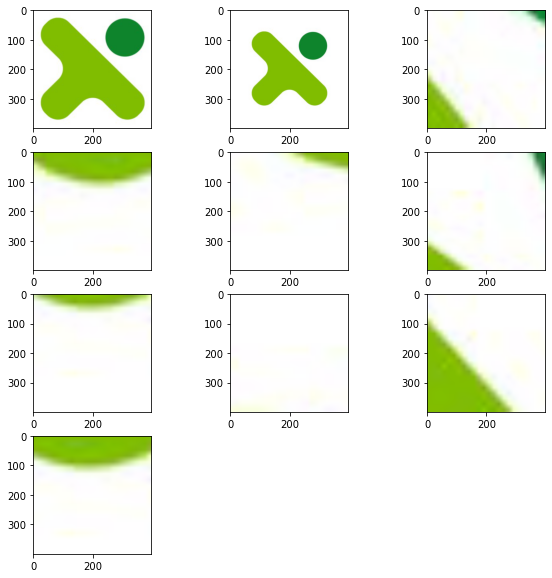

54


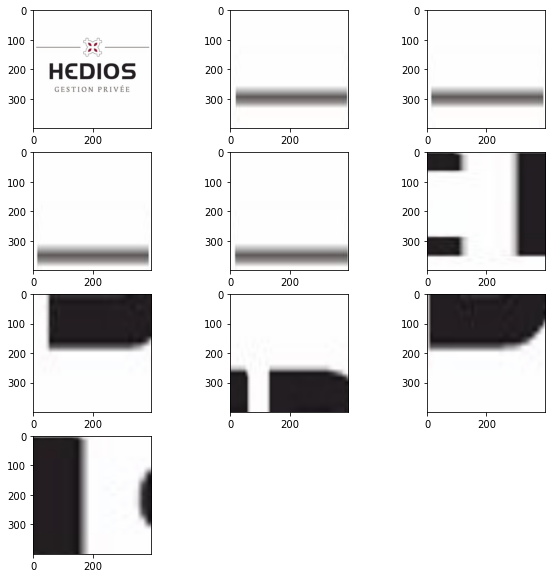

55


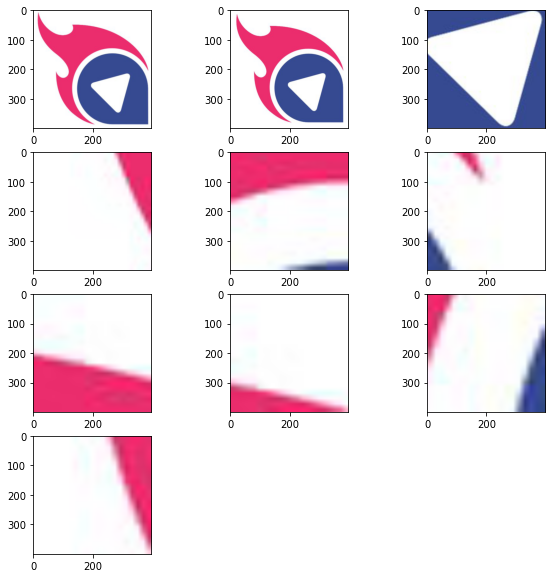

56


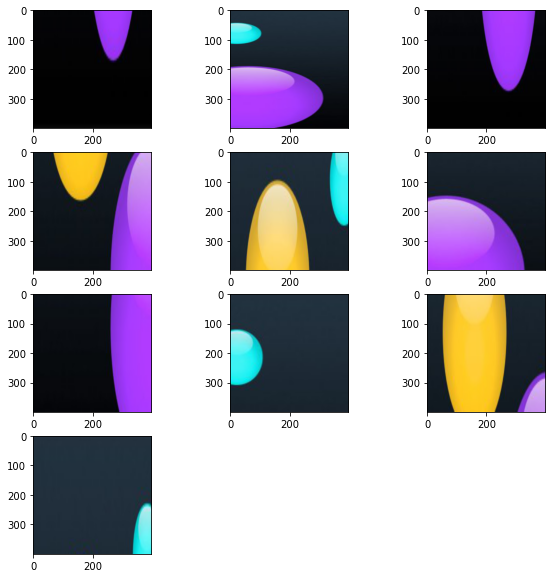

57


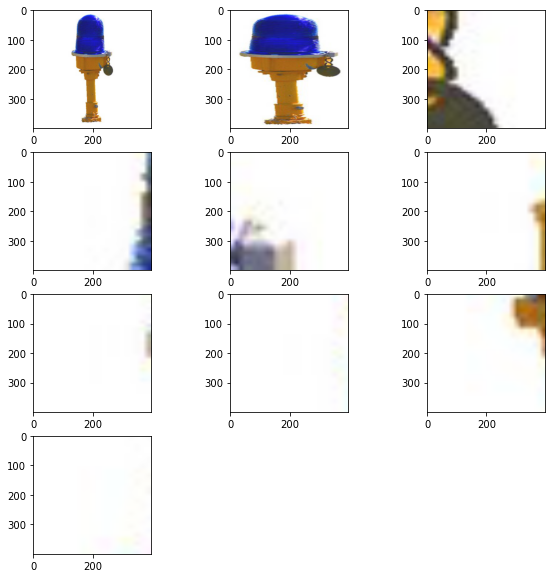

58


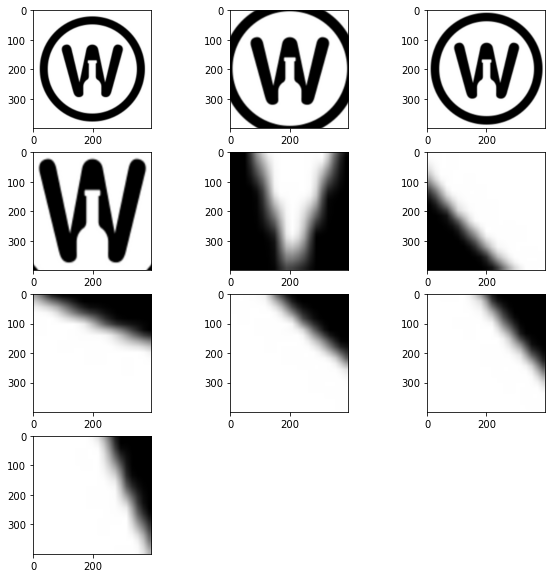

59


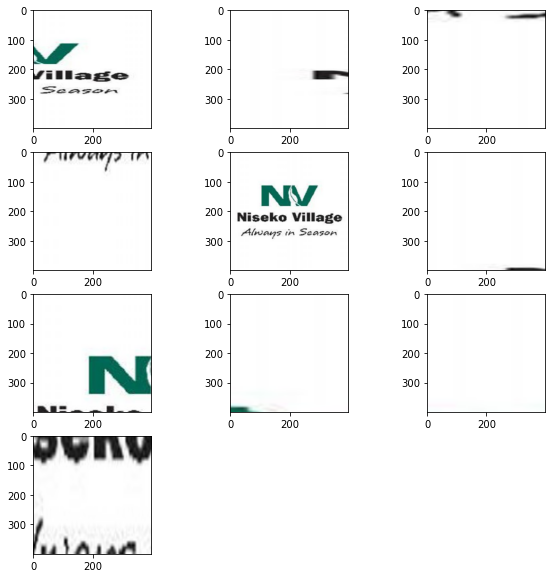

60


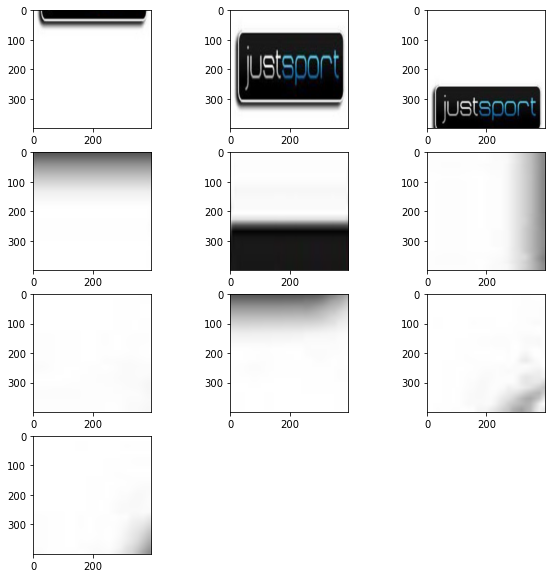

61


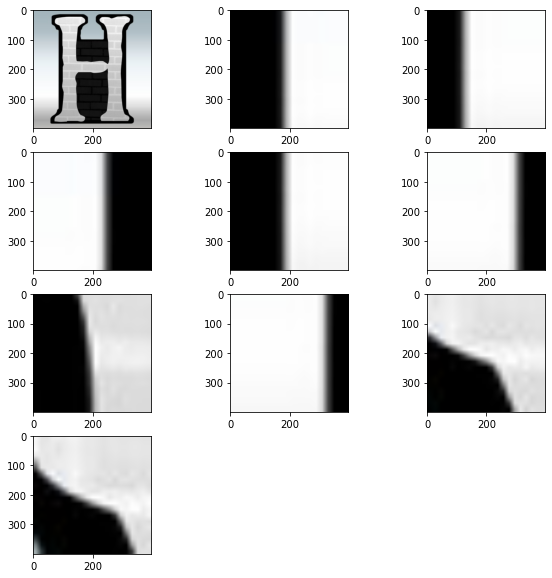

62


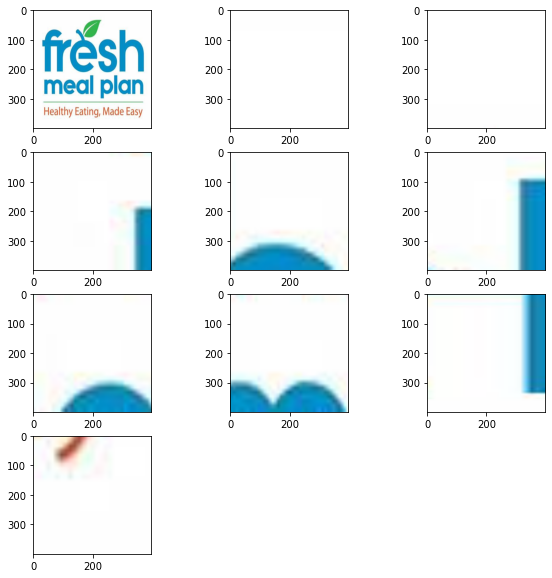

63


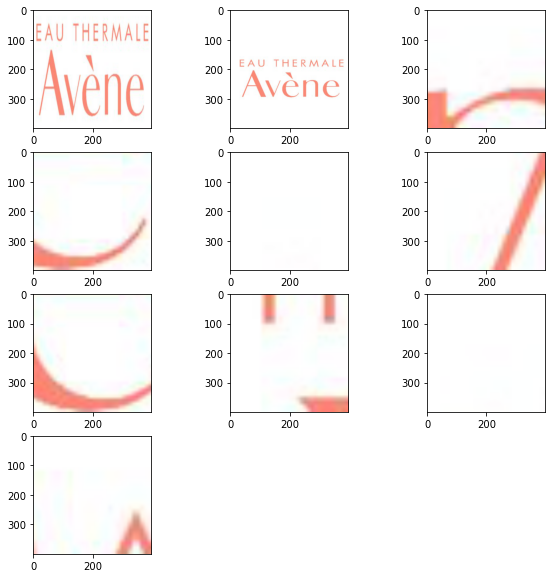

64


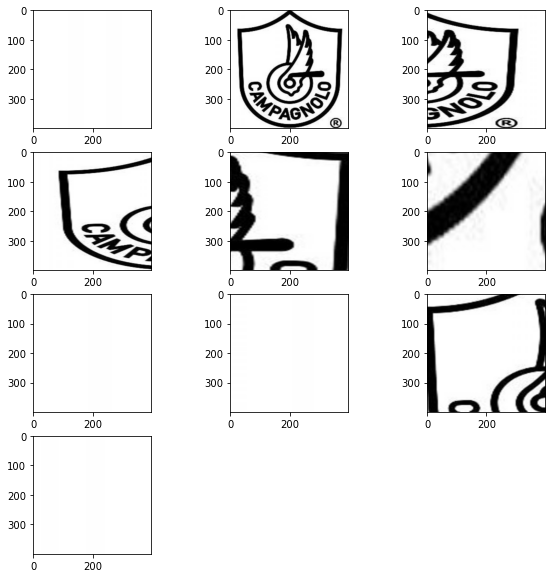

65


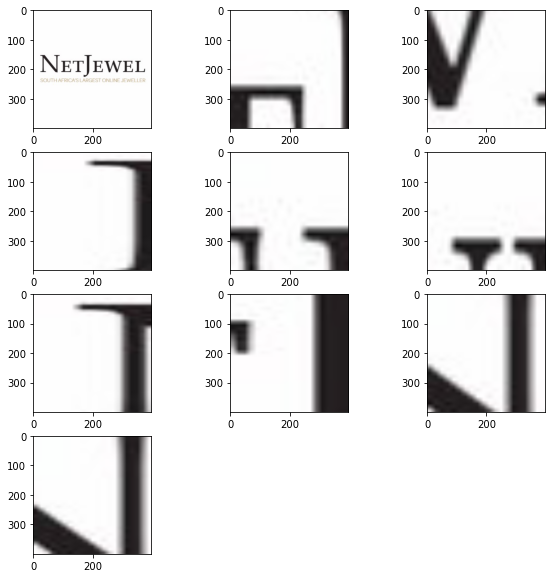

66


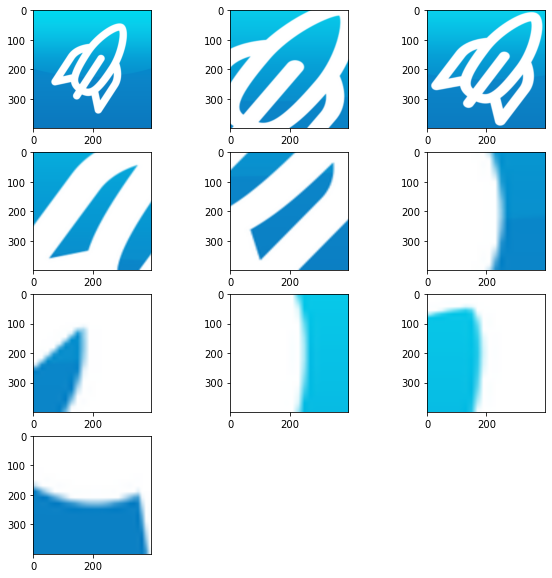

67


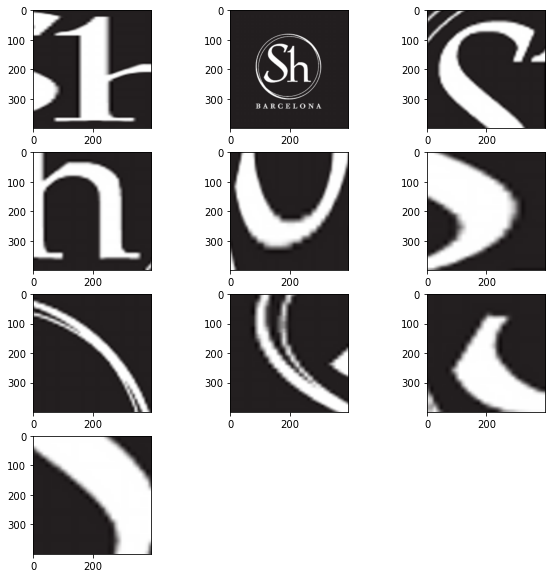

68


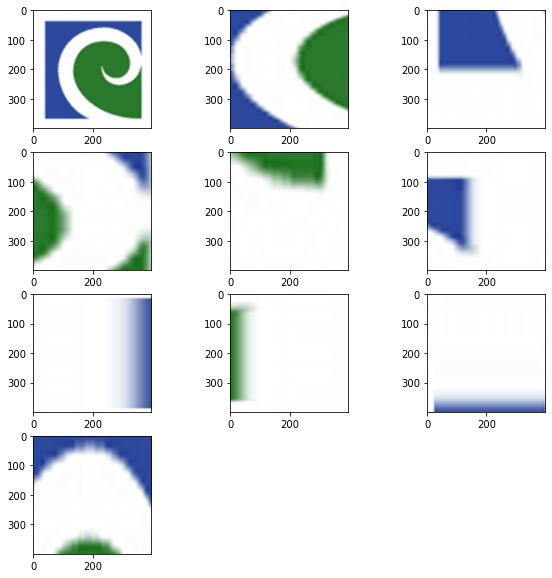

69


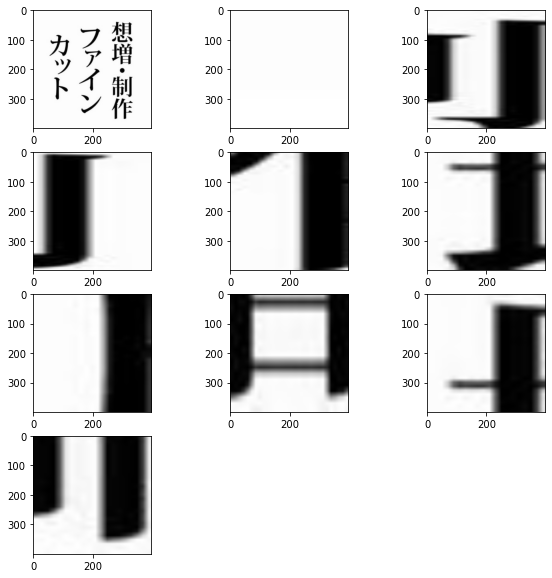

70


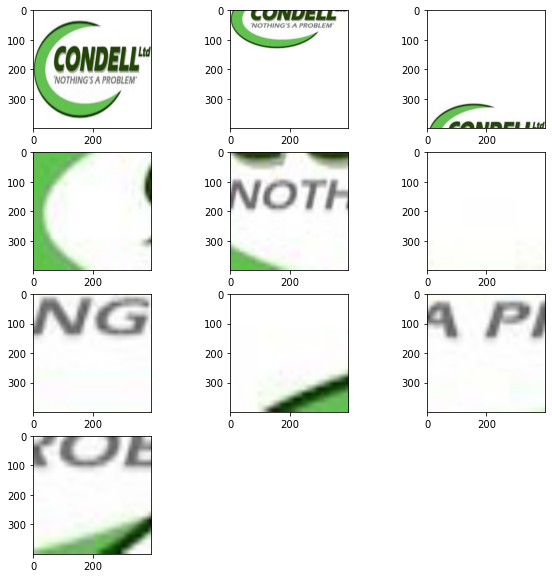

71


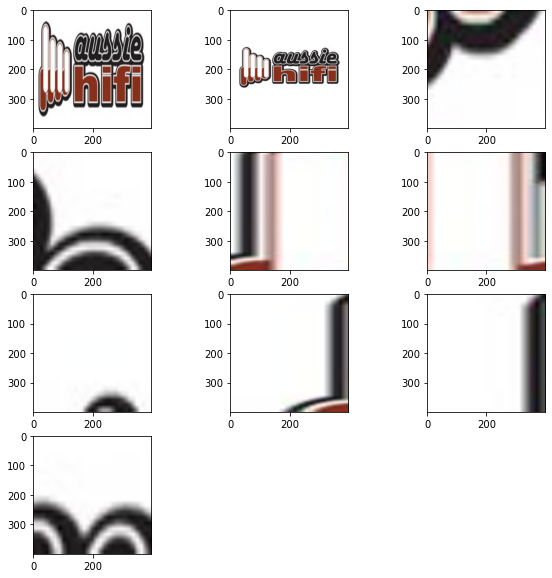

72


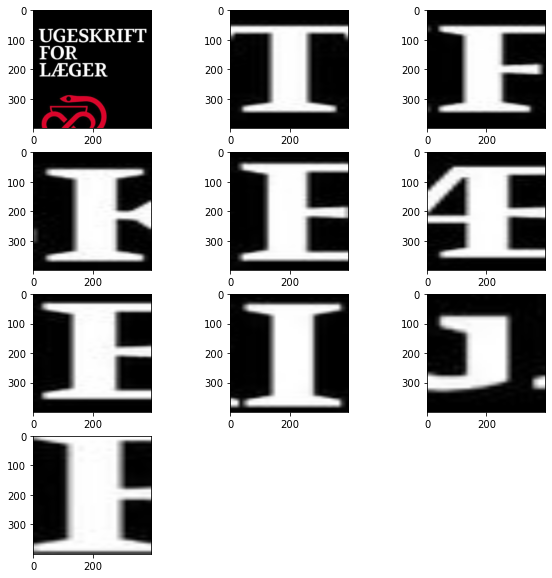

73


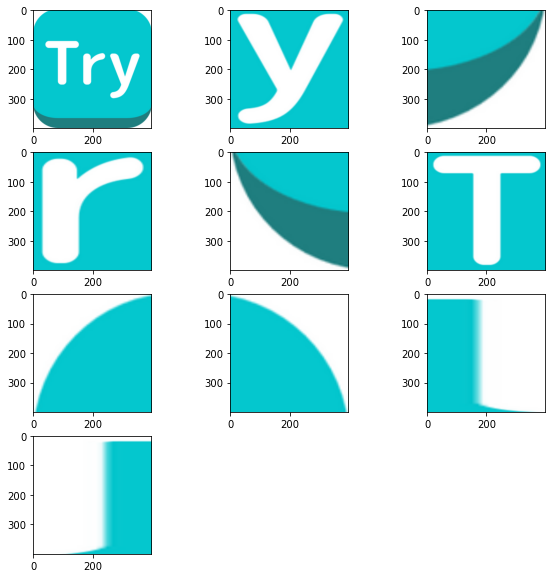

74


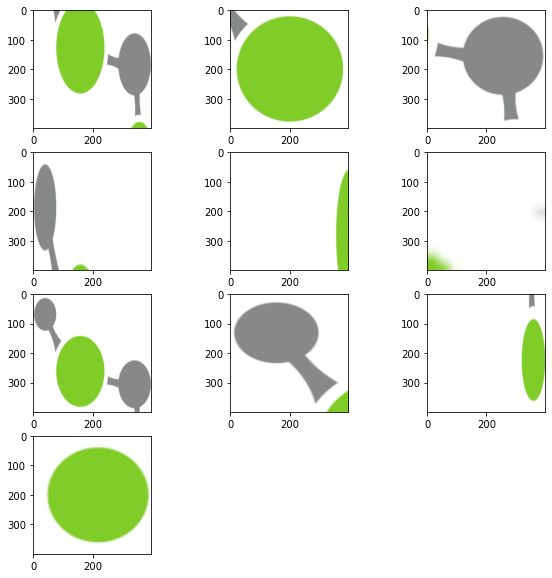

75


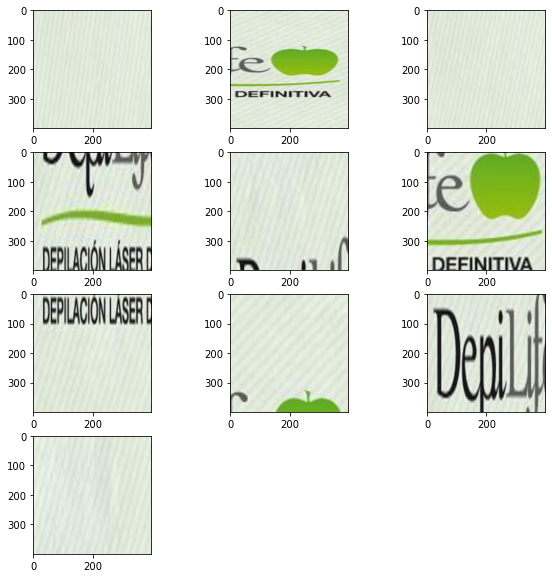

76


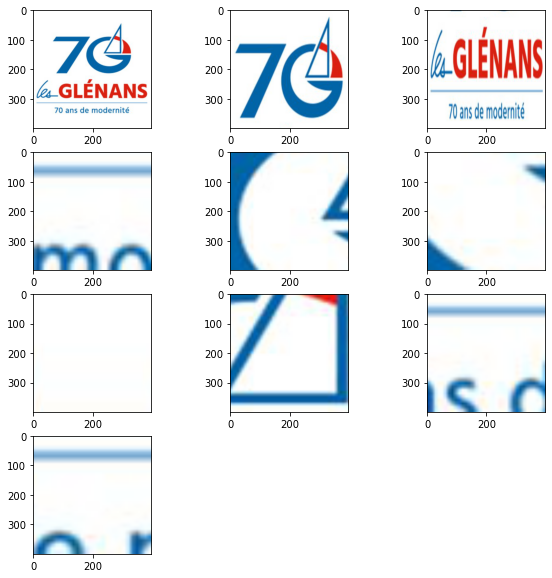

77


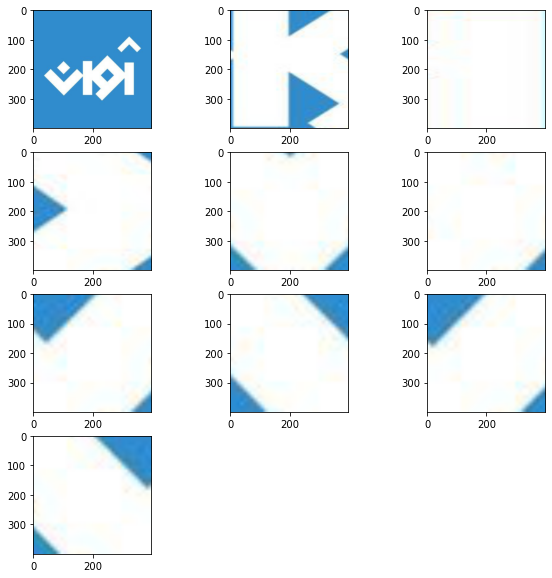

78


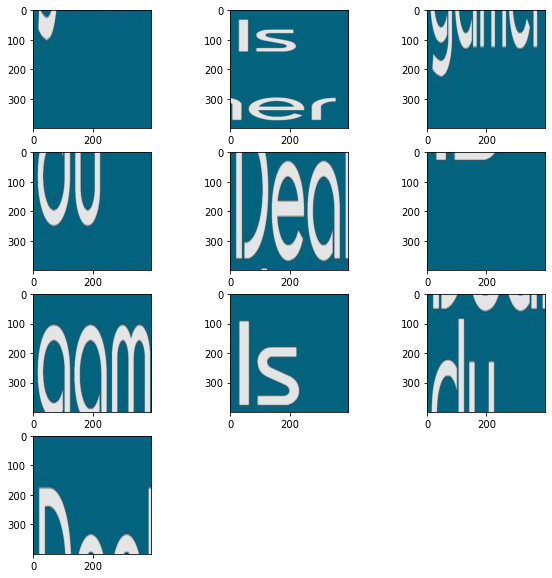

79


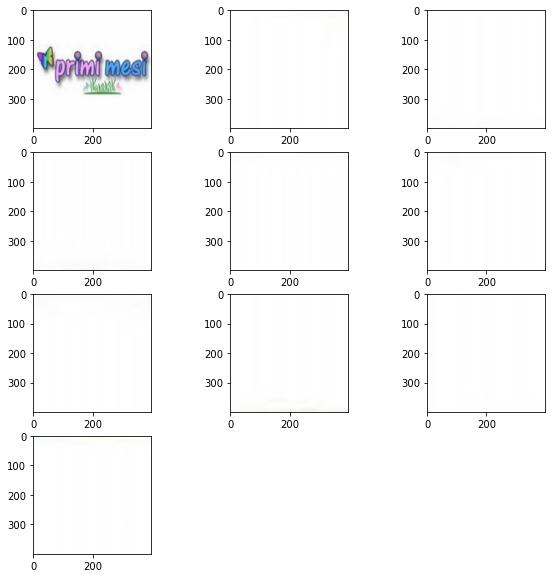

80


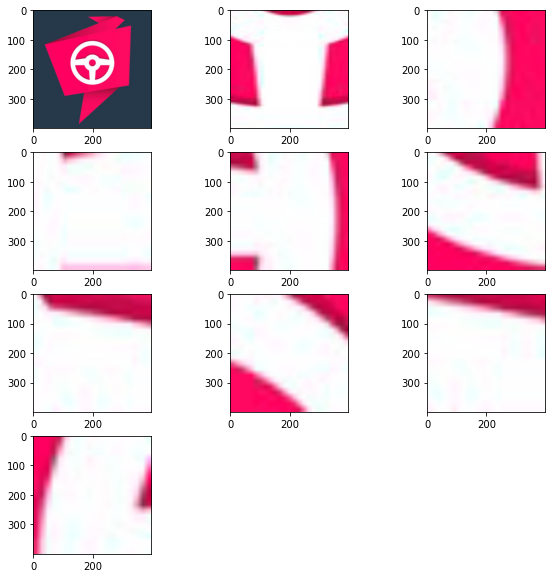

81


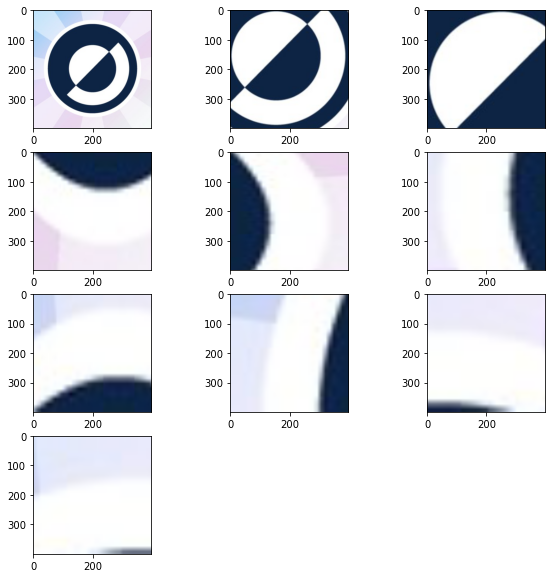

82


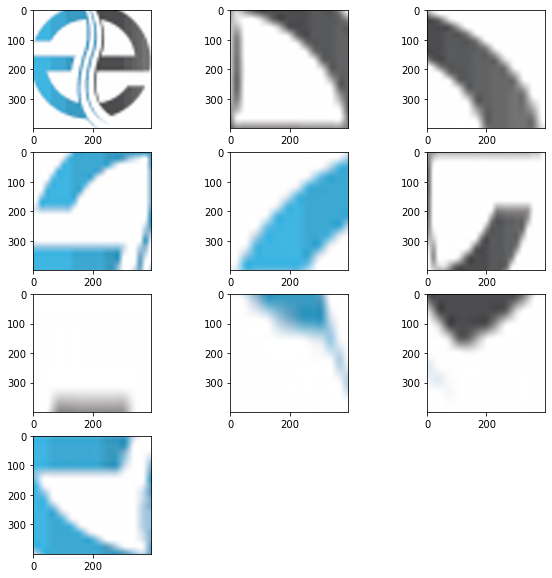

83


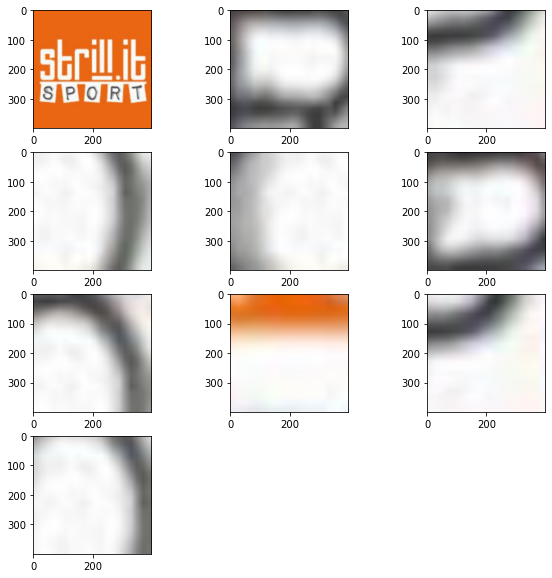

84


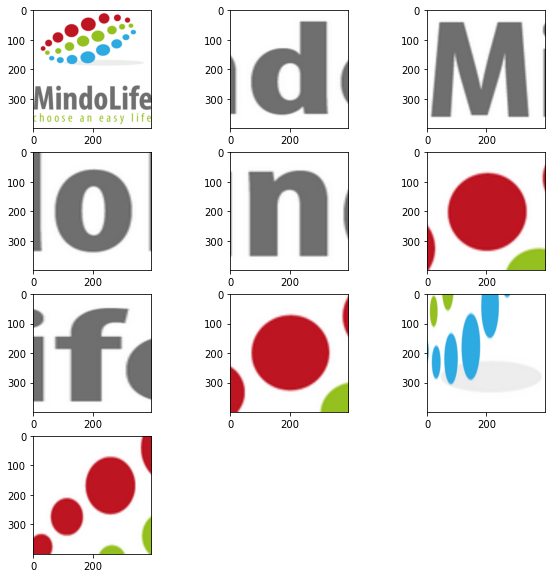

85


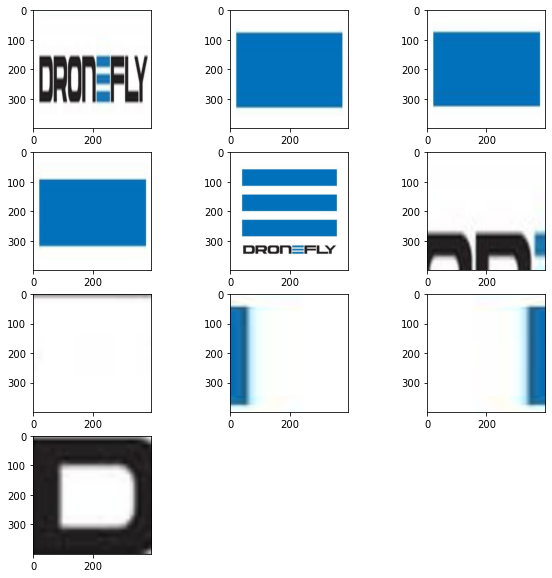

86


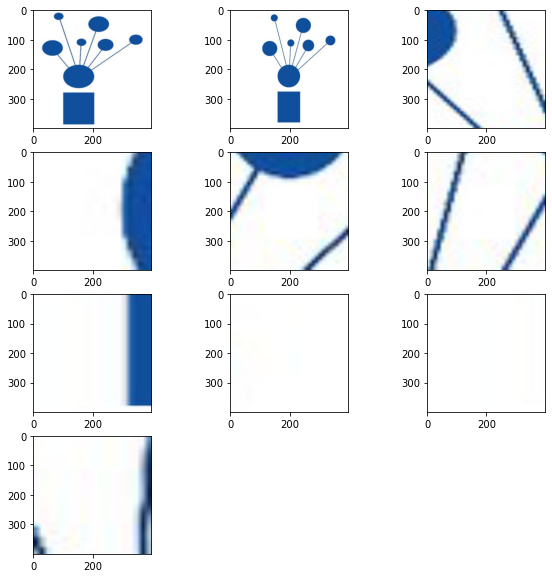

87


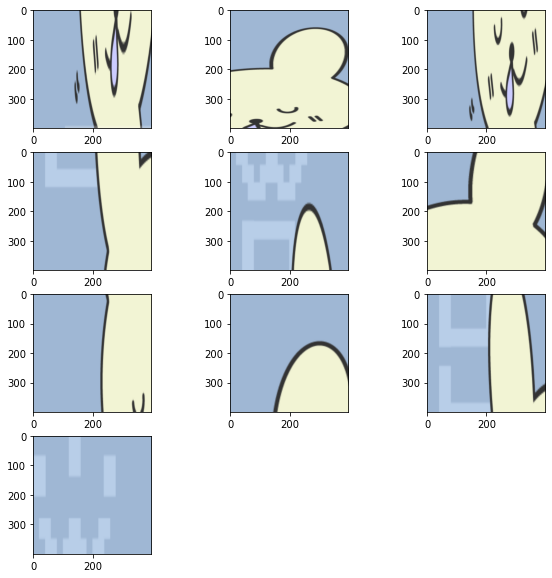

88


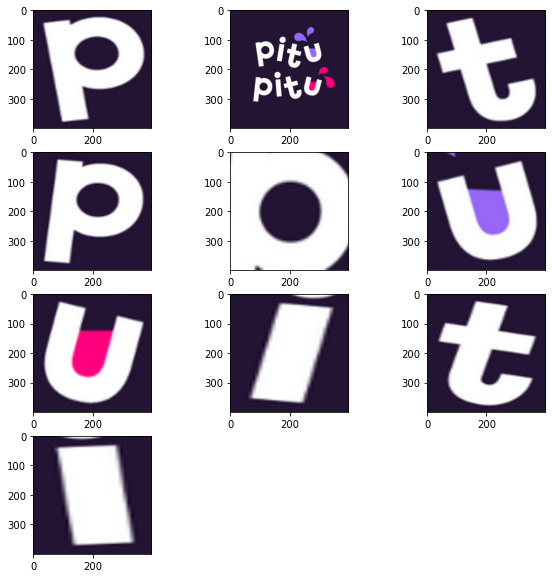

89


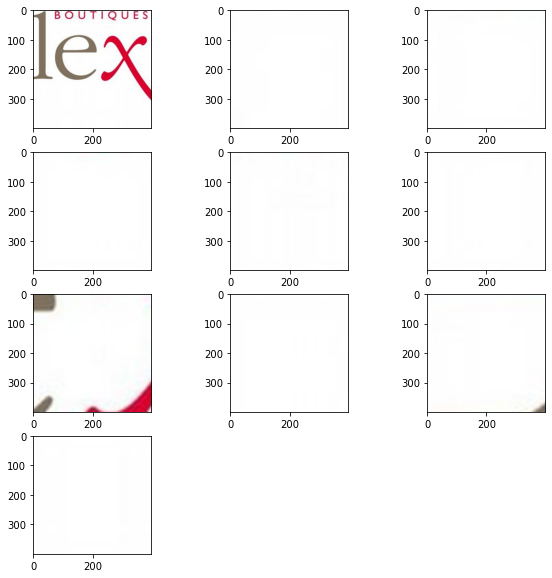

90


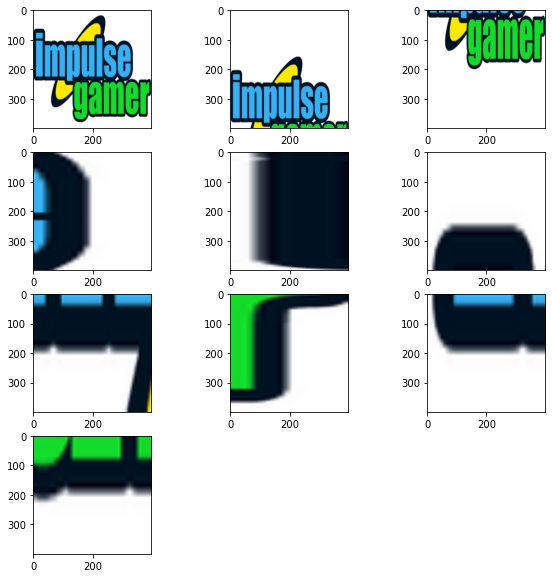

91


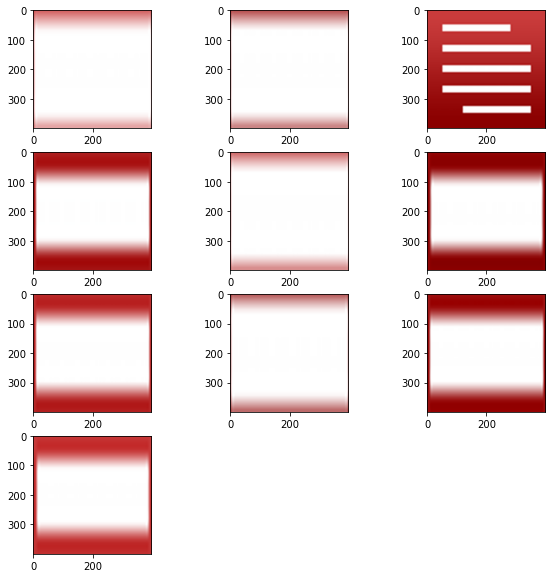

92


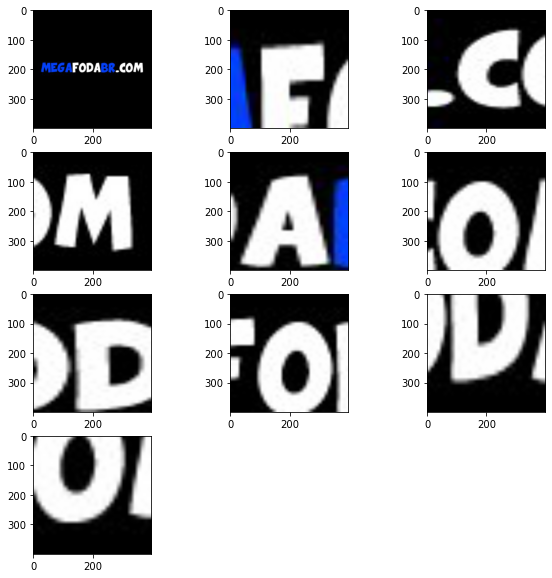

93


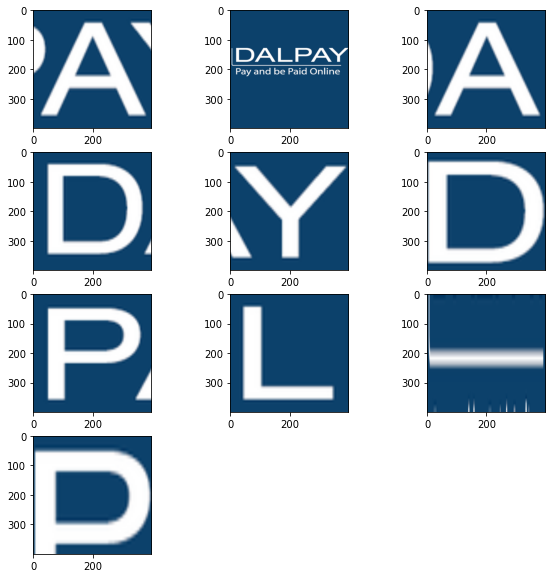

94


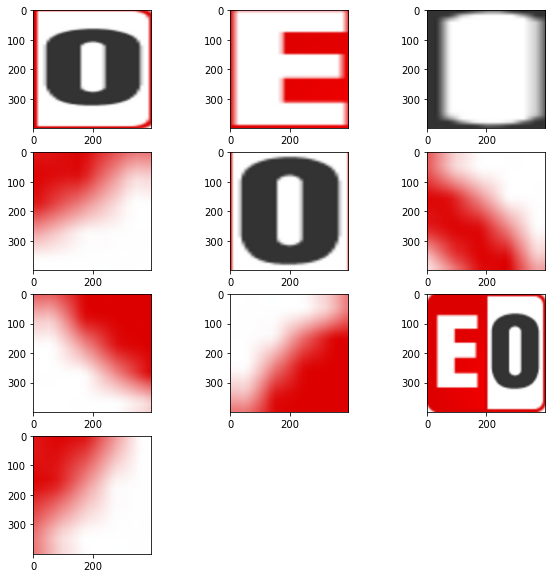

95


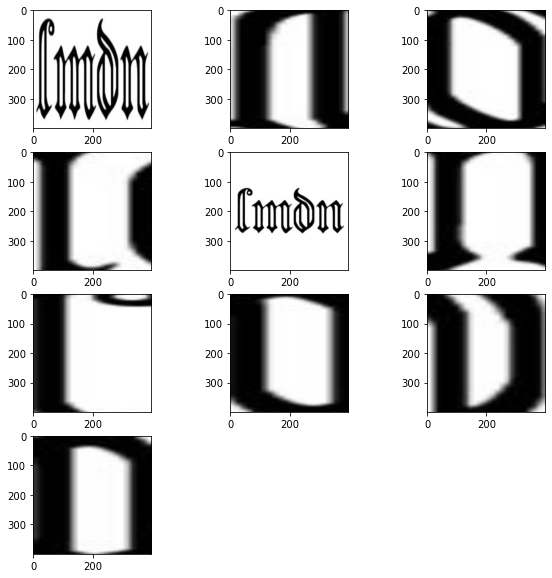

96


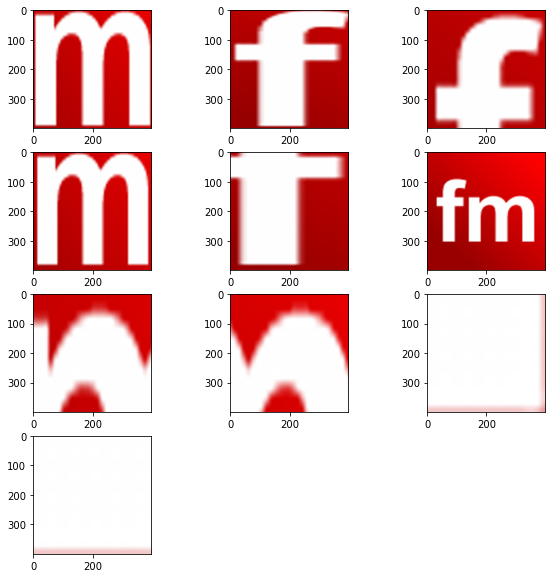

97


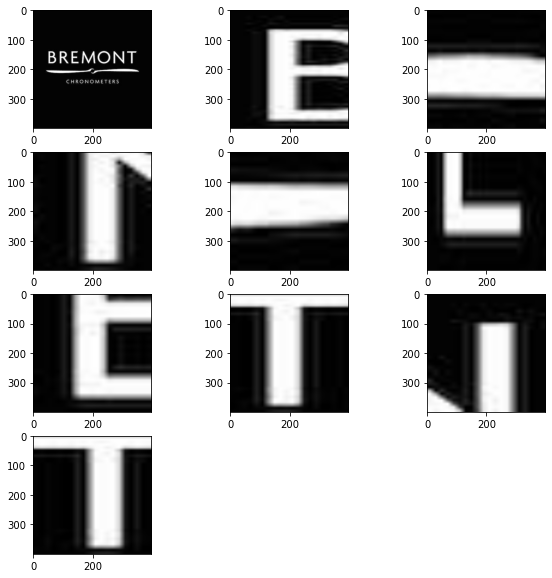

98


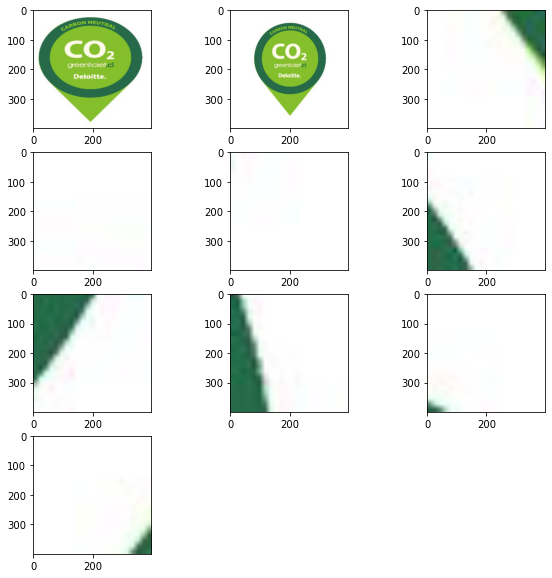

99


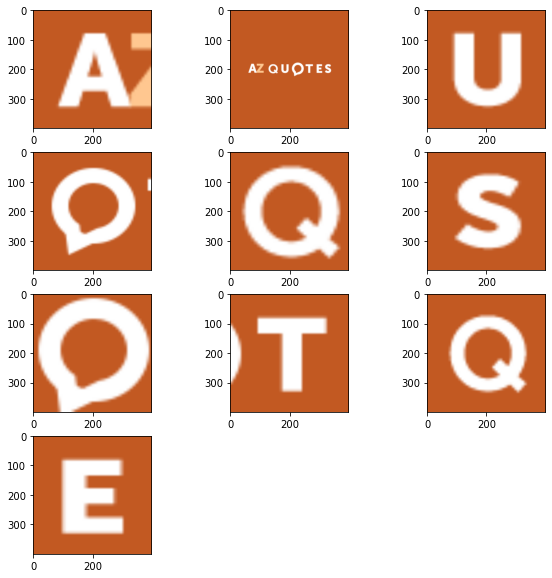

100


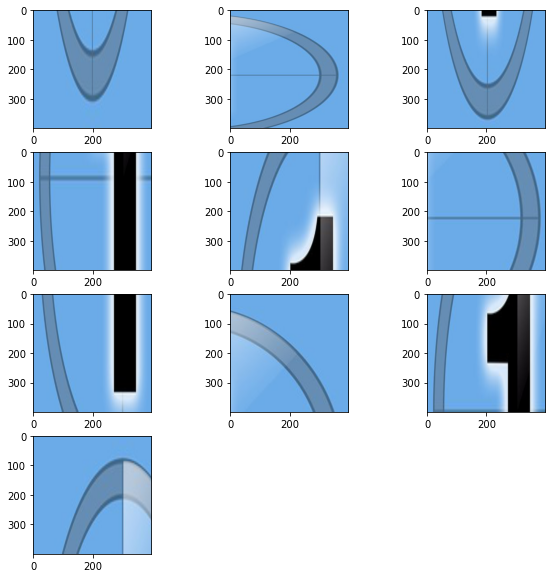

101


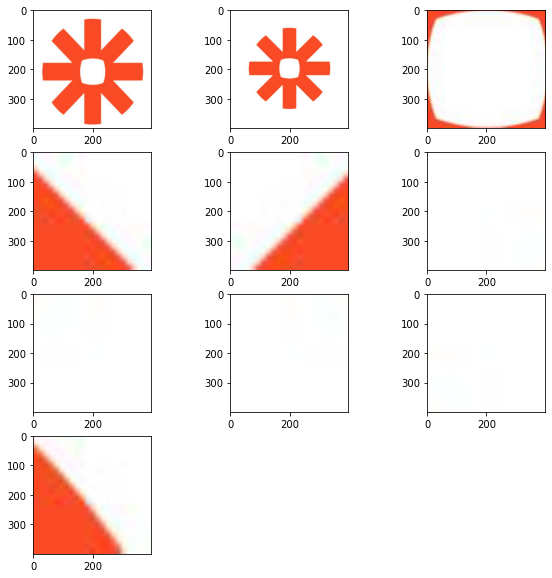

102


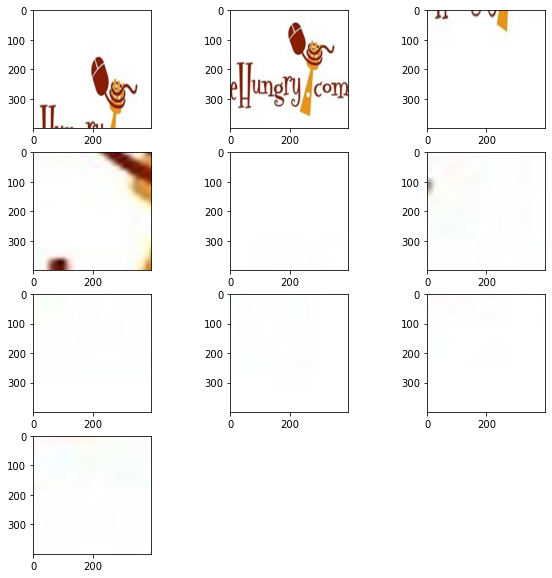

103


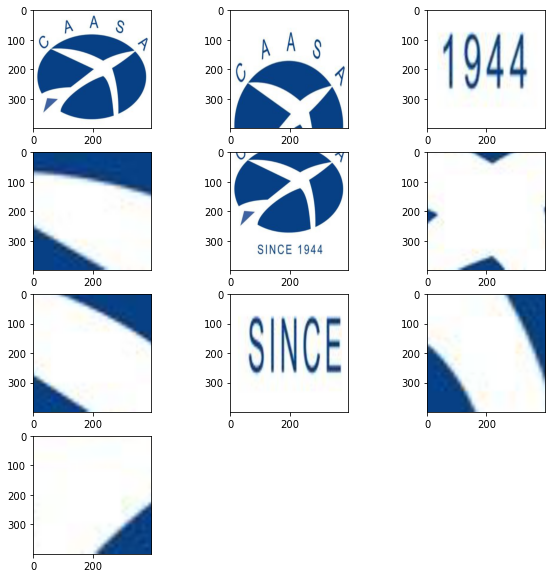

104


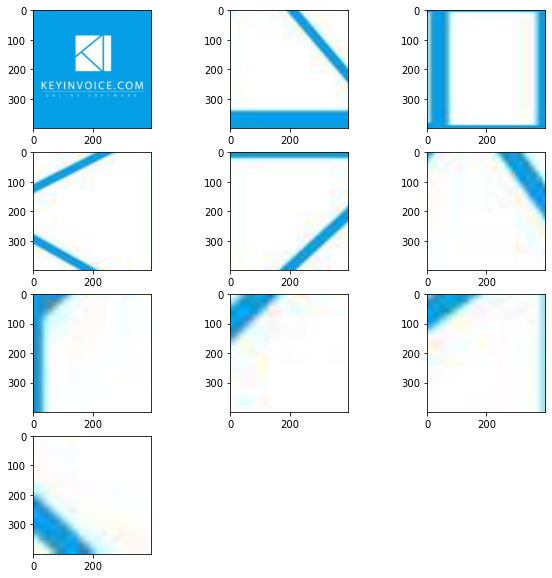

105


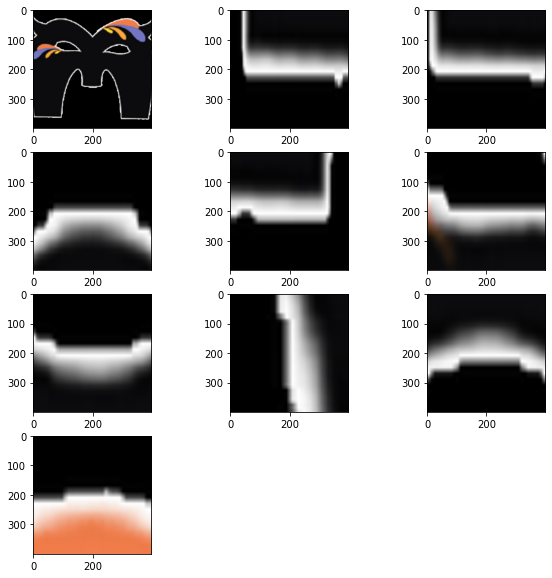

106


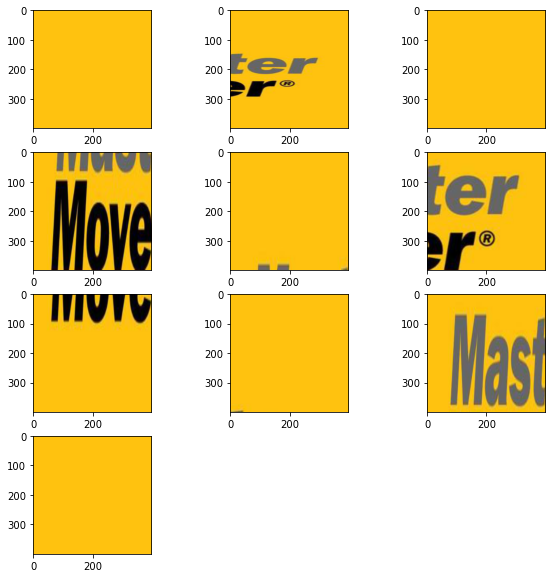

107


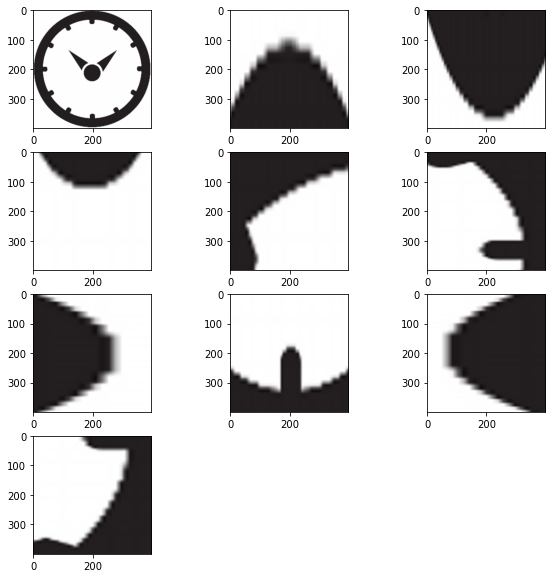

108


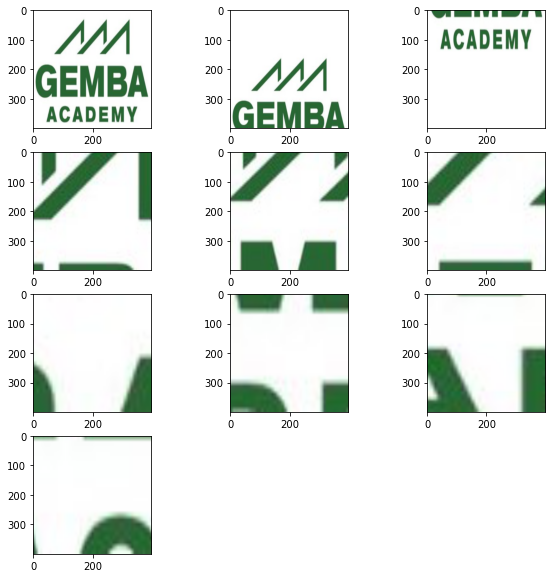

109


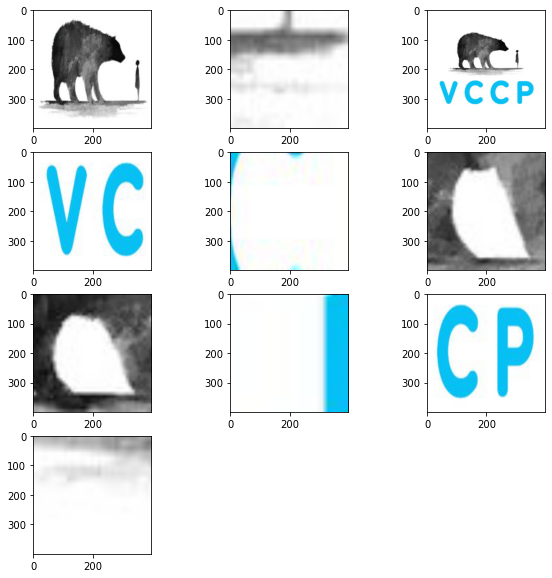

110


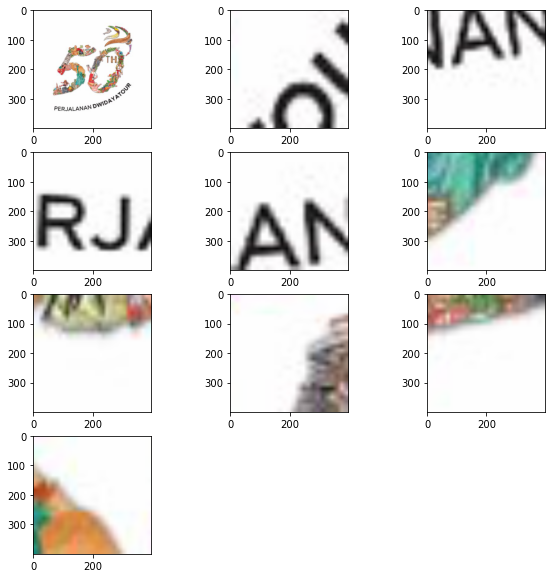

111


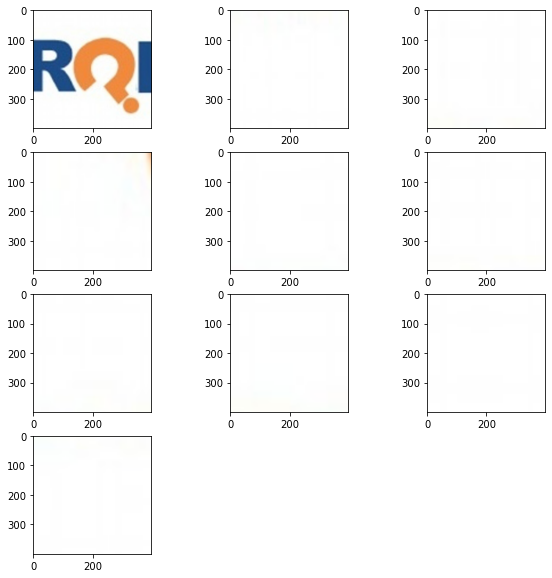

112


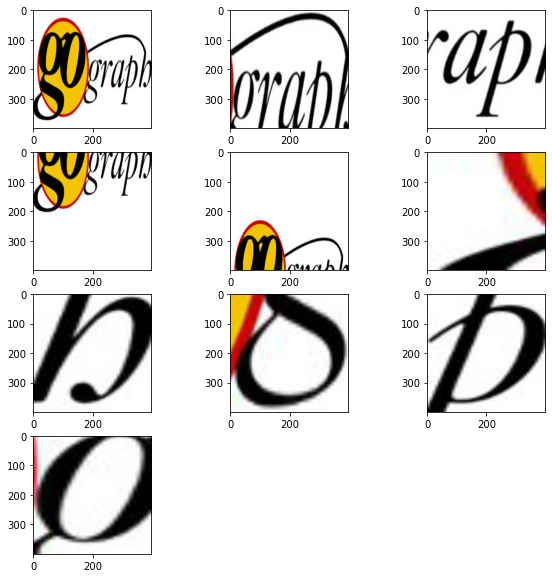

113


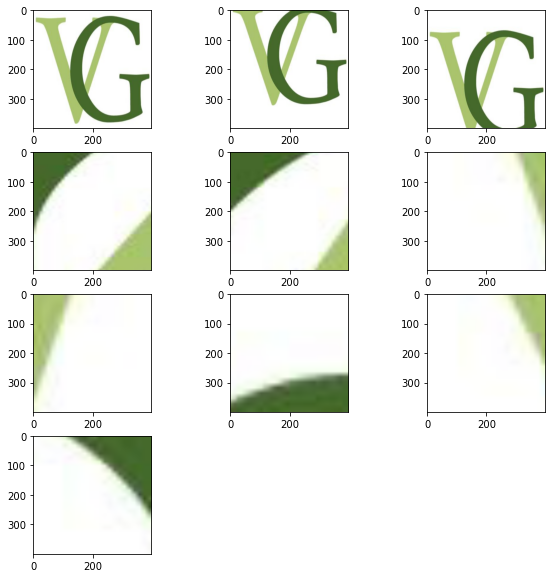

114


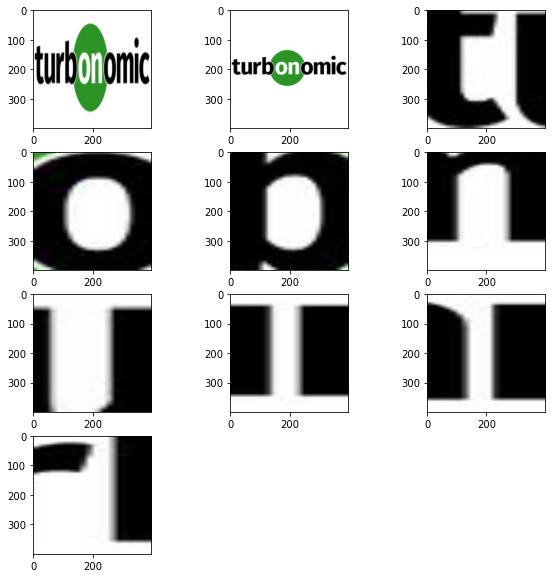

115


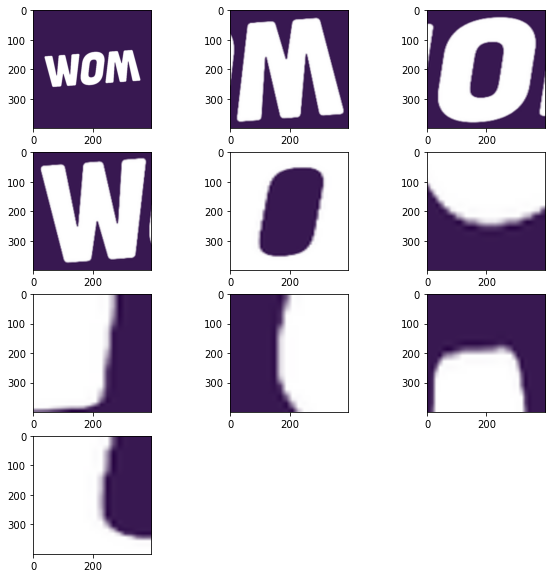

116


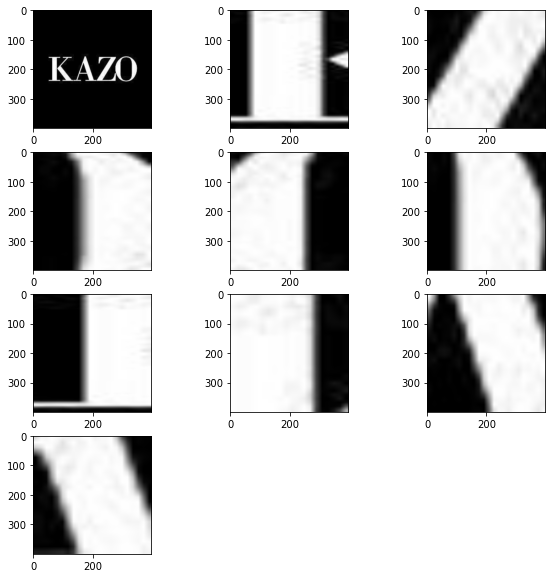

117


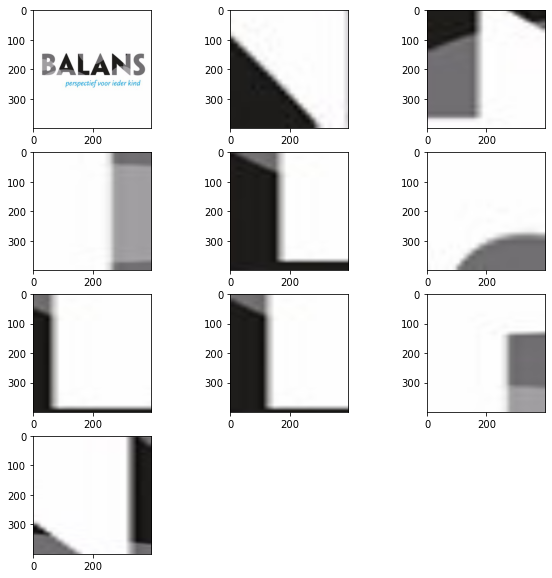

118


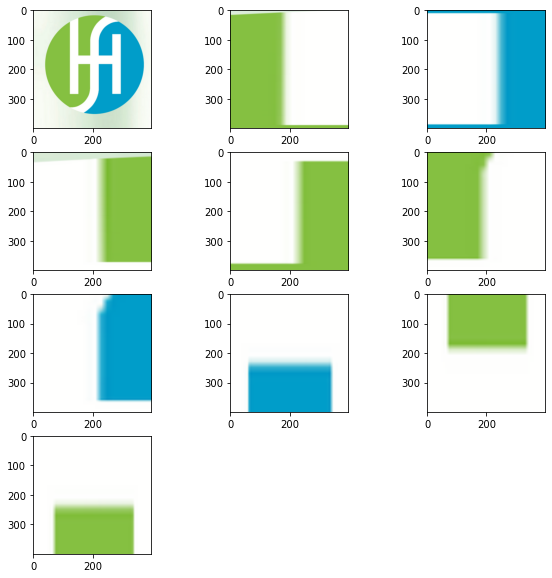

119


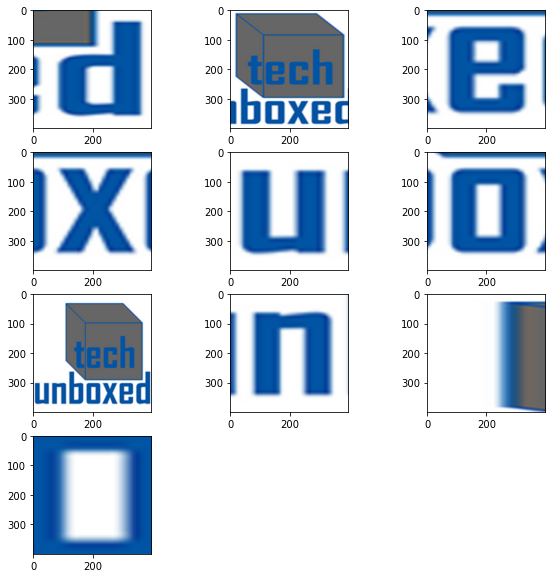

120


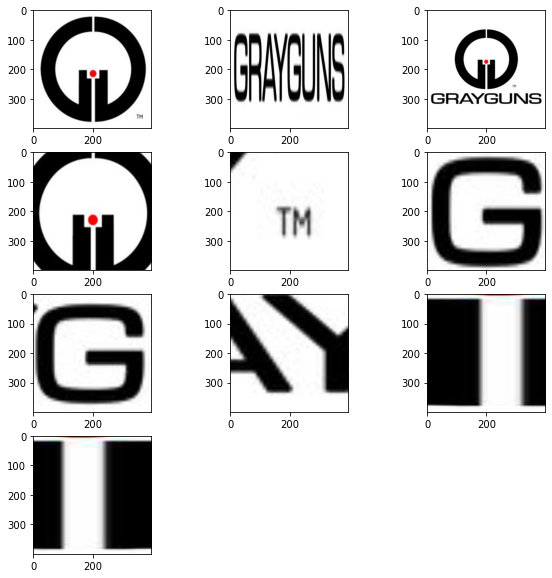

121


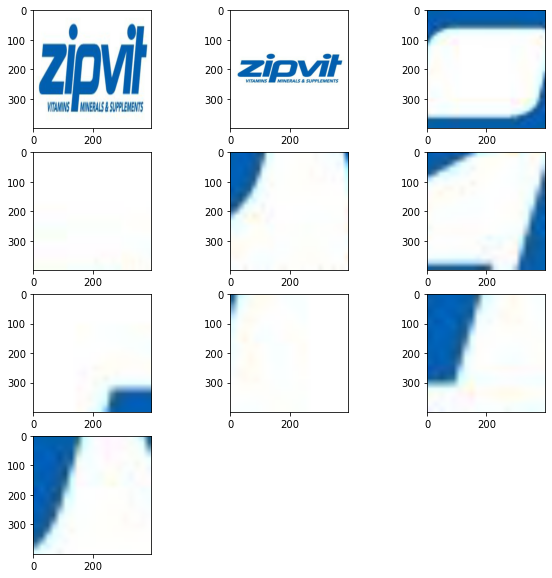

122


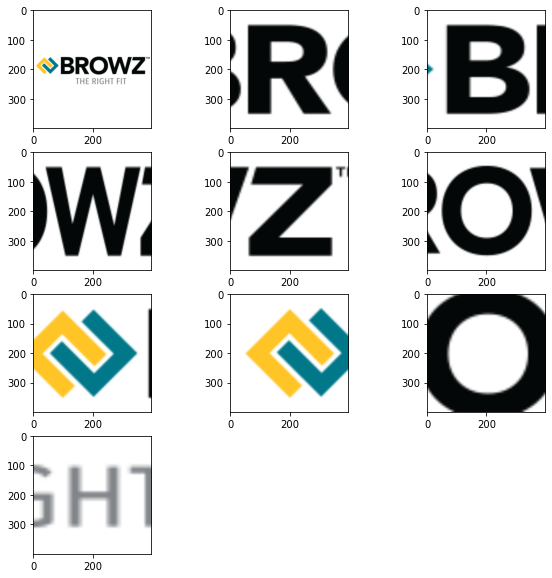

123


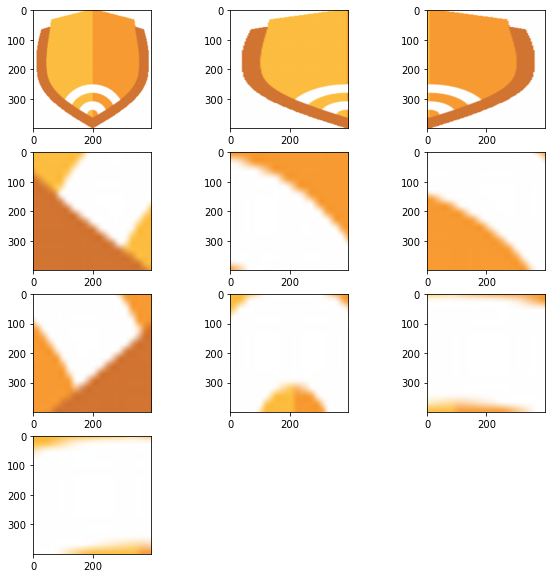

124


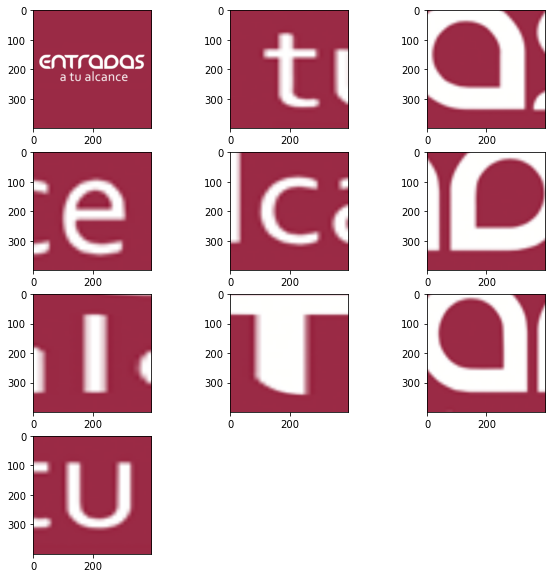

125


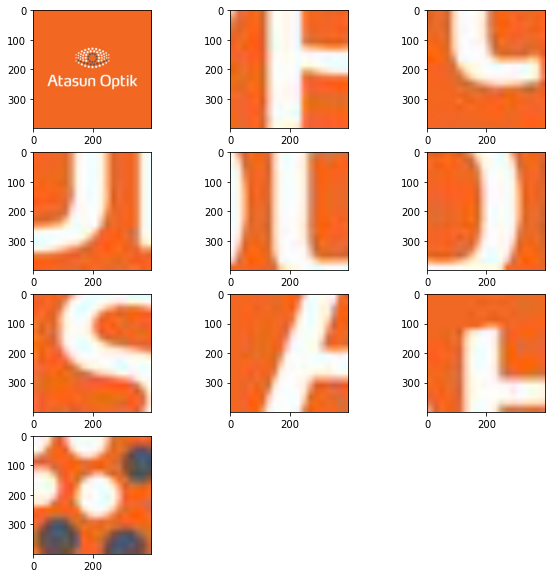

126


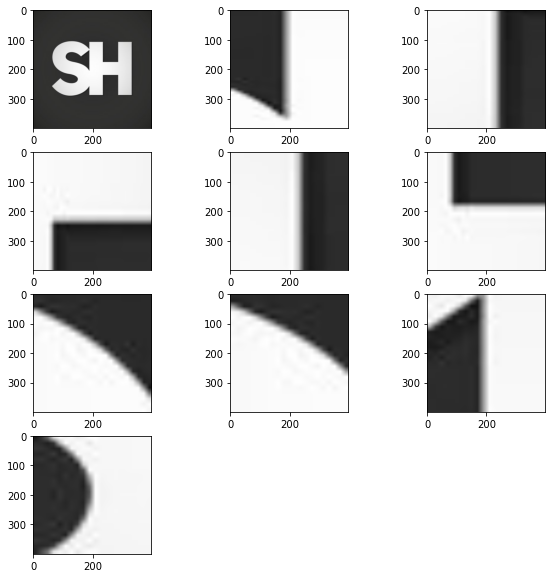

127


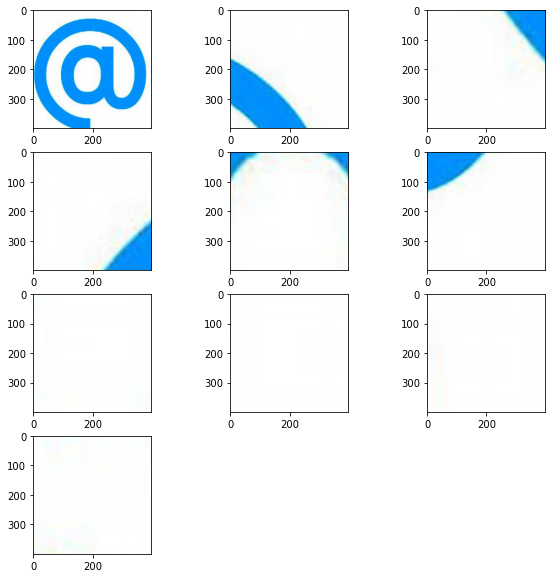

128


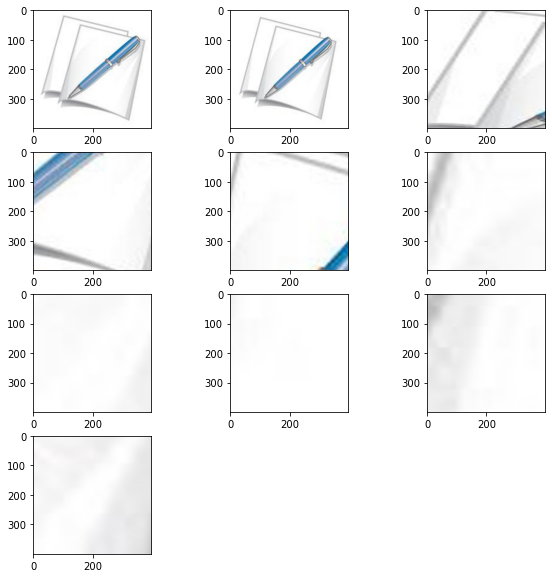

129


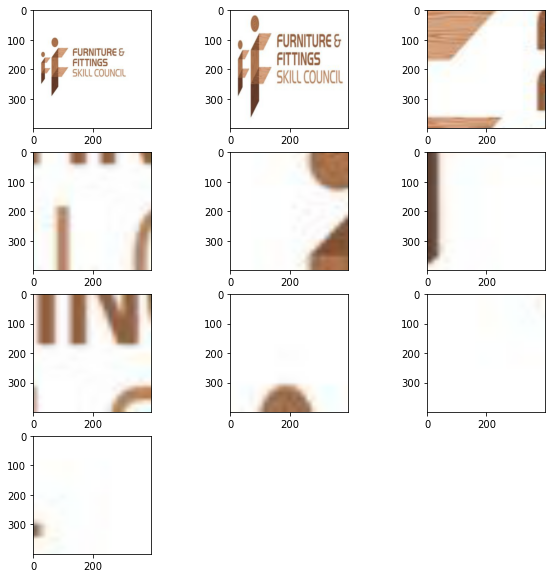

130


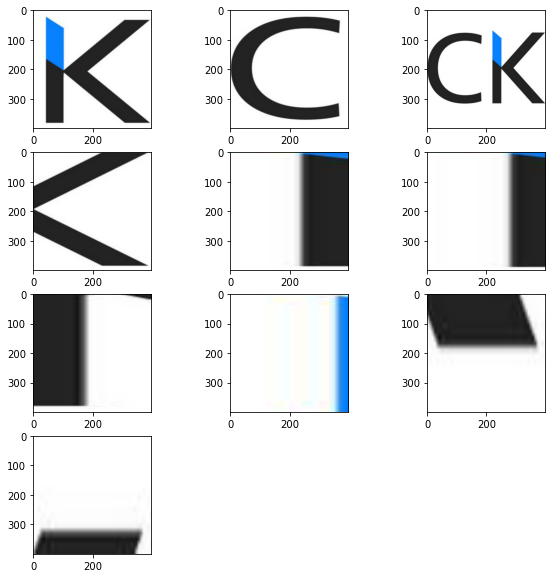

131


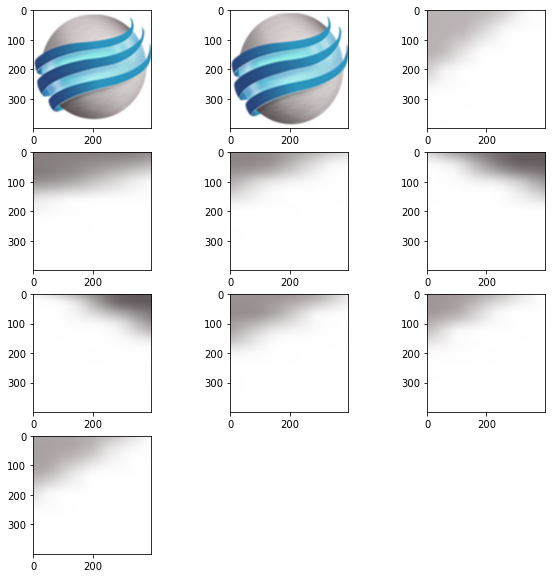

132


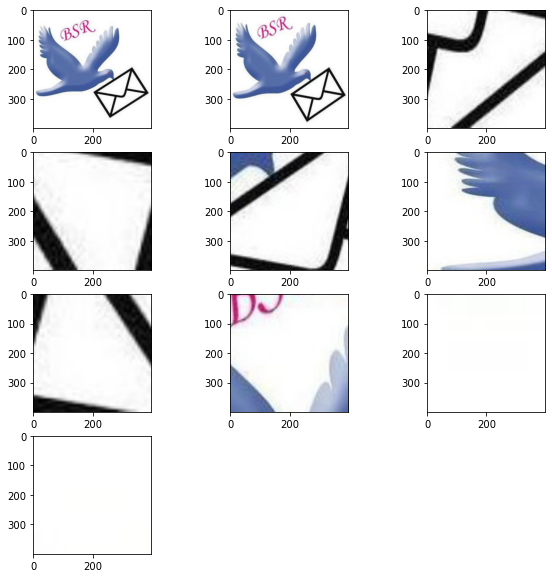

133


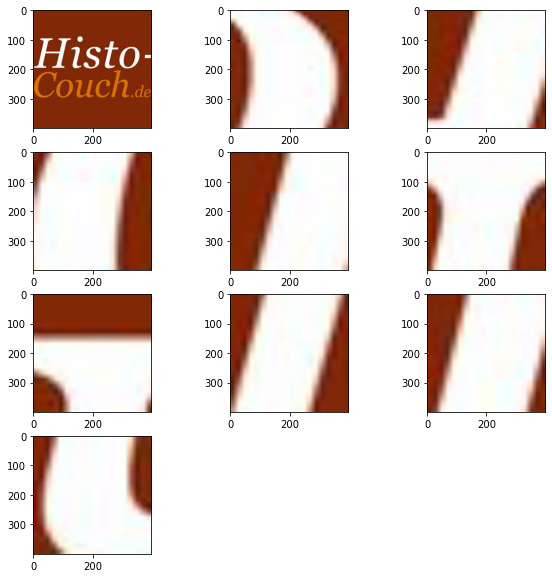

134


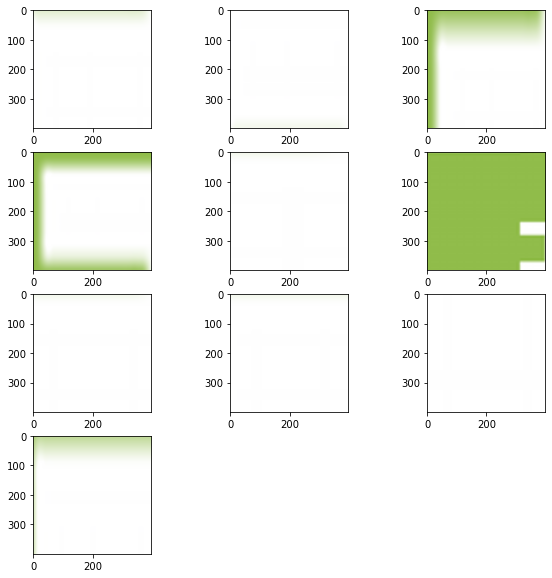

135


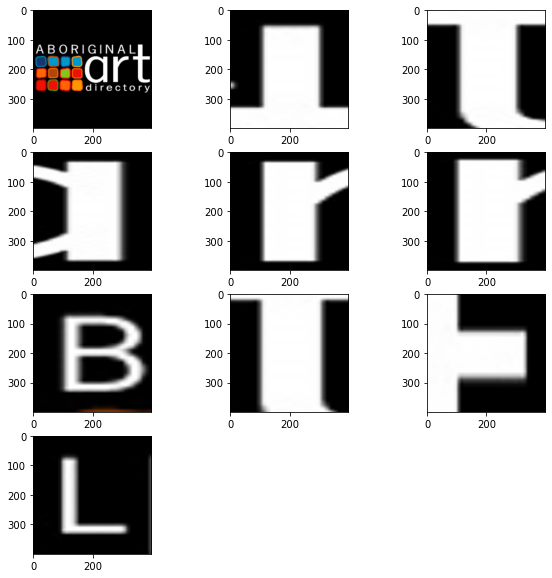

136


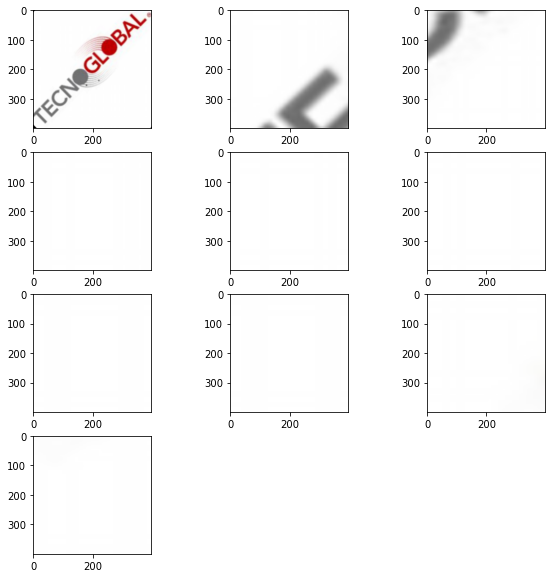

137


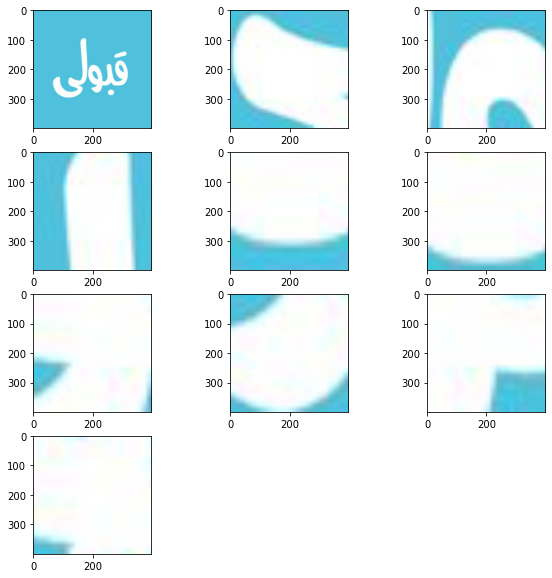

138


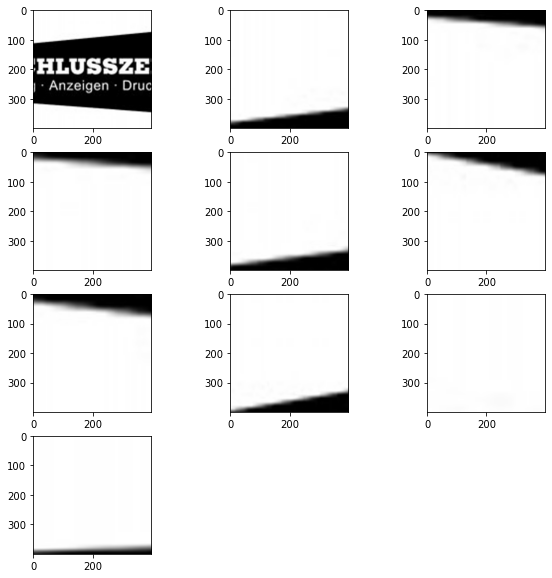

139


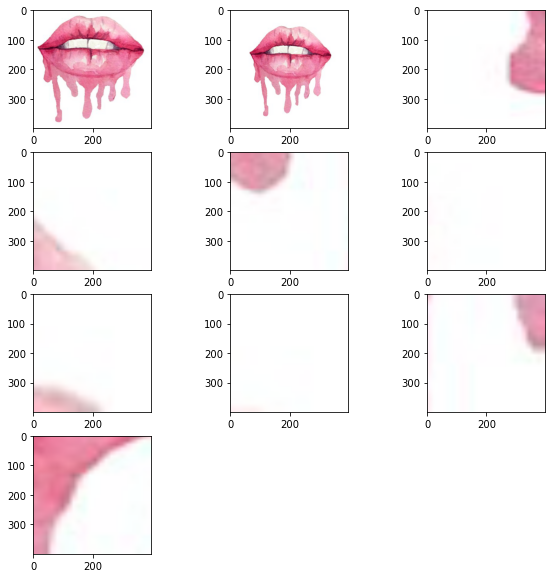

140


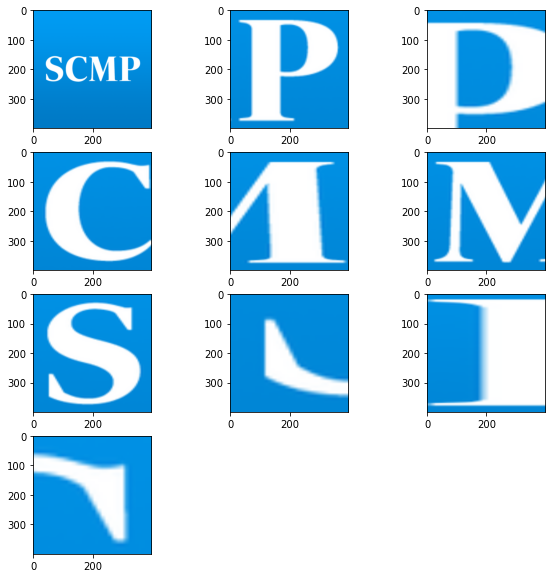

141


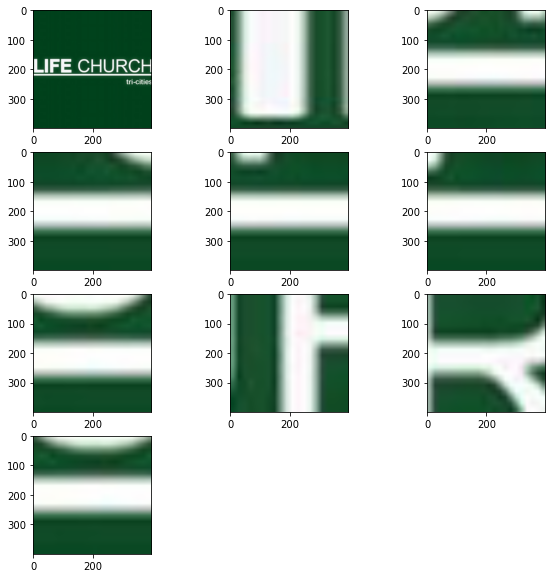

142


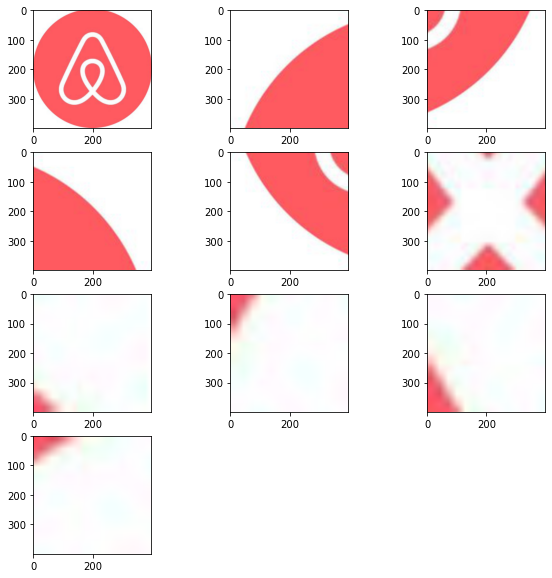

143


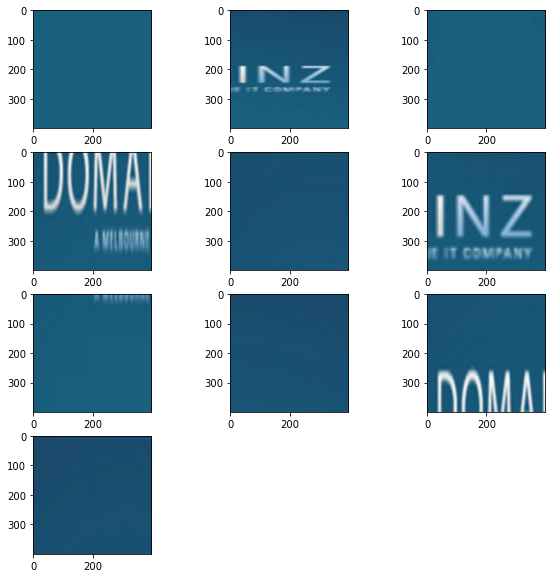

144


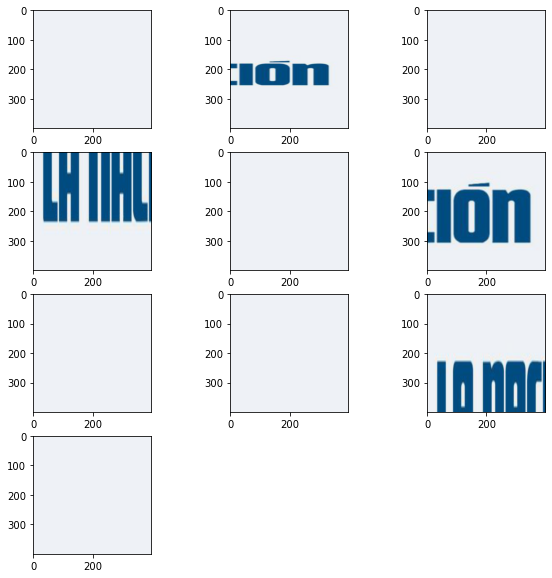

145


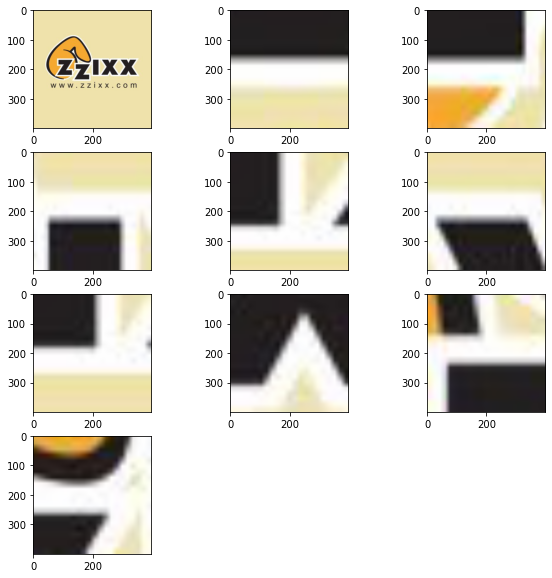

146


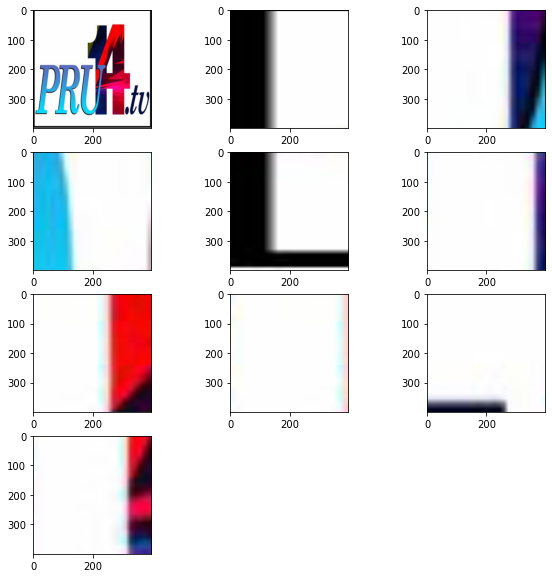

147


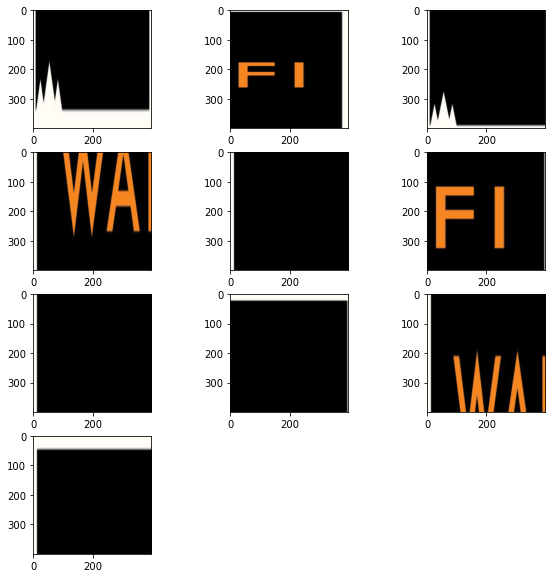

148


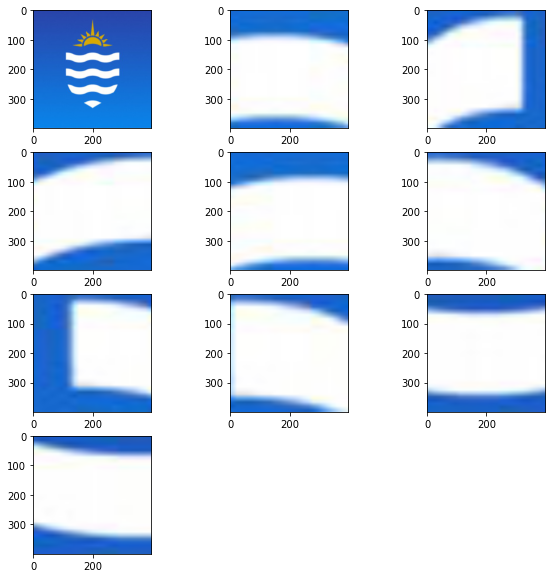

149


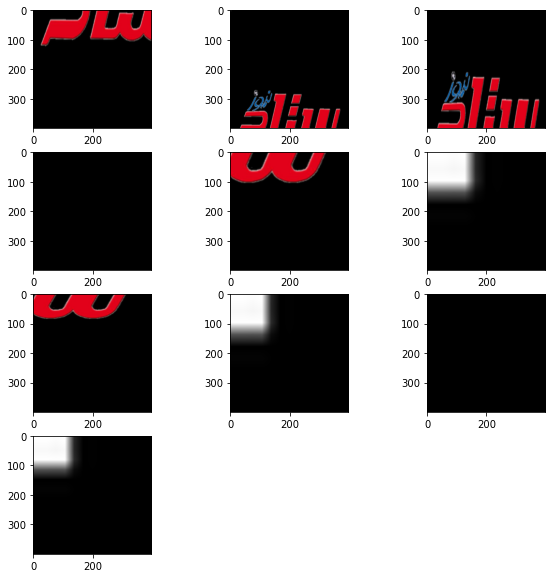

150


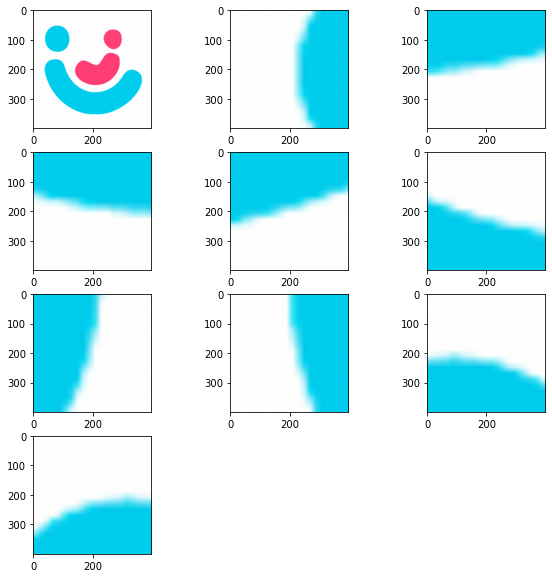

151


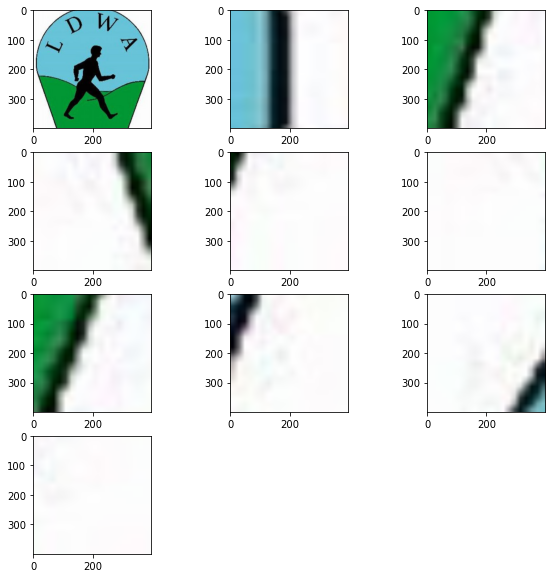

152


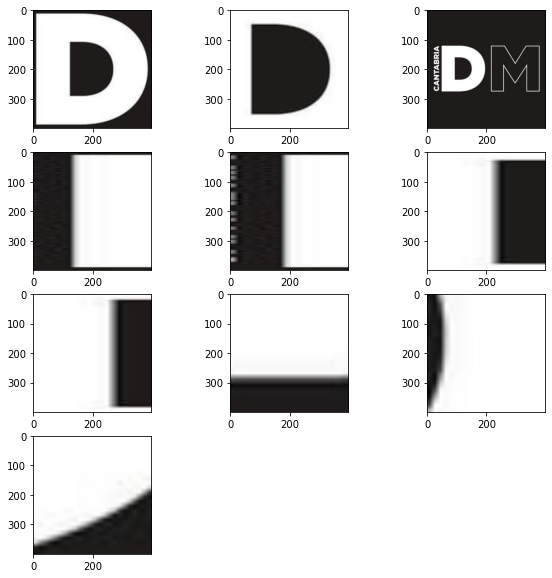

153


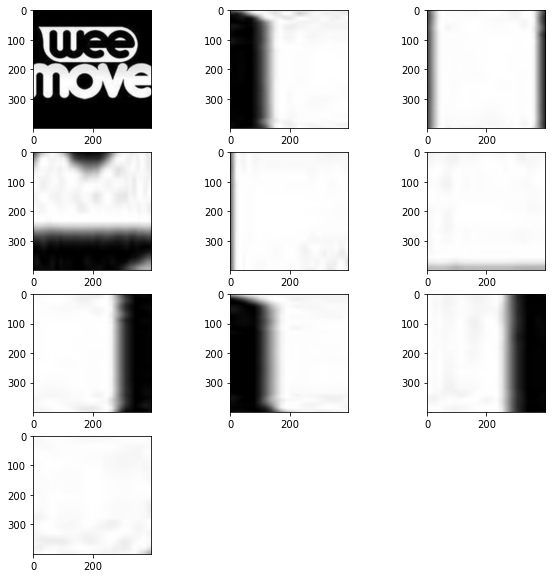

154


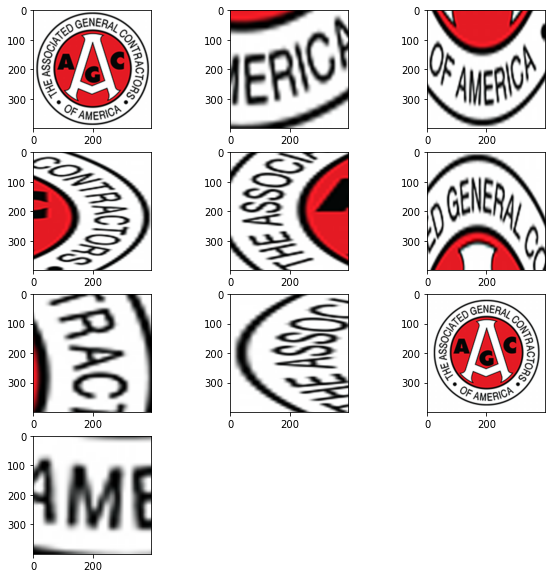

155


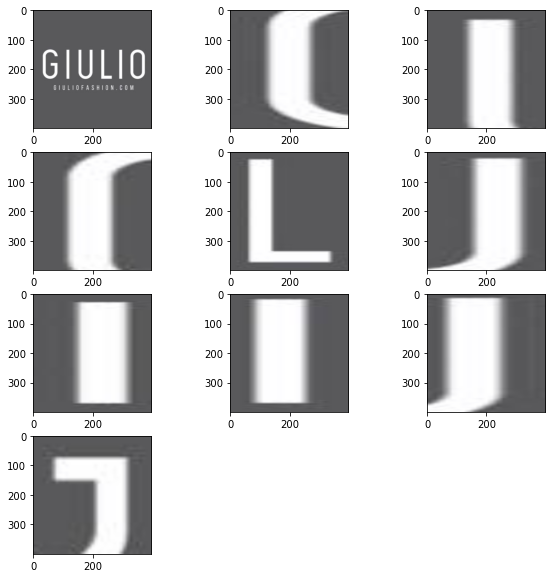

156


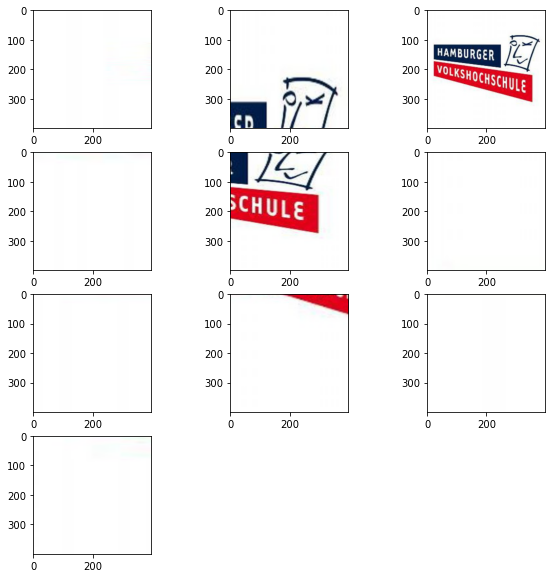

157


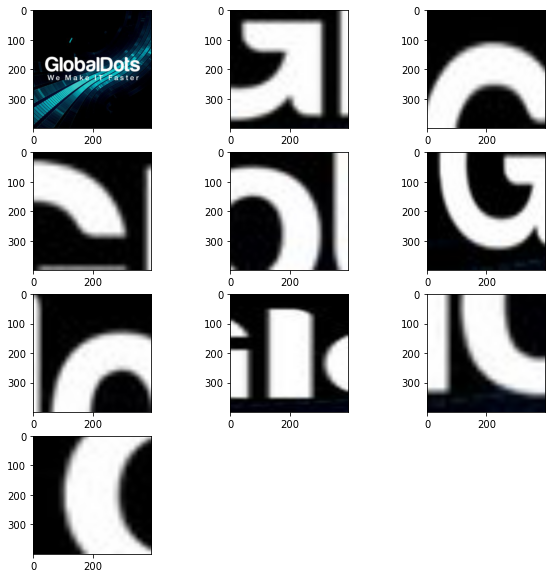

158


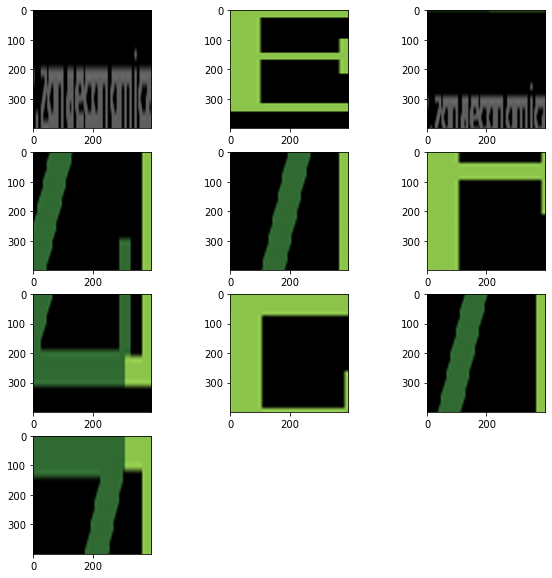

159


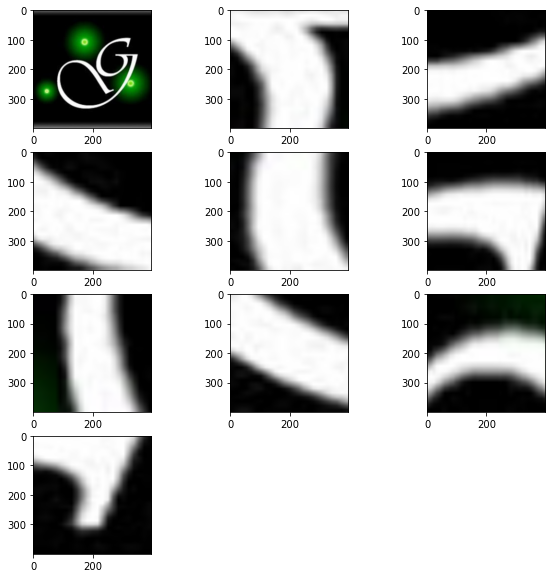

160


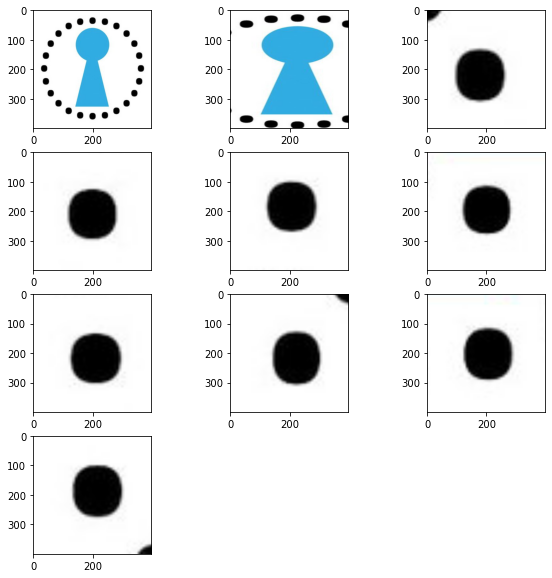

161


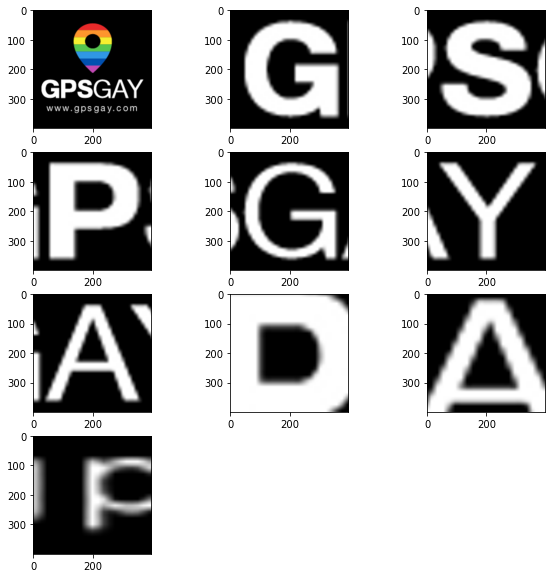

162


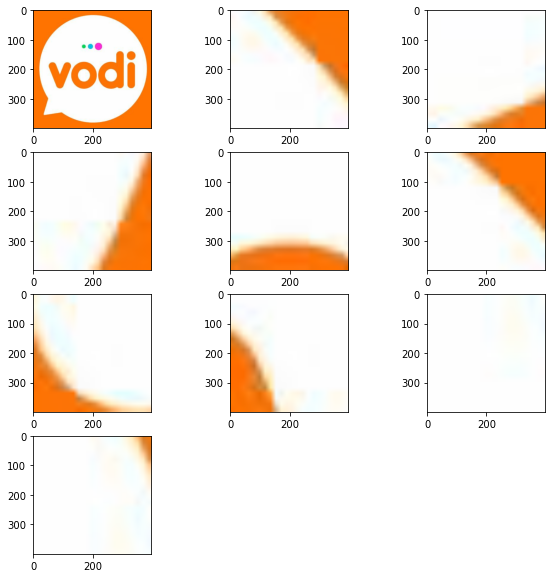

163


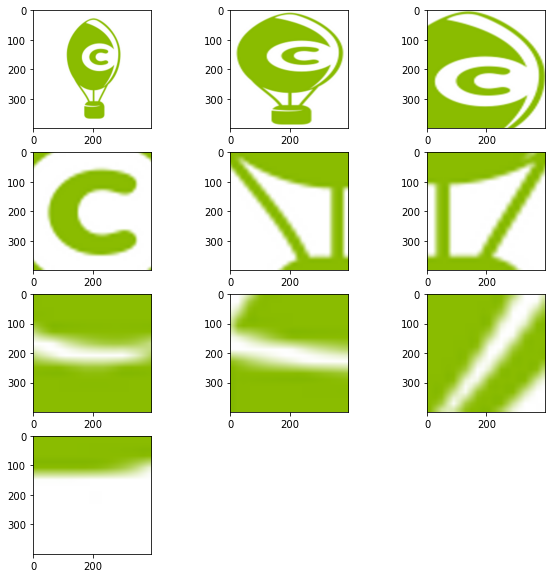

164


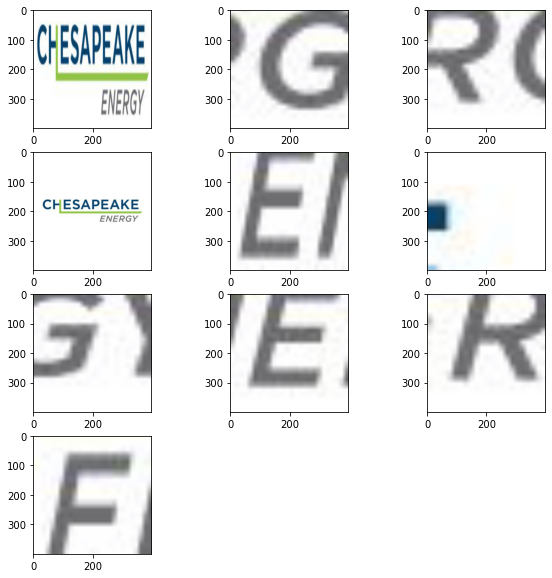

165


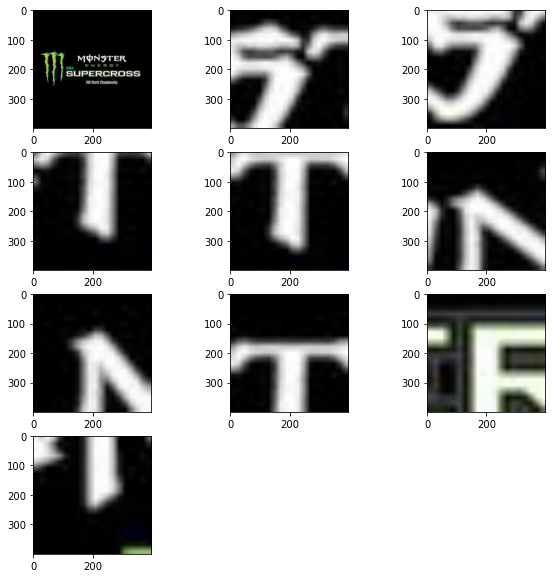

166


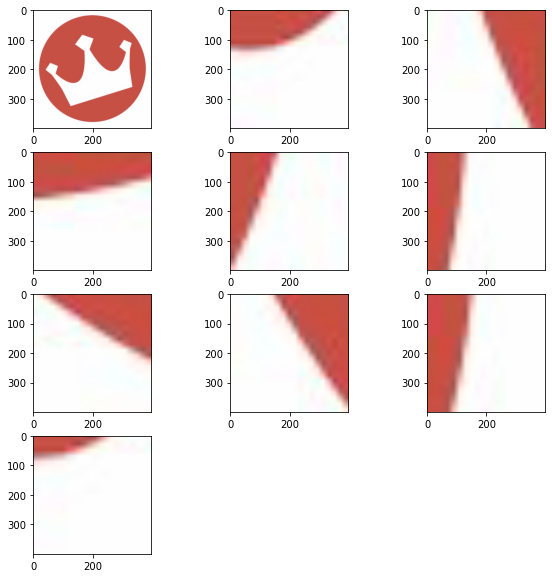

167


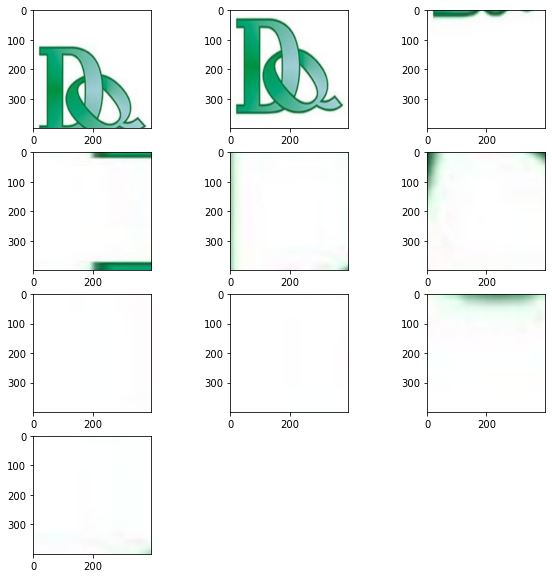

168


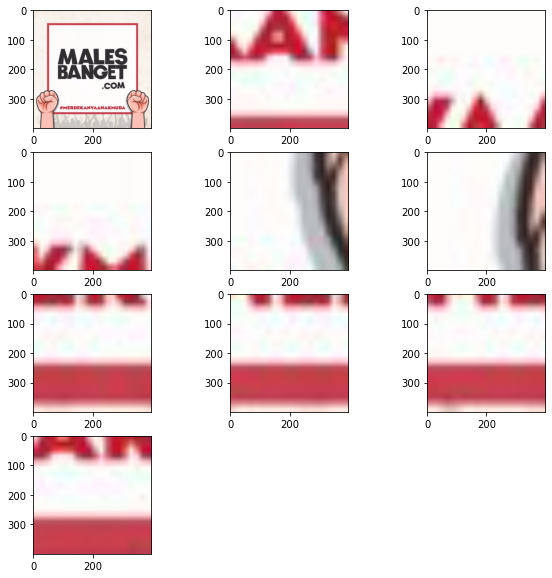

169


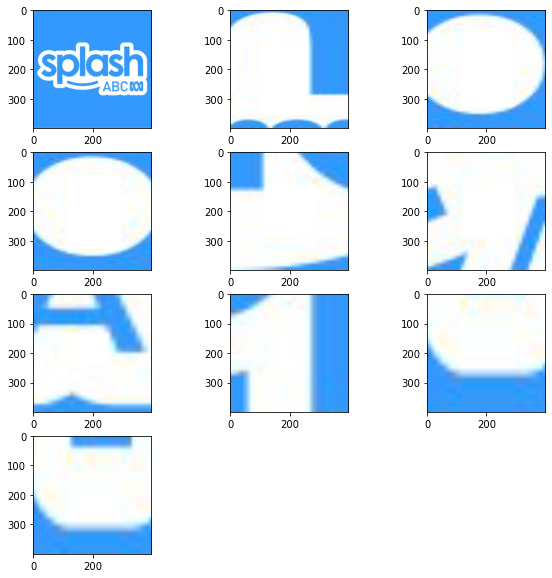

170


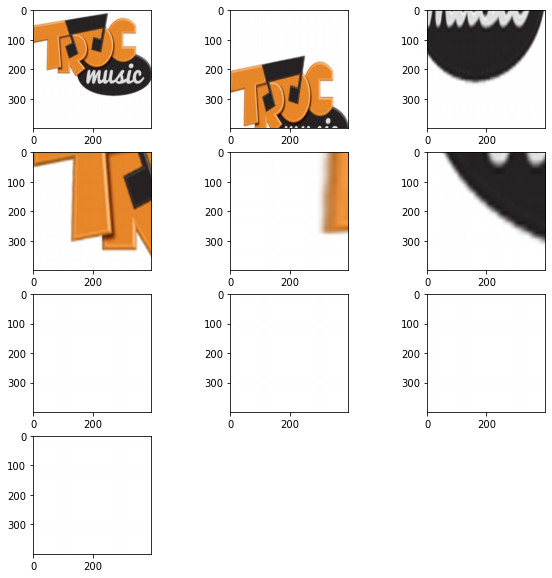

171


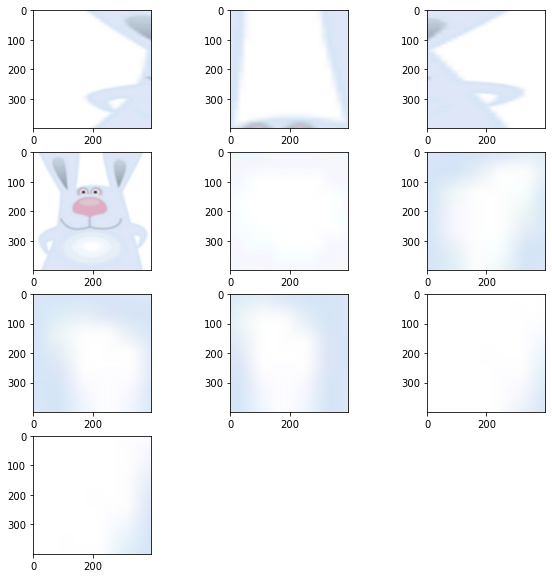

172


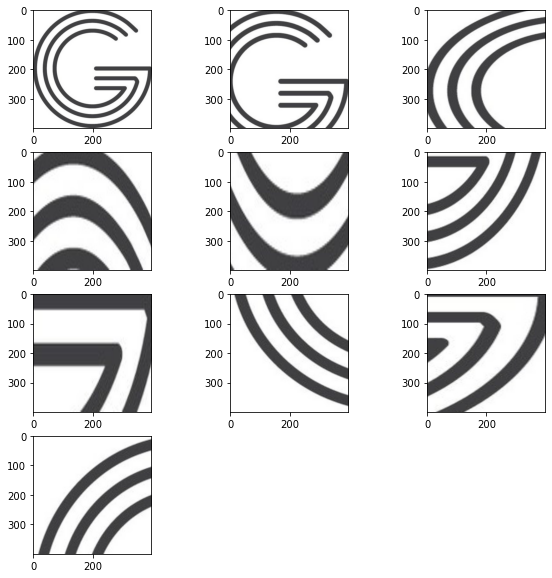

173


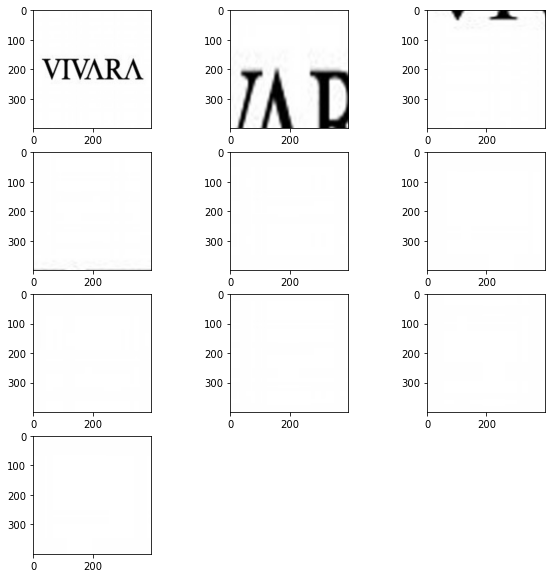

174


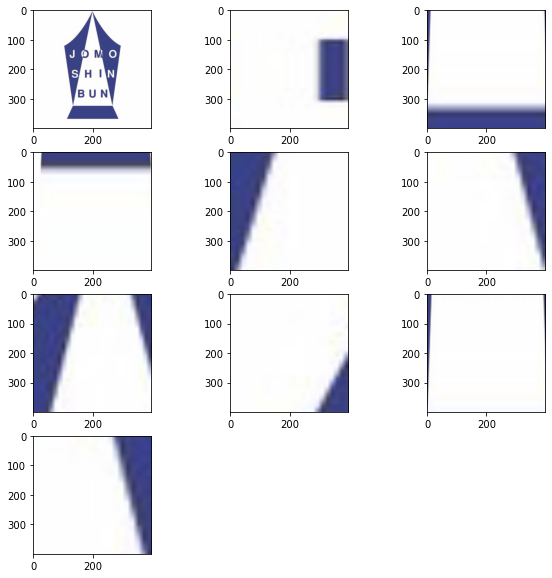

175


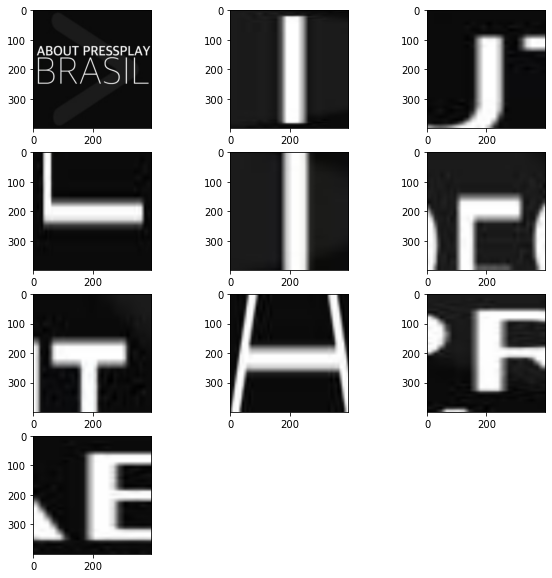

176


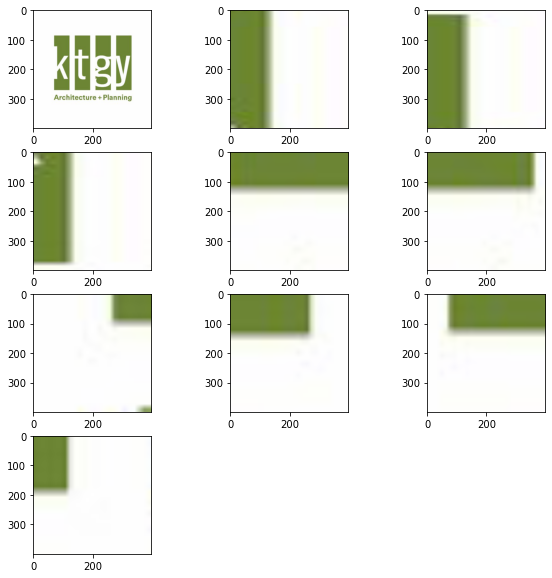

177


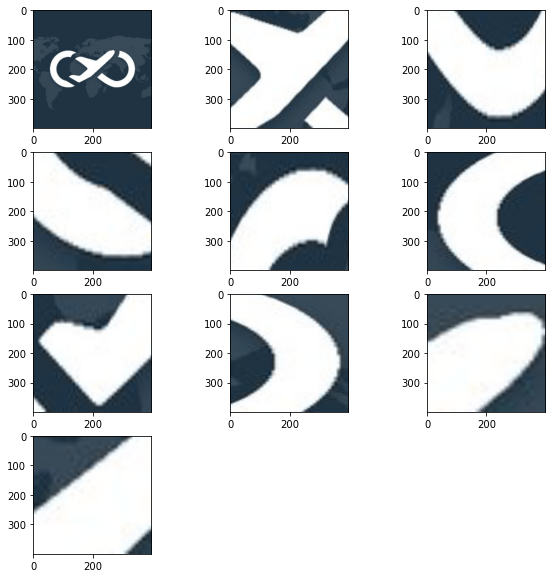

178


KeyboardInterrupt: 

In [62]:
k=-1
for i in goodimages:
    k+=1
    print(k)
    plot_many(segment_agglomerative(i))
    plt.show()
# some interesting ones from the nonpadded set
# 4, 9, 21

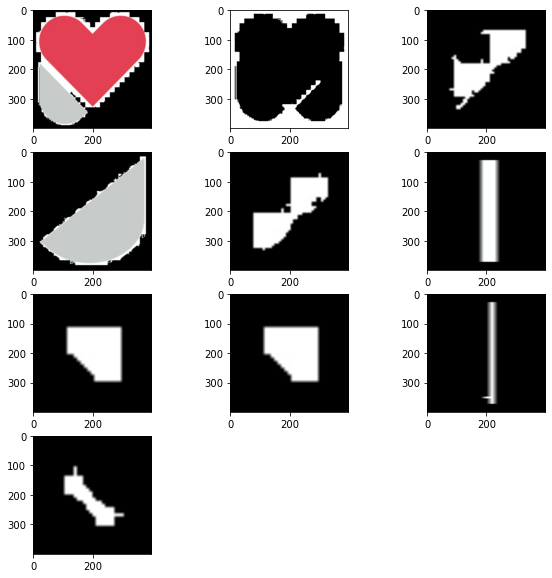

In [10]:
plot_many(segment_agglomerative(goodimages[7], bg=[0,0,0]))data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAigAAAJCCAYAAADqYjy5AAAAOXRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjMuNCwgaHR0cHM6Ly9tYXRwbG90bGliLm9yZy8QVMy6AAAACXBIWXMAAAsTAAALEwEAmpwYAACVwklEQVR4nOzdeYBcZZno/+9zTm29L+nupLOHLIQshCVBBGSVAZVNEQUUUFFEBdFh7ojb4NwZR+54fzo66lUUBXVkccEgKAghLIEQkpAAWcieTjq9pfe1tnPe3x+1pDrppDud7q7qquejTXefOlX1Vqeeqqfe5XnFGINSSimlVCax0t0ApZRSSqnDaYKilFJKqYyjCYpSSimlMo4mKEoppZTKOJqgKKWUUirjaIKilFJKqYwzagmKiFwuIttEZKeI3DNa96PUeKExodQhGg9qMDIadVBExAa2A5cCtcBa4AZjzJYRvzOlxgGNCaUO0XhQQzFaPShnATuNMbuNMWHgEeDqUbovpcYDjQmlDtF4UIPyjNLtTgH2p/xeC7wr9QQRuQ24Lf7rmaPUDpVmxhhJdxsyxHHFREFBwZnz588fu9apMbF3716am5s1JoYQD6DvE7niaO8To5WgDHRn/caSjDH3A/cDiMio1Nu3bZu8vLxBz4tEIoRCoUHPD4VCRCKRkWzisB2rrYnH4/F4CAQCg95WOBIhHAqNdBNVf8cVE0uXLjXr1q0bi3apMbR06dJ0NyFTDBoPMDbvEypzjVaCUgtMS/l9KlA3Svd1VMuWLeO/f/QjvF5v7EByvo0cCg8DB2prWfP6GjweL1dedSWCAAYRgwEMFriG7/7nf/K7h3831g9jQPPnz+fu//W/WLhwAf744zNYiMDmTZtZ89prLF26lEVLTkUk9mDFHHoFSIztucBDv36I//re98b8MeSYjIgJpTKExoMa1GglKGuBuSIyCzgAXA/cOEr3dVQFhYUsXLQQv8+XfHM2gEj/9H3RqYt57/suR4zBtiwwBkcEl9gbuRDLbcorK8b6IQxo6tSp/N/v/l8WLV7MxEkTwbYxBjwYEGHhosVc+9GPYFsWFilJGQLGIMbgWgAGy8CUSZPS92ByR0bEBEBHRwcbNmxgsAnys2bNYuLEiezatYuDBw8OeE5hYSFnnnkmlpXGigUGItEIa9euJTRAT2BVVRUnnXQSjY2N7Nmz55g3JSKcccYZFBcXj1ZrVUzGxIPKXKOSoBhjoiJyB/AMYAO/NMZsHo37OhZBEGPhIhg51Gtg4v9JTVKs2NkYFxBBXPAmzpFYT0OmDByXlZXx7vPOpbiwEFxw3Vj7TLzdAniwkt0lEn/8BoOR2ItwFBAjWAbQaSKjLlNiAmDLli1cdtllRKPRY55XXl7OnDlz2LVrFy0tLQOec9ppp/Hqq6/i9/tHo6lDYjC88847/PCHP+T5558/oq0VFRXMmjWLXbt20draeszb8ng8vPzyy5x11lmj2eScl0nxoDLXaPWgYIz5K/DX0br942gHrjGI6yDBMKa7F7evB6enj2gogouL2DbegB+7oAAK8nAL8hCPByPgiIUtFuIywAhpGhmIAo64iDFYxhB1HKQ3iPT0Yrp7iARDONEoFha2z4ddmI8U5EF+Hl6vD8e2CVsWUS3XNyYyJSYAXNfFdd1jntPc3Exzc/Ogt5Nu4XCYz3zmM6xZs2bAy5uammhqahrSbbmuO2jPkhoZmRQPKjONWoIymkSEvLy85NyK1JeTQ30BhoDHJtLYSLSmjujWHXTvqcFpbMbb2YMEI0jUwcVgLMHyeCDgx5QV45lShX/OSXgWzMU3awpSXEw0auju6qagoAA49MKc2rXtOA7BYPCEHlt+Xh5iWbHEynWxbRswOE7iZ8jLy48N2Lgu0tVNdO8BIlt3E965g9CBRqyWTuy+IG4kgmsMNgIeD07AiynMRyonEDhpOr5T5uCdN4uAMRTkFwzaRRQKhQb91K3UWDPG0NfXl+5mKKVG2LhMUKZPn85vfvMQhYUlIEJUXCzjxoZtXAu3t5fIlm2Yt7bS+Y3/g3uwHU8oguAiFrEelZSsxhVwwyA9IM3NRHfsIfTSG5j8PLzTJmKfvYSCc5by1a99jTu+eCdGhJ6ubuL5ApFQBI/HwyuvvMLXv/F1HMcZ1uMqKyvjd//zP0yaPIlo1KWrs5OS8jJwHFrb2imbUIEYF5/XgzQ10bpmI2b1Bpw9dZjeIJgIVmwgh3A82bAMOABhMH2CaWtB9tUSWv82PX4vUlHCpVUTOOs/f4B/8clQWIAlBiOCZSwEgysGx8C//9u/sfzxx0/o305ll0AgkPygoJRSI2lcJih+v59TFi2mpLQMA3gdMLg4oRChDZsIPvkyoc1boacHYwwCuPEXUdtAv1U8xOempMwljb3Fh7B6g8jWFsLbdxB58iUmnLOU6Ve8B8/0qYjHjxjYum0rr699nf21tTz+pz+xZMkSamtrh9ylnMrj8TB/4SnMmDY9ljUh/ZbeOG6YaO0B+p56hY5VazEHm/BGgjg2RCwLryvxFUhyqAJfyuMUYvNOYmuUHCTsYOpDFDQ0UbCzBv/eeorfdzHes07D5Ofhid99VEAcQ0XZhON+TGrsGGN45JFH2LVr1zHP279//4gNzbS0tHDfffdhWRa2bVNSUtJvnkdlZSWf+tSn8Hi9w5rD9fbbb7N8+XIgNiemo6MDx3H6/RyNRocVbwNxXZdf/epXPPvss8c8b86cOXz0ox/V5EypUTQuExQAcQWPA64YIuJg9tTS/vu/El31Ok5fB15XsF2bsB1/QzbmuF5MPK5gxBC1DMZEcJvrCS7/G8HX1mF/6GLKL7sIKS5l3oJTmHfKfKKOQ0VFBfmBPB5+5GGeeeaZYT0uFys2aVUgmlzmbLC7uul69kX6/vQspqER17gIDhFbAAuPe7wvlIIQ60myXBfp7iK4YR2hLdvIW7qUko98AObNwPHYeNzYiqbjvgs1powxPPTQQ8N+7g3Hjh07uPfee5O/iwjTpk3j3e9+N5MmTaK6upre3l78fv+QavIcbuPGjXzzm99M3nZifkjqzyPJdV1+9rOfDXre+973Pj760Y+O+P0rpQ4ZlwlKb18fHV2dlJYW40Z6Cb3wOm2/eQK7bh+O5WIZIWR5MJaFxzixnoPj/qQjYDy4YscSBMARB6e5Hv/P/kj7mm0UfvZa/CedhNgexONh/imn0FTfcEKfqqz4WuioBVEMHsfB2bOXjl/8mcj6N4mYPiwMHteDEQ8GsOKrcFxxhrzUSDjUM+OKB0fAF40g0U5CL7/Iwa3vkPexKym69DysQCHimpQly0oNzBjDvn37qK+vp7S0lBtvvJF9+/Zx6qmncu21157wbQ/0s1IqO42LBOXwce7ysjJKiopxurro+P1fifzxaaxQFy4W3oiPsA1CFJ8bjfVIDCNhMPFlO3Z82ERMfF6GAy5Bwhs20vKvdRR99iaK3nUG4rNZeMoCLBMbgkpUeTXGYIwhEokc0a0e8AcQ61DbAomJv/ERKG8oQt/rW2l74Fc4B+rwRx18RnDFxhWHxICOKwYjBpJHjiFWCqX/mSaK1wiGWL0Yjxsh0lJP90//B3dvI2U3XoVbWozX5z2iem0oHMYd5pwbNbJEhMrKynQ3A4hVMz548CDPPPMMl1xyyQlPHldK5Z6MT1AmTJjAb3/3P1RNqMIAEQsKvT7ywn0c/PWfMc+ugmgIV2KVTBzLxY53DrgiJ7g0+FD9kPjEDYRY7ZCoONDQQNf37yf66Q9TdOlFlBWXcdrpp/F//r/v8s3Oe3GBzs5OGvYf4D/+49ts2Xpoo86C/AJ+/eCvmTlnFi4OFoLl8VFVVUXEgB2O0PPSatrufwRpacaLwSAYiTXElXgvSEpbj0f/awqOgOCAERyx8DjgBPuILv87LW0dlNx+Pf/0lf/Fbbd+BideHMa4hn/653/ipZUrh/0XVsOXSH5Tfx9sWfBY279/P3v27OHss8/ul6AnqxunfHg4/PEkjmUq13X7tV9EdE6KUiMo4xMUgNmzZjN79mwAXFxoa6fu578jvPI18iMhIjaxFSfGkFiek5gsOvzqapLy336HcCU2CdUYg+lop/dnf8ByLIouv4DComLmFRYn79sVw67du4+ohWbZFicvnM+CU+YDBkxsACUKWOEgfc+vpvtnv4eu1mRLUm/DOpGycYdd1aRMqnWt2KTiqGXhdQxhTwT7pXW0OYbqL36MmafNiJ1tYjVYyotLht8OdUIeffRRHnzwwX7H1q9fn57GHEVvby9r1qyhtraW3/72twCUlpZSUVHBPffcw9SpU5Pn7t+/nzvvvLNfNdi6usysfr527Vo+8IEP9Dv2iU98guuvvz5NLVIq+2R8guLz+iguKiYk4HMMbqibzt8sR557lYJImKgdG9qw3bGfxBkb+gGrs53eBx4FC4r/4SKM14uR+ARUI0yeMoWiAUpnuySqv8V6MDAGKxKm78VX6fzFw9DZjtcVnLQUUhMiNhSEXSJWkNDqtfQGAni+cAN2UTHGFqxMKq+bg9ra2vj73/+e0b0MxhhaWlpoaWnhrbfeAmI9Daeccgpf+cpX+p3b09PDs88+Oy5qmjQ3Nx8xGfn8889PU2uUyk4ZX0M0HAnT2tWB1wXHROh94nkiT63EioaI2AYXic8TGfsXaQOEbQh5DHS2E7z/D3T+/UVMNEKE2PJcTGzi60Dv47HlzUIUIYIDkSC9L71Kz//7PU57G70eB9dySccenj4ntoIo6BEEF48TIrLyVboefwbHCSGAo93ZadXS0pLRycnRGGPYu3cvPT096W6KUiqDZXyC4vF6KMzPx3JdIm9up+eRp4k6XURFwNj4HAsLCNuJiaJjRwz4o4LHjW0pGO1uo/OB39H199V4ww7JOrcCXp8Pv9/f7wuxSSz39UUidLy8ntb7f0e0oxV/1Mbv2NjuoWGrsRS2DV43tkNy2LawDJhoNx1/fprQa2/HenvG33tjVpkwYYLOeVBKZa2MH+IRsbBtD257K50P/ZFwdwseEr0SscmihrS8hwMkh3JMfBat1dFJ5y8ewviiFF90PlgefB4P9//0Z/T09WC5sQ37LPEwa8YMHEBCUbrWrKXrZ7/Gd7ANR4SIRWyiqpV4gGP7uBL14Sxj4gNRsXor0t1G52//iO/kWVgTymITiFVatLW1jcseFIj1onR0dPQr6tbR0TFuH49SauRlfoJiQByXjudXE9m6FY/rYLueZKHVxMvZCU0aHXbjjlwNYzDQ0UHvjx7Fxov/4rPxWF7mnHwyEt9R2RArPy8GjBMhuGYd0e8/gulqJ5rYdVkSc2pOZKLv8Fkp93uom82Dz3GJ7NlNz19WUnzzNegklPTJhI36hisYDHLVVVfh8Rx6CYpEIrocWeUsy7L67e2WqYay0ehIyfwExRKc+ka6//YCHqcPy9hExQNEM/KtUUzsDd3uaKHz//2GQttQdP452JYHcYltTGgMgomV6V79Bp0/+i2hroPkR2I9J5n4wIyAg+AxNv5IiODTz+O7aFnaeq7U+GaMGbHy9EqNd+Xl5cyZM4fJkydndJLiOA61tbXs3LmTjo6OUb+/jE1QfD4feXl53PqpT+KseQPrQCNRETxGiFoGT4a+MRqJrcgJi4OvrYXgfz+MiEXee5bh2j78UYjaBseEib6+kY4f/Y5o80Fc2yHoiU34zVSuFQVHcMQm2naQ3qdfxri6u/FYSgyBuK6rO0srlQUsy2LatGl88IMf5Pzzz+/Xq5hpQqEQzz33HI888khuJig+vx8RYf7JJ3PxxRfzpVs/Q/e/fx/LcRDx41guXhOJ71eTeW/mYiAvKvR5LVwxWG3NtP/013gdwVy0DFd8uMYhvGYz7T/+Daa5GZ8Teyxe18WJF5zLNGIMfscB48URL5aJ0LV6LZ62bgKBQHKajAEi4fC4Hn7IdDt37mT9+vX86le/SndTlFLDJCJUVVUxa9Yszj77bM455xyWLVuW0QlKX18fu3btoqCgYEzuL6P+EkVFRTz4698wZfpUCrwBCgrzsXfVwP6GeOn5+GTYw6ueZZioFSuRbyTW22M3tdLx018TyBM8S88k+OZWWn7yIP76xlhxNgtsV3CxkDRMiB0qgxWfFGwQY+FpaOIbH72er/5//0nUsrHEJRyJctcdd2RcwbDxrqOjgy1bYpWIV6xYwbPPPsu+ffvS3CqVat++faxevbrfsQULFlBSosUM1ZFs2+bkk0/muuuu4+yzz2batGlYlnXERPHDqxWn21i2IaMSFI/Hw6KFC5g9ZzZiBBMJcfAPTyPhQ5vgxeaNpv8f6ajkUMG4Q7VoDdLcTMePfoN98R56Vr5OoL4uXl4+tb8kkx+XxFfyHHpcluNQ2dzDxMULwZ+HJYb2jk5cN0PH38axDRs2cNlllyUnqOlql8zz85//nAceeCD5u9fr5bnnnuOcc85JY6tUJku82Xd1dfHOO+8ccbllWUyYMIGpU6dSVFQ01s1Lu4xKUGIEy43N44h2duFs2ollTKZ3mgwituQo2tJEz8OPE8VgrPh8k3H4uFK3vLe37CXS1o53Uh4CFAQCFBXnXiCNNmMM0WhUh84y2OGrGzweT0Z316v0chyHd955h9/+9reUlZUNeI7H4+Gcc87hmmuuYf78+WPcwvTLqOg59JkwtnuwU9cEBw+SlkIgI8gAjlgUhoSg18XrWOBasSqx6W7ciTBAWxtOTR32pEnYRog6DtFIJN0tUyrtwuEwvb296W6GylDGGBobGzl48OBRz/H5fBQUFHDhhRdijMmIIZ6xlFHrmeKlTXCtWCG2yP4G3EjfmO+xM+LE4FhRopaLL2rF9t2RaGxzw3EosWurEUPQhHB3H8AxBmMg6jq6ukQpIBAI6PwTNahEz9tAX47j5HSv6aAJioj8UkSaRGRTyrFyEXlWRHbEv5elXPZVEdkpIttE5LLjbZAbn4QZNg5OTT3GNVlSayO2G7Er5lAF3PGeeAG2YwjX1WO7EUTA5/UTyM9Ld7NG1VjHhBqfgsHgmCzFzAQaE2o0DKUH5UHg8sOO3QOsMMbMBVbEf0dEFgDXAwvj1/mJiNjH2yAxgOvgtrTFdswd5wTBMvHpsMmJsZm5nPi4mFgp/FBbG7bjAON5IO64PMgYxoRS48CDaEyoETZogmKMeQloPezw1cBD8Z8fAq5JOf6IMSZkjNkD7ATOOq4Wmdjmepbr4nT2xH5XGUkkVh/F6eqFcDSefJmsT1LGPCaUynAaE2o0DHcOykRjTD1A/HtV/PgUYH/KebXxY0cQkdtEZJ2IrOt/SXz7OdfBhEI585F8PIqVpDGYUBgcN7apYHaMxw3HiMbEsSbOKTVOjOL7hMoFIz1JdqB0YsB3LGPM/caYpcaYpYef7MZLkorr4orRJCWDGRHEdcE1OBzlHzu3DSsmKisrR7lZSqXNCb9PqNww3ASlUUSqAeLfE7t+1QLTUs6bCtQN9UaDwSC1tfHTRfCKncufyMcFV1xssXFtCwsTWz6d7kalx6jEREJ5eTn5+fkn3EilxtCoxoTKfsNNUJ4Abon/fAuwPOX49SLiF5FZwFzg9aHeqNfrpbysHMuAWBZuvh8rG5a6ZDExBo8/gGV7Up5MOflvNioxkRAKhXT5thpvRjUmVPYbtFCbiDwMXAhUiEgtcC9wH/CYiNwK7AOuAzDGbBaRx4AtQBT4gjHGGWpjbNumoCAfAWzLJlpeiGXiexPk5Hte5rOwkJIi8HpidWzGZ3Hc4zKWMZHQ09NDOBweoUeg1MhKR0yo7DdogmKMueEoF11ylPO/DXx7uA1KDuhYFm51OYJFbHaDyjgGXLGQqjKMx8YgOI5DNJzdlWTHOibU+OTxePD7/eluxpjQmBhfjmcvr3RWr82oSrKQWBkCxhICUyciYsc3qktcmPymxpIxYExsjZWJ/SMIgmNbeKdOxLFiZQycaJSIftJXCsuydC8epU5ARkVPIvEQF0Ji4Z08hVBBHqY7ggHseFYSiZfCV2PLMoY+D+RHBMtA2AaPNw979lQ88YGdtvY26up1vptS5eXlzJgxI93NUGrQHpOBLhcRjDH95r/19fURDAZxnLEZ1cioBEUAK15t1RbwT6ygu7oKe1snrsSWHwtgu9lRJn78ETyuYDD0emP1anxV5fgmT4pfbohEIgSDwXQ2UqmMYIzJ6X1U1PiSukt9Ylinvb2dt956i23bthGJRAiHw2zYsIHW1sNr8o2OjEpQIDZ64IrBNoIUFuBdPI/I9l1YGCJWbF8eryuxWSmapIwZI0JULLwOCA5GDF7Hwjd/NlZJcewcoHrSJObNm8fq1avT22Cl0qypqYnt27czadKkwU9Wagy4rtsvAUmV2C059bLW1lZWrFjB8uXL6e7uxhhDT0/PmO0xlVkJSnyiicFgGcHYXgLLltD19AoCPSHECK5lEP1QkhaxDQ5jA3H5YSHqD1B41hIsry82N0gMHo8XX45MDBxLXq8X27b1E/k4oj0oKhOl9pSkGihxCYfDNDc3s3fvXrq6usasjQkZlaCEI2GaGhuYNmMy4tpEEayZU7FmVWM27cHjCmFLcJLF27QLZSzZxsUVF8cy5Lk2wVmTYcFJhMJRLBcc28UJRfVFeRSUlpZyxhlnEAqFkscaGhpoaGhIY6tUqurqaiZOnJj83bIsCgsL09gipfo71oqcxJwTx3EwxmCMIRqNvZ4fz6qfkZRRCUooFOLLX/4yeXkBQHCBirIyvn/Vh3He2Ucg5BJxbSCCJidjz2AhuPgdh6DPT8k5Z/O/f/BDXnnl1XgPCuAa3t68adDbUsdnwYIFvPjii/2O3XfffXzrW99KT4PUET73uc/xz//8z/2Oeb3eNLVGqWM7POlwXZfa2lq2b99OW1sbAAcOHGDPnj1pKxKZUQlKNBpl/fr1/Y5VT6rG9+3/wFq9kciuvTiW4HE0OUkHIbY3UkRsfBMnUXzxWbyz/DesWrUq3U3LepZlHVFTw7Z1h/pMYtt2ztQ9yWapQx2JnoRskeglSXwlHqeIEI1G2bx5Mw8//DBbt27FGEMwGOTgwYNpKxKZUQnK0djlE8j74KV0/Ogh8vrCRCwPltFhhLFlABePKziePAquuBiruipX991RSmUhEaGqqopZs2bh8XjYs2cP9fX1WTVsPdDcE4glY62trbzzzjts2LAhIxKzjCvUdgSJlVMPnH8OgSWngliI0WXGYy22BByilk1g/ink/cO5GMtO1qZRSqnxzuPxMG/ePG644QZuvvlmFi5cmFXF9lJ7hCzLwrKsZILium5yvkkmJCcwLnpQDFFPFLugmJKPf4j6mhq8Da3JyrKJREUSf9A0luXNKsZgBCQlExQEp7yUwk9dBaWlWLpHklIqC9i2zaRJk5g5cybnn38+5513HpFIhBdffBHLyvzP8YNxXZeDBw+yf/9+bNtm2rRpTJgwAREhEolQV1fH7t272bp1a1pW6xxNxicoBhCxsAQ45SRKb/wgHT97FG9vB0YsxFi44uIxBkeTkxFjGYhN9bEAg+ASyiug9Lor8C4+GSt+PDPybKWUGj6fz8fpp5/ONddcw+mnn86MGTPYvXv3UWuGjDeO47B582b+/Oc/4/f7+eAHP8hZZ52Fbdv09vayevVqnnjiCd5+++2MWhmY8QmKINhGsADH9lB00TmEmtqI/P6vmHAfNhEshKgl8bPVSIjYgsc1CFGiCOFAHiXvv4iSyy/AsT3Jv7P+vZVS452I4PF4yM/PJxAIYNs2hYWFzJkzhyVLlrBv3z6amppGdDWLiFBWVkZ1dTUA9fX1tLW1jcrwiuu6NDY2snbtWqLRKFVVVbiui8fjob29nZdffpkXX3yRhoaGjBnegXGQoMSmZsb+Y1tCtLCACde9j5beIOaJFThOF4IFxoPRCm4jxnJju0gLLrYnQNHF76Hg5mswRcV4jOCO/15PpZQCYgXJNm7cSE9PDxdccAFXXXUVU6ZM4YorrmDatGk89dRTPPvssyM6/GFZFvPnz+eKK64A4Mknn2TNmjWjts9NonBgTU0Nf/zjH1m1ahWWZREKhaipqaG9vT2jkhMYBwkKxMqsxybLghcLikqY8PGraTJRPE+sJOKGEYmVwdeP9CNDcHFEsKwAvgvfTdGnr8UqLsUygsSnnjgZNJlKqXQqKChg5syZ6W6GGqZoNEpNTQ0NDQ0UFBRw7rnnsmDBAk477TSqqqro6OigqamJPXv20Nzc3K9g4nBZlsWkSZN497vfjYiwfv16LMsalQQl0VszZ84c2tvb2bFjR3KlTuIrE1cqZWyCYtt2rNvNtvGYWHbiYLCIDeRISQlVN19LcxTM0y8g0d74nBTRibPH64gJsQYLg2P7sM5/NyWfvQGKSpGwQ8QyuBjsqNBQ30hDQ2Nam55r9u7dy7333ks0GmXTJi2Ilyl6enr47ne/y1NPPYXX6+Vf//VfdSfjcSZROTVRSTUx/6S8vJyLLrqIyspKnnvuOf7+979TX18/IvdpWVbyvW6gybjHMwfmWB8WPR4Pp5xyCjfddBOzZ8/mb3/7Gxs3bhyzXYmHKyMTFK/Xy39+97ssWbIEv99PSWkphthOxwKx3hSxcEvKKP/Uh2l2HHj6JTB9iHgwRkAcbJ04O2SugNeNLeF2bYeQ7cV37lmUf/5GnNJS/ufBX/PkX56gpa0NI7FJtAA7d+5Ib8NzTFtbG4888kjaCiepo9u4cSMbN27E7/fz5S9/WROULJGfn8+iRYuYPn06juPQ0NBAcXHxCd+u1+tl8uTJ5OXlISJMnjyZefPm9Zvn4vV6qa6uJhAIDOk2+/r6aGtrS27sl8p1XaZMmcKsWbMoKioaF5N/MzJBERGWLDmV0884HRELj89zxMiNYLBEcEuLmXjLtTQ4DmbFK7huGNtEMTpxdsgcS7BdMBLFtSyCXh8FZ51BxWc+iikvwys2N95wA6+88jLLn3gi3c1VSqkxkXgT93g8FBYWsnTpUvLy8kZkN1/LspgxYwZTp04F4Morr2Tx4sX9hlps22bGjBlMnjz5iITi8ATEGENtbS3PPfccb7311oC9I8YYGhoa2LNnT8b3nkCGJigxQjgUpqGxgRkzZlJUWHhkkmLAFgunqpzK266n2YDn2VVErAhibIyxYiepY7JdQTC4louxPBQuPYPyO27CVFUgEivG5g8EsLOoYJFSSh0Pr9fLvHnzOOmkk0Zs7p1t28lCcOeddx7vfve7j3lOKtd16e7upqurK7mp31tvvcXTTz/NCy+8cNQVR67rEolExsX8wYx/xwkGg+zdV8PMGTMoKoglKYZYZQ4LsFzAsnDLyqj69EdoIIr32dWEiWBh4oVU0voQMp4AUQERP54zT6X0zhsJFxWRhx0fyhGMGIz+IdPGcZzki5BSauyJCF6vd9Q2gDzevbWCwSDr169n1apVtLS0YIyhrq6OLVu20NPTkxWvFYMuFhWRaSKyUkS2ishmEbkrfrxcRJ4VkR3x72Up1/mqiOwUkW0ictnxNkokNizjGhcD9Pb2sremhp7enmS+YRGvImvFJnTaIjChnImfvgHnoneD7QNxMBJLUmJJDWBM7CtXGRMrr5b4gxiDEQfXtrDPWMKEO25GKir51S9/RV1tLeFohO5QH/tr9oEz/p/wIyEdMbFu3Tq++c1v8tprrxGJREby4Sh1wtIRE7koMZG3s7OT2tpaXn31VR555BF+9atf8eCDD/K3v/2NmpqarEhOYGg9KFHgbmPMGyJSBKwXkWeBTwArjDH3icg9wD3AV0RkAXA9sBCYDDwnIvOMMUMe8Jo4cSKTJ09mw4YNlMXL8fb29rJ7715mzZxFQX5+ymd5Sf7Xtizcikom3H4Dza6L9eLruARjD9MA4ub2xFljkj1QEJ8Qazk4lgfvqYupuOPj2FOmYCPU1R3g/R94HxWVVTiuQ2d7bJmdAtIQE729vdTV1VFRUTEuumZVzhnzmMhVHR0drF69mldeeYU1a9ZQV1eXUeXpR9KgCYoxph6oj//cJSJbgSnA1cCF8dMeAl4AvhI//ogxJgTsEZGdwFnA6qE2KhAIkJ+XT1trG2UTJsTL3Uu8J2UvM2fOpDDvUJIiqQM/IlgV5Uz69PXUOy7m1bUYN4LHuDk/cdaI4EJ8g78oWBZhj5e8BfOZcPuNyJRJsSXZBoxx2bRpM7A5vY3OQOmICaUymcbE6Er0nASDQWpqalixYgV/+tOfaG5uJhgMprt5o+a46oGKyEzgdGANMDH+pEw8Oavip00B9qdcrTZ+7PDbuk1E1onIuuNpQ09PDzU1NfQF+5L7wBhMctTGMmCJjTu5isrPfww5+0wCxoNrObH5sub4xvmyiRiwjYCRWNVdgfyT5zPhrk9gzZkOtieWvAjoZ/ShGa2YOHjw4Ki2W6nRkgnvE9mooaGBv//97zz88MOsWbOGpqYment7s2Y4ZyBDTlBEpBD4I/AlY0znsU4d4NgR73fGmPuNMUuNMUuH2oZ4O5JJSjDY1+/W3fhd2/HVPZ6JVVR+7kaC556Oz80jKoLg5u7CHoklc7Ey9T6sU06m5EsfwzNjGpZ48MYLtYWjUXp6+9La1PFgNGOisrJypJqp1JjJlPeJbGOMoampiRdeeIHly5ezdevWnKiFNKQERUS8xJ50/2OM+VP8cKOIVMcvrwYSExRqgWkpV58K1I1EY1PXgXd3d8eTlEPdWxaxgmNIbOKsJYJdPZFJt99E+OwzEPEcMXE2Pp6RnRNn4xNikw/NGBCDY4GZP4+yL34Cz6yZOMbghMOEI2F6IyF2bN9OR2tbWpue6TIlJpTKFBoToydRqv6MM87g/PPPZ+bMmaO2miiTDDoHRWJZwQPAVmPM91IuegK4Bbgv/n15yvHficj3iE1+mgu8PpKNxhhcETq7u9mzr4YZ02cQCATiZfAhNTm3xEamVFN1x8dp/KGLrH0TCJF46AaDHb+9bGQEJD4h1oiDY1nI7NlU3HUznrknYWPx+z/9gV/8/P7YxozG0NbSSlubJihHk5ExoVQaaUyMDmNMssRAaWkpF198MZMnTyYcDrNr164R2RMokw1lFc+5wE3A2yKyMX7sa8SecI+JyK3APuA6AGPMZhF5DNhCbGb3F0Z8ZnY8mXCNobOrK14nZSZ5fv8RE2djcz4FJk+k+nMfp864yPq3EIliubE9aJwsnTjrSmJjvyhGhJBt4585kwl33IJnzgwQCwzsq9nLs88+l+7mjieZFxNKpZfGxChI7D68adMmGhtj+541NTVx4MCBoxZiyyZDWcWziqOXOrvkKNf5NvDtE2jXkCSGfLq6uqjZV8NJM2bi8/niqcmhKbRiBMTGzKhm4hdvofm/HsK37k1CdhDL9cS2IMzCiSlWfE6JsVzE2ORNmUHZP96K5+STMJadnBCbvVOsRkcmx4RS6aAxMTocx2H79u387ne/480338QYQyQSoa2tLet7T2AcVJI9lkQ9CBGhs7OTPfGKs36vLxkpJt4zYhsQsbGmTKbyizfR+EMH/7pNBG0H283WirMGIwKuF5k5jZK7b8F/8myMZSc3+4s4Dj29veltplJKqQF1dXWxf/9+tm/fnnM1kI5rmXGmSd2K2hhDR0cHNfv2EY6Ek/0nYsARMGJipfEBa+pkqr5wM+EzFmPjAXH7T5w143DibMqEWJOsEGtwxODOmE7ZXZ/Ed8rJuAbccIRINExfJMSunTtpbWpOd+uVUkodRa4lJgnjugclVSJRaW9vZ59YTJ82Da/XiyWJLEwSJ2Jjw4xpVNzxcZp/8BD2W1twJUoyXxOD5Y7TibNiYbmxCbEGYMpUJtzxcbynnoLHsnluxXN87//7XjKZaWluoTtLqxAqpZQav7ImQUnV2tYKAtOnTsPv9R5ZcVZAxMIzaxpVn/s4TT/5DWbzOwhRLOPiiuBY/dKajOfG9y8S44BA2LbxTJpExe0fI7DkFIwVK1BXd+AATz/9dHobq5RSOWqw3hAZjx+MR8m4HuIZiDEGYwytra3sr91PJGWmszm0Q158gqiNzJvBhDtvwpp/Mj5XcC03Prl0fD1JLBOfFCsOBoO/YhLld9yM/11LcL2+eHl7nRCrlFJqfMi6HhQR6ZekWCJMmzoNrydR9+RQpRSPAcfy4DtpJuV33UTzf/2SwOad9HlMbOJs4sRxwghgPFBVRdFdN5K/dAmu7Un+Iyd3dFYqB51xxhncfvvt/Y49+uijrFixIk0tUtnqaL0kqb0jh5+TOp8ycZnrujk7/wSyMEGB/v/QLa2tAMkkJbm6R0Aw2AjGsvDOmUnlnZ/k4A8fwt62HSNRMBZiJHZu4kmSCd1vxsTL1kt8dXTsd1cMblU1FZ//OIGzzsCIDdEoUWIVdi0jSDR3n+wqt82cOZNPf/rT/d4kXNfVBEVljGAwSH19PY2NjUSjUaLRKNu2bcva3YoHk5UJSpIIjuvS3NIClsXUKVPwWB6s5OuTJL958GCdPJuKL95M0389iHfHTlxxwFjxFcixVUCZM0RiAAvLSHJCrFtWRflnryfvnDOwLC+vvf4a//Ht/8BxY5eLEQ7U1qa53UqlV+ITaTQa5bXXXktza1Q2Sy2Fkfp7ai9J6mrUjo4OVqxYwYoVK+ju7sZ1XRoaGjhw4EBO9qRkd4JCfMgHOHjwICLClMmT8dmewybOEstVxMI37yQmfv4mmn78ELJrD+DES+GDg5URIz5GErVdHESEsG1hlZZTdtsNFJxzJsbjBQMHm5p4+umnc6LioFLHIiIUFxf3O/bss8/y2GOPpalFSvVPTgB6e3t55513WLFiRXK7EWNMVu9YfCxZN0l2IIls9eDBg9TX1xN1Uisqm+T/LAPG9uBdNJeKO29GZs7C5wqO5WTUxFkxYLmx/hwjLp6icko/ewMFF52F4/Mli7C5KfV0lco1Pp8Pv9+P3+9n3rx5VFRUABCJRPjjH//IZz7zGXq1SKFKAxHBsqwjVuwkkhHHcZJfuZqcQA70oKRyXZempiYEmDx5Mh7Ljr+BH3qSeOJJSmDhfMq/dBMt3/8l/t37CdrxibOZkaPECsthY4pLKfj8Ryi84GyM1483JTnp7ukdX8XmlBohU6ZM4bHHHqOgoACAoqIiRIRt27bxj//4j6xevZr29vb0NlJlvYGWDBtjjjje19dHS0sLu3btorW1FcfRbYkgRxKUfpPijKGxqQkRYXL1ZGzLSm7D40psjY/ECqXgW3gyFXd8gqb//jWemr0gbnypzBhOnE2MWcbvQ+ITZF0M0eJyyj7zUYouOhcsH+K6uBhc4MCBOhpq63TZjspJfr+fxYsXU1RUlDy2efNmLrvsMg4cOJDGlqlMNxp1SA6fc3K4AwcO8Oyzz/LSSy/x9ttvEwwGR7wN41FOJCipjDG4xtDQ2AgiTJpUjUcsRPrvZ2wELDz4liyg8os30/xfD+HdV4MrbnLirIVLbPrs6LIwRESwjQXiAAanqJyST11H4aXvwbJ9bNm6la9//WtEndiE2Oamg0QjUVyTu92DSqVOLFy9erUmJ6of27YpKSmhqKgI27bxeDxMnDiRQCAwoveTSFAOX2bc29tLe3s7b731Fs888wwrVqwgGAxqD0pcziUoiSeIawz1DQ0YYHIiSUmcg8Qm5wi4tk1g8XwqPvcxWv7fb6D2AJIycbZ/WjPyjAhRAdu4gEtULKyCEopu/hAl7z0P4/ODgba2Vp566q86IVYpYOrUqVjxatDGGF566SW+9a1vpbdRKuMUFRVx7rnncs4551BYWIhlWcyYMYNp06aNaE9K4rZSJ8W6rsuOHTt4/vnnWb16NZs3b6avry+n55wcLucSlIRERtvQ0IBtWUyqmoideEFLlDQzsUQl6vHgXbqIsi/cRPsPf4OvtoaQ7WC73vh+PaPbhyKuhZEIFuDLKyNw0zUUf+BCHL8fj1aIVYopU6bg9/uBWHIyZcoUjDHs37+fzZs385nPfEZ7T9QRAoEAc+bM4YILLqC8vByAwsJCysrKTvi2g8Eg3d3dGGMoKCggLy8vWUi0t7eXtrY23njjDZYvX8769esJhUKanBwmZxOUBGMM9fX1WCJUVValJCkCYhAjeIzgeLzkn7EYc+fHaP/Bg/jrGgjajPrEWTGJIms25BXiveVKSq64GAJ5yQmxRqC7t1fX7Kic5PP5eOyxx1i8eDFAsufkj3/8I3fffTddXV2EQqF0NlFlqJ6eHtatW0c4HCY/Px/Lspg/fz7vec97mDVr1rB7URzHYefOnaxatQrXdTn33HNZuHAhHo+HUCjEhg0bePnll1mzZg27d+/W1WRHkbMJSuoTz3FdDtTVAcLEqkosiU2c3fDmmyxcvAifbccrztrkLT0V6ws30/yj3+BtrMcVFxmpibMpE2Il/nus4q1DJL+Y4huvpuiK92L8ASwTWxrtAvV1DdTvq9UJsSoniQgFBQX9JsQ2NTVx77330tzcnMaWqUzX3d3N2rVrefPNN7EsC4/Hw6WXXsrs2bOZNWvWsG/XdV327t3LX/7yF4LBIAUFBVRWVuLz+ejs7OS1117jkUceYdeuXZo8H0POJiiHizoOB+oOgAiVlRX84bHf84P/+i/+7d//nfdecknsJAs8xgtnn065QOsPf423sT625NfYsVoqJzhx1jKGqAhiLMBBjIubV0Lh9VdQcu3lWP4Ae2r28tWv3BMbrwRampvBzd1iPkolJCbFrl+/nvr6+jS3RmU6YwzBYDC5asbj8dDd3T0ic/nC4TBdXV3U1NTw1FNPsWvXLmzbJhgMsnHjRmpra7XnZBCaoMRJvCx+7YFaENi1ezfr16/nhz/4AaeduoSKygric2LB9pC/bAly+8do+3+/wTQfxB6BibNGBEcSq4NcHMvC8hURuO79lF9zGSYQQBB6ujr529/+Rnd39wj+BZTKDi+99BKf+cxn9JOpSiufz0dhYSE9PT2sXLmSF198ETiUFGlyMjhNUFIYY3AchwMHDvD+D7yfgN/PD3/wA77/X9/nn+7+J0rKS7EA24Dj9ZJ37hm4uHT95GE8TQeI2C7ieuM1S4bXhyLGAokgAj5PIfa1l1N23ftwC/KxYzsEogvQVC4744wzmDlzZvJ3j8eD3+9n8+bNrF69mm9961s6IVallWVZzJw5kyuuuIIJEyawbt06du7cqcuHj5MmKAOIRqOIx8PHP/5xpk6dwuc+93lef/117vrHL/PeSy4h4PXjMYLr9VF47jIMLl0/+R88Tc1EbLCGOXFWTGwFkRgb8eYh113KhI98AAoLY8ueY7sWMqqzcpXKcLfffjuf/vSnk79HIhG++93v8uMf/1iHddQJcxyHvr4+uru7kxOujyZRO8Xj8SRX6ESjUcLhMJMmTeJ973sflZWVtLa2snv3bk1QjtOgCYqIBICXAH/8/D8YY+4VkXLgUWAmsBf4iDGmLX6drwK3Evuw/0VjzDOj0voRljpxNuo4HKiv4z3vOZ9PfvKT/PAHP2DBKQs487QzqKqqRIgXlbVtCs5dhhV2af35o3haGjHx1T+xlUBHmTg7QIXY2IRYF8dXiPeqSyn76FWYgkLEcXAhNvxjgKjONUmnXIqJTJV4M4BYmfAnn3xSk5M0ypaYcF2X/fv38/e//509e/YMuoqnqqqKU089lZNOOgmPx0M4HGbbtm1s2rSJ9vZ2jDHU1NTQ1NSUk7sRn6ih9KCEgIuNMd0i4gVWicjfgA8BK4wx94nIPcA9wFdEZAFwPbAQmAw8JyLzjDHDSh1N8r9j22tgjCESjdLQ1Mj1N9zAOeedy7o1a/nc526PJxIxX/ryl7nwPReQf9G7cS1o/+kjeFoaSWQwroDHDDxx1jaxCrGWiW38Z+EgdgH2By6m7KarsQuLOXiwibvv/sfYenpivSydHZ309fWN5Z9D9ZfWmFCHGGP46U9/ypYtW9LdlFyXFTHhui67du2iubmZvLy8o56X6DlZvHgxeXl5TJ8+HWMMXV1dvP766/zud7+jpqYGgFAoRHt7uxbRHIZBExQTS/sSszG98S8DXA1cGD/+EPAC8JX48UeMMSFgj4jsBM4CVh936+KJQDryzkTmHIlG8Xg8vOf883lh5Qs88cQT/c77yHXXxRrp9VJ03jKIuHT8/GFMR1ts4qwLjgVi+k+cTVSItXARiVeItfLwvP9Cqm68GreoCAGCfb387a9/S269rdIvrTGR4+bNm5esd9LU1MRLL73ED3/4Qzo7O9PcstyWTTHR29t7zAmsIsLUqVNZuHAhp5xyCuXl5fT19bFr1y7eeustXnjhBbZs2UJjY+MYtjo7DWkOiojYwHpgDvBjY8waEZlojKkHMMbUi0hV/PQpwGspV6+NHzv8Nm8DbjvaffYF+2Kz8EUgzbsIRyIR9u/fT1FhIXl5ef16LxKDLZYBJxCg8OKzMeLS/dNHsdubiNoGy/XFdx8+jLFBwhgMPhPAed+FTPjktbglxVhIck6KyjyjHRPTp0/vd9mcOXO46aabKCkp4YorrmDVqlVZvxvvhAkTuOaaa5IJCcCyZct411nv4s033+S///u/efTRR3U1W4ZIx/tEOti2zdy5c7n++us599xzqaiooLu7mxdffJHf//731NTU6AfKETKkBCXe7XaaiJQCj4vIomOcPlAqccS7rDHmfuB+AJEj371DwVBssqqkt/5YYtwwGo1y9dVXY1sW3/ve9/olKYkBKA+C6w9QfPG5uK5D788exdPZTkQM9mGjVBIfrzHYeMVH+P3nUf2JD0NpKXbycogarb+WiUY7JpYuXdrv8mnTpjFt2jSMMXzqU5+ivb2dVatWDf8BjAMtLS2Ew2Huuuuufsf37NnDxz72MTZv3pymlqmBpON9Ih1EhKKiImbOnMlJJ52EiNDe3k5jYyM7duygtbU13U3MGseeonwYY0w7sS66y4FGEakGiH9vip9WC0xLudpUoO4474fi4mIqKipiQy1p7D1Jbu5kQCyLq66+ijvvvBOfz4dt24gbm/UdcaNEnSjGiWJsL0XvPY+iT3+UUGk5Fi5G4tttxxOOWI9KFNcTwLn0PUz85EdwiwohGsWNRom6UTp7evj5z+6nt6cnfX8AdUxjFRMJruvS2dlJT0/PoCsMskHiA0Ji7yxjDP/5n/+pc04y2FjHxFgSESzLir32xydqu66L4zg6CXYUDGUVTyUQMca0i0ge8F7g/wBPALcA98W/L49f5QngdyLyPWKTn+YCrx9Po+rr6/nxT37M0qVLsY3gmvQmKQkm3lfygSuvZP7CBeTn57Pm1dd4/M9/jq3cATy2zT9/5SuccdoZFF5+Aa4xdD7we+yuNhCwXMERgxGDZXx4LnwXFbd9FIqKWbHiOR555GF6e3pwiU2uWrniecLhcJofuUqVjphIsCyLq6++mu7ubu65556cGt5I7Eq8fPlyfTPIMOmMibFi2zZTp05l9uzZnHbaaZSVldHZ2UlNTQ1vvvkme/bsIRKJpLuZWWUoQzzVwEPx8UULeMwY86SIrAYeE5FbgX3AdQDGmM0i8hiwBYgCXzjemdnd3d088sgjVFRUMG/ePCJOlLRnKPH6IwbwBfwsOe00Zs6cyZ//9Dh/+tMfk6d5PB4+8YlPxCfO+ii59DzcsEPXb/+Ar72DkCdCIGoR8Xhxzn8Xkz/1ESgrxRKLM08/g9s/+1n279+fnseohmrMYyJBRCgpKeG6667jxz/+MVu3bh2RBzTaLMsatMdn0qRJFBUVsWPHjuQx27aTBRRXrVrFxz/+8YxeTpz66TrHpC0mRlPqv2MgEODMM8/k2muvZcmSJUyePJm6ujqWL1/Os88+S01Nja6uHGFDWcXzFnD6AMdbgEuOcp1vA98+kYZVVlZSWlqakYFujCEUCrF3715KS0vx+Xz9ejnc+FCqZSAaCFB6xYXY4tD9qz8gwTZcy4vv3WdR9vmPYyrKY5sTusQnnqhMl66YSFVZWclnP/tZvvzlL4+L3oR7772Xyy677Jjn5OXlUVhYyMGDB5PHJkyYwM6dO7n77rtZvXp1Rm/+V1RUxGc/+1kmTZrE7Nmz092cMZUJMTHSioqKmDJlCpWVldi2TX5+Pueffz7nnHMO+fn57Nmzh9dff51Vq1axdu1a7ekeBRlbSXbjxo089dRTWLbNolNPzajVLImxx3A4zC233ILP6+WnP/1p8glq4r09AnjFwg3kUXjlJeBE6frtX+DUeZTdcSN2ZUVstU6sTApO5uViKgMlkvZ/+Id/oKSkZFys5pk9ezbvete7hnTuSSedlPy5pqaG6667jrVr145W00bMhRdeyOLFi1mwYMExa2io8WHSpElceeWVnHfeefh8PjweD5MnT6a0tJTNmzfz+OOP8+qrr7J3716tcTJKMjZBcRyHv/zlL5yy4BQWn7YE42ZOggLxNwljEMviYx/7GOFwmAceeADLshAn1n4XE5+FLBjLS+ADl2CXVWGfMoNgYSG7NrzJqYsXg5jYcmUtg6yOw4QJE3jXu97FM8+kvQDnoF588UXOOussZs2ahcdz7Jed1B6hlStXjovkBODss8/msssuo7y8PCcmMGe74uJiFi1axCWXXEIgEMBxHFpaWti1axevvvoqK1euZOPGjbqL/CjK2AQFYisWfvub33L55e8jkB/7RJJRaYoIxsRK3l93/UdZdva78Pv8PP3M0zz064eSE2cFMK7EEhFjEBGi0Sh7du1m3snziO8BSDgYoqW5Jc0PSo0XO3fuHDfzlX7xi1+wa9cuvvGNb3DhhRcOOnRrjOHNN9/k+9///hi1cGRMnDgx3U1QIyixaseyLEKhEBs2bOCpp57ijTfeoKamRpOTUZbRCQrEVvS8s3UrZyw9EzcTx9rjk2fz8vM5c+lSpk6Zym9+/WueefrpIV39zbfeHNXmqey1dOlSzjrrLDo6OmhqasroFQTGGFauXMmVV17JhRdeOOj5juPwrW99i7feemv0G6fUAPr6+qitrWXTpk34/X56enp45ZVXeOaZZ9izZ48mJ2Mg4xMUx3F4bsUK3nX22YTCoXivhcm4ybMiQm9vLzX7aqioqCAQCBAMBtPdLJXFvF4vP/7xj9m3bx+XXHIJdXWZW0ZCRCgtLWXv3r1DOt/j8XD33Xezdu3ajF61k+Dz+ZgwYUK6m6FGUENDA08++SRvvfUWtm0TiUTYvXs3TU1NmpyMkYxPUHw+H0tOPZXy8nIamhpxXTc5STUTk5RwKMSdd97JqYsX8+CDD46bZaBq/BER8vPzmTNnDu9///v55S9/mbEvnJWVlfzqV7/itNNOG/J13vOe9/Av//IvfP7zn8/olUozZ87kQx/6EJdeemm6m6JGUFtbG6+//jrr1q1LHnMcB0fnCo6ZjJ/J5TgOe/bsYcKECRQVFWVscgLxyX0iiMAFF1zAggUL0t0klQNs2+aqq67C7/enuykDsm2br33ta1x88cVUV1cPen5qbH/kIx/h/vvvH9L10mHWrFk8+uij/N/v/l9mzZqV7uaoEWSMIRqNEg6Hk1+anIytcZGg/P73v+cTt9zCM3/7G17LjjU6Ez9QJfYNEqGyspIzzzwz3S1SOWL69Om85z3vwev1prspSR6Ph6KiIhzHYeLEiQQCgUNbRwwicV5ZWRmf+tSnePDBBykoKBiDVg9dQUEBP/vZz1i2bFmsvekuJqlUlsn4BAWgq6uLP/zhDzy/4nnKy8qwJDObLQiWCJZYPPnkk/26BpUaTYsXL+bPf/4zn/nMZ5g/fz6BQCCt7RERzj77bL72ta/xvve9b9irW4RYovKe97yHW265haqqqsGvNAYShfLOP//8dDdFqawlmTC2O9RdKouLi/ntb3/LggULONjWmhyXTudwT+pwkwWUl09gwxtvcOcdd9DY2Ji2dmUKY4x+rByGpUuXmuNJcBOx0NfXxw9+8ANKSkr4j//4Dw4cODBaTTwqv9/PP//zP/OlL32JsrKy5PFhxakhWaTRGMPLL7/M7bffzjvvvDNSzT1uBQUF3HzzzfzoRz9KPqZk78kgD3Hp0qWsW7dOY2IYMmU3YzXyjvY+kfGTZFN1d3fT0dFBdXU1ISdKZ2dnWifPJeacGGOwRaiYMIGy0jJ++IMfaHKixlRiblZeXh533XUXlmXR1dXF73//ezZu3DhmY+d+v59Pf/rTfOMb30gON53QBwih39DJ+eefz5VXXsm+ffvo7e090eYet1mzZvGzn/2M008/fcjDVUqp4cnMsZKjcF2Xn/70p3zv+9+nurqawsLCZEVXUhIVY2KfuRJfI+Hw2zvUc2KwLCEYDBLsDVKQl09hQeEI3atSQ5d4s8zLy8Pj8XDTTTfx5z//mWuvvZb8/PwxacNVV13Fd77znVGdC/P1r3+d3//+92M+cXbWrFk88sgjvPe979UlxUqNgXHVgwLwyiuv8PbbbwNQVVXFktOWIEisG9gYjMiob3yc3Bco3nPS3dnNb37za/bs3kN1dbUWX1Npk0hSEvuG9Pb2csUVV3DHHXfwr//6r6xYsWJU7tfr9fKVr3yFq6+++tAHhxGWuM2S4hLe97738f3vf58bb7xxTJZWFxQU8MADD8QmxOpkWKXGxLiag5Jq+vTpLFu2jPb2du655x5KSkowQqzarBzasA9GJl9JbWDi9ry2zd7de/ja177Gjh07MrpWQ7roHJThOd45KEdjjMF1XSzLYvv27fzxj39k3759/PznPx+RN/aLLrqI9773vfj9fm6++WYqKiqAUZ4XFg+ztvY2HnzwwX5b3G/YsIEnn3zyhIokVldXs2zZMioqKpK7EldUVPCJT3wCr9fbP0E5zoepc1CGT+egZK+jvU+M2wQlobq6mhtuuIGFCxeycNFCxLLiSYpgGLnOlMSQjjEGS4S8QICO9g6+9tWvsmrVqhG6l+yjCcrwjFSCMpD169fzoQ99iGg0SnNz83FvE19cXMwll1yC1+vl3/7t35g7d27GzMVYvnw5mzZt4sUXX+S555477g8NlmXx/e9/H7/fz7XXXptMuEaKJijDpwlK9sqKSbIDaWpq4kc/+hGVlZV85zvfYdZJJ+EP+HHiFWcTTrS4W+K6Pp+PivJy8vPy+a/vfZ9XXnnlhB+DUmNpyZIlbNiwgTfeeIO//e1v9Pb2sm3bNl599dVjXs/r9XLhhRfS19fHBz7wAcrKypg5c+bYNHqIZs+ezfTp0zn77LNZs2YNoVDouK7v8XhYsmSJLh9WKgOM+wQltfTwr371K/bv38+//fu/c+bSM+no7CQavyyZnCQ+UQ2WrBx2ntfrpay0lMoJFezbv48bPno9W7du1WEdNe54bA9lZWWcf/75nHfeefh9fppbmgfdy8e2bWbPno1lWXg8Hiwr8+bYL1q0CGMM4XCYV1555bhXL4kIc+bMSf6slEqfcT/EM5C58+axbNlSZs+ewydv/RQ93T0EQ8HYi1Xq4019AYqv/DlU1yD2Qp6Xl0dJSQm2bfPd736XxsYGmpoO8tyzz2bsvieZRId4hmc0h3iOurRN/6VGnQ7xDJ8O8WSvrB3iGciO7dvZsX0755x7Lh/5yEewbZupk6fEdhzu6yUcDhONRnEcJ7Yk2Rgsy8K2bbxeL4FAgLxAHvl5ebz++uusX7eOdevW8ZOf/CSjt7RXSimlskVWJigJr69ZwwXnn8+SJUu49B8upbi4mEmTqvmHf/iH2OoG4yYrVUq8RL2IIJbw5oaNycqVu3fvZsOGDZqcqOygn9+VUuNAVico0WiU1tZWXn31VdasWUMwGKSkpCQ5xnws9fX1tLS0JHtadDhHKaWUGjtZnaAkpM7kb2trY+3atWlsjVJKKaUGk3nT8JVSSimV8zJlFU8XsC3d7RhDFUBzuhsxBmYYYyrT3YjxSGMia2lMDFOOxUSuxAMcIyYyZYhnmzFmabobMVZEZF0uPV41LBoTSvWXMzGh8RCjQzxKKaWUyjiaoCillFIq42RKgnJ/uhswxnLt8arjl2vPkVx7vOr45dJzJJce61FlxCRZpZRSSqlUmdKDopRSSimVpAmKUkoppTJO2hMUEblcRLaJyE4RuSfd7TlRIjJNRFaKyFYR2Swid8WPl4vIsyKyI/69LOU6X40//m0icln6Wq8ygcaExoTqT2MiN2MirXNQRMQGtgOXArXAWuAGY8yWtDXqBIlINVBtjHlDRIqA9cA1wCeAVmPMffEAKzPGfEVEFgAPA2cBk4HngHnGGCctD0CllcaExoTqT2Mid2Mi3T0oZwE7jTG7jTFh4BHg6jS36YQYY+qNMW/Ef+4CtgJTiD2uh+KnPUTsyUj8+CPGmJAxZg+wk9jfReUmjQmNCdWfxkSOxkS6E5QpwP6U32vjx7KCiMwETgfWABONMfUQe3ICVfHTsvpvoI5bVj8fNCbUMGT180Fj4ujSnaDIAMeyYt2ziBQCfwS+ZIzpPNapAxzLir+BGpasfT5oTKhhytrng8bEsaU7QakFpqX8PhWoS1NbRoyIeIk96f7HGPOn+OHG+LhjYvyxKX48K/8Gatiy8vmgMaFOQFY+HzQmBpfuBGUtMFdEZomID7geeCLNbTohIiLAA8BWY8z3Ui56Argl/vMtwPKU49eLiF9EZgFzgdfHqr0q42hMaEyo/jQmcjQm0rqbsTEmKiJ3AM8ANvBLY8zmdLZpBJwL3AS8LSIb48e+BtwHPCYitwL7gOsAjDGbReQxYAsQBb6Q7TOz1dFpTGhMqP40JnI3JrTUvVJKKaUyTrqHeJRSSimljqAJilJKKaUyjiYoSimllMo4mqAopZRSKuOMWoKSbZs7KXWiNCaUOkTjQQ1mVFbxZOPmTkqdCI0JpQ7ReFBDMVo9KFm3uZNSJ0hjQqlDNB7UoEarUNtAGxu9K/UEEbkNuC3+65mj1A6VZsaYgfaQyEUaEwrQmIgbNB5AYyJXHC0mRitBGXRjI2PM/cD9ACKi1eJUttOYUOqQIW1+pzGR20ZriCcnNzZS6hg0JpQ6RONBDWq0EpSs29xJxYjIgF9qUBoTSh2i8aAGNSpDPFm6uVPOmzxlCl+864sU5OcDkFgB1tLcwve//306OzvT2byMpjGh1CEaD2ooMmKzQB1bHB9OXbKEFc8/T1lZKQDGNRgMe/fs5fz3vIeGhoYjrqMTAodHYyJ7aUwMj8ZE9hrrSbIqa8VeI6KRKM0tzeQF8tLcHqWUUtlIExR1HAzGQF9fH01NTXR0dDB58uR0N0oppcYVEcHj8eD1emNfPh9ejwfLGvq00Gg0SjgcJhKJJL9c1x3FVo89TVDUkFiWhWXZdPd009raQldXV+wCk/yPUkqpIfD7/Zx00knMO/lk5s2bx8nz5jFn7lyKioqGdP1oNMq+ffvYvm0b27dvZ9v27ezYvp3m5uZRbvnY0gRFDcqyLK666ipuuvkmWltbiUYiydU7rnEZuKSBUkqpgViWRX5+PhPKy5k6ZQpz5s5l8eLFlJSUDGlVZCQSIT8/n1AwSHt7O/X19Xg82fd2nn2PSI0ov9/PnXfeyXnnnceMGTMIRsLJdMQYg2hyopRSahRogqIGdNFFF9HX10d1dTXXXHMNeXl5hEIhxLJIDOmICAgYHeJRSik1wjRBUf3k5+eTn59PVVUVX/7Hf8Tn8xGJRIhGoyCCwSDEek8sy4oN9WgvilJKqRGmCYoCoLCwkMsuu4wrr7ySZWedRVd3F16vl3A0gosBTKz3JKVujjGGTKijo5RSKvtogqIoLy/nG9/4Bp/81KcIBAK0tbURdaL09vUBxCfDxnpOEOmXpCillFKjQROUHOfxeFiyZAmLFi3C5/PR2NRIc3MzjuMgIsnZJbrfjlJKqbGkCUqOKyws5N/+/d9ZuGghBw4coL2jHWMMrolNfU3dDNA1ZtR2l1RKKaVSaYKSw/Ly8pg5axaucWloaKCzsxM3MXwjsamvBnCNiyCIFR/e0REepZRSo0w/EOcoEeGcc87hlw88QGFBIe0dHbG8I2VYJzUPMWhiopRSauxoD0oO8Xq9WJaF67pcfPHF3HXXXQCEo9FDSUlKDwrGxIvExuefaIKiskhi6FJXoimVmTRBySGnn34611xzDW1tbVx11VXk5eURiUQwcujF2rIsXGPiJexBjCTzE1fA1tdyNc55PB4mTZrE5MmTCYVC7N+/n7a2Nk1UlMowmqBkIRFh0aJFTJs2DYyhvr6e7Tt2UFVVxZLTljBr1iy6urqJuk6spwQTW7FjDK7rxivESrLHRAyk5ClKjWt+v5/TTz+dyy+/nIMHD/KXv/yF9vZ2TVCUyjCaoGQhy7L4/Oc+x6c+dSstzc3c/rnPce555/H5O75AOBKhvasrXqI+loeIkSOKrslhU05koIkpSo1DXq+X6dOnc84557B//35Wr16ty+iVykCaoGQp1zXs2L6d5U8sx+P1cMWVVxIMBgmFwwDJHpNUh79I60u2ylaWZWHbNrZt91tKr5TKHJqgZKn2jnb++Z6vMG3aNO6++278AT/hSKTfC3FykiCajKj0EREKCgooLCwcky3jS0pKKC0txev1EggEqKioYOrUqbH9plIEg0G6u7sJBoOj3ial1JE0QclSpaWl/OCHP6Crq4tINIrjuv2qwrrGTRZiUyqd/H4/ixcv5uyzz6aysnLU7y8QCLBo0SLKy8vxer1cccUVLFq0CNd1k+e4rsuOHTtYvXo1O3bs0PkpSqWBJihZoqCggA9+8IOsX78egOrJkwmGw4Tjnwr71TQxiT4TrW2i0s/v97No0SKuu+465s6dO+r3JyL4/X4CgQClpaVUVlYSjg99JjiOw8qVK6mtrWXXrl04jjPq7VJK9TdogiIivwSuAJqMMYvix8qBR4GZwF7gI8aYtvhlXwVuBRzgi8aYZ0al5Spp2rRpXHbZZfzLv/wLzzzzDFOnTqVq0iQ6u7sQsWILclyDZVmxybDx64kO7AyLxsTIEhECgQBlZWVMmDBhTO/btm28Xu8Rxx3Hobi4eMDL1JE0JtRoGEol2QeByw87dg+wwhgzF1gR/x0RWQBcDyyMX+cnImKPWGvVgGbNmsWHP/xh8vPzueSSS6isrCQSjSCWFVutE18m7JKanPT/UsflQTQmRk1i0mo6v9RxexCNCTXCBk1QjDEvAa2HHb4aeCj+80PANSnHHzHGhIwxe4CdwFkj01R1uMSL6fbt29mwYQP79++nubkZ13X7LRtOpCWx33VM50RpTCjVn8aEGg3DnYMy0RhTD2CMqReRqvjxKcBrKefVxo8dQURuA24b5v3ntOLiYk4++WRu/NjHKCjIp7S0jLnz5iaXEBtjMAIWQiwnMbHhHP1kOJo0JpTqT2NCnZCRniQ70DvggB/ZjTH3A/cDiIh+rB+iiooKPvzhD/Otf/0WJSWltHe009TURG9fX7zqGrjxhMQYE+9l0T0h00hjQqn+NCbUkAw3QWkUkep4VlwNNMWP1wLTUs6bCtSdSAPVIYWFhXz3u9/lA1dcQWFhIY1NjbS0tBB1nPjS4VhCkpgMq8aUxoRS/WlMqBMy3I/WTwC3xH++BViecvx6EfGLyCxgLvD6iTVRJbzvfe/j6muuJpAXoPZALU1NTUSjUVzXTSYnIpIyFVaNIY0JpfrTmFAnZCjLjB8GLgQqRKQWuBe4D3hMRG4F9gHXARhjNovIY8AWIAp8wRijBQRGQElJCcvOWobjuDQ01tLV3Q2Ay6G+UQO48Q0ALZ1vMmo0JpTqT2NCjYZBExRjzA1HueiSo5z/beDbJ9Io1Z/P5+OrX/0q1113HXX1dfT29WFZVqw6rDGIlZKMiCRKsMV+TUeDs5zGhFL9aUyo0aCVZDNcIBDggx/8IBdeeCGtrW1EnCgGcOJluQ/VbIh/l9jKHU1MlFJKjWeaoGQon8/H9OnT+fCHP8yHP/xhjDFEo1FMv86S2J46ILFqsckL0HInSimlxjVNUNLM4/FQXl6OZVn09vbi8XjIy8vjxo/dyE0fvwnXGMKhEBAruGZMyi7ExsSWEMcTEiFWMVaHd5RSSo13mqCk2bx583jkkUcoKSlh48aNlJWXM3XqVGyPTUdHB329ffFhm9gqHVIqxEI8KUnpLREd3lFKKZUFNEFJs+7ubtra2li4cCFTpk4lEonQ3NJMc3MzwVCIxL7DCQPtE6IJiVJKqWyjJUbTrKOjg+3bt+MaQzAUpK6+joaGBoKJYZ14j4mIJPfYUUodWyJujvY12LlKqfTTHpQ0O+mkk7jq6qvo7ummsbGRjo4O3NhEE4wxWMkdiQ9bTqyUUkplMU1Q0mjKlCnceuutRKJRmg4epKe3F4hPco2vFTYY4gt14nNQ0tlipTLbQL0jqVInmB/t+gMNoyqlxp4mKGni9/v5xCc+wZVXXsnBgwdjQzrSv+Bavx916bBSx3S0oRuIJSahUIi2trZYL6XrIiIUFBRQXl5OYWEhAI7j0NHRQXNzMzU1NXR3d+uQj1JpoglKGhQXF3Prrbdy7bXXcrC5mYjrxMrUOw6WZcX30zkkUftEP9cpNbjUeVupvSFtbW28+OKLrFmzht7eXmzb5pRTTuHiiy/mlFNOwbIswuEwb775JitXrmT9+vXU1NRogqJUmmiCMoa8Xi9XXHEFl156Keeeey6heK9J4gXQtu1k8TUD/RIVA7FhHn2tVOqYUntOLOvQOoCuri7Wr1/P73//e9rb2/F4PFxyySXMnz+fOXPmEAqFaGhoYO3atSxfvpwdO3bEiiNqgqJUWmiCMgYWn3oqC045BZ/fz+c+dztFRUX09PZiiYXjOIh96EXUdd1YIhKbgJIc2REd4lFqSCS1blAK13UJhUL09vYmiyIGg0Ecx6GtrY033niD1157jbVr11JfXx/7AKGUShtNUEaJiBAIBDh1yRLu+MIX+OC1H6KtrY2Wlha6ensREaLGBStWfO1YE/MENDlR6jiFw+FkD4gxhp6eHiKRSL8ekWg0Sm9vLwcOHGDlypU8/vjjNDU10dfXl8aWK6VAE5RRs2jRIr7+jW9wwQUXUFBYQHNzMy0tLYTD4dgJ8YTk8MREVxAodWJEhEgkwvbt29m0aRPt7e0YY2hsbOSdd95JxqDruhw4cIAVK1ZQVlbGunXrqK+v1+REqQyhCcooyM/P5wt3fIGrr7maSCRCQ0MD7e3tOK4bn0siRyx31MRE5QoRSc63gtjGmLZtj+h9JCa7Pvzww+zevTt5rL29PTl047ouNTU1PPHEE3g8Hjo6OnRYR6kMognKKPD7/Sxbtoze3l7q6+vp6enBQDI5gdiLo1gCWttE5RARoaqqijlz5lBVVYVlWRQUFLBo0SKKiopO+LYTCb/rurS3t7Nnzx62b99+1Ov09PTQ09NzQverlBodmqCMMJ/Px/nnn49t2xw4cIC+vr7YEuKUeSYGE0tYtCiUyjGWZTFr1iw++MEPsmzZMmzbxuPxUFlZSVlZ2Qnd9kCrbQ5faqwrcpQaPzRBGUEFBQV88pOf5JOf/CSO69KXmG9CSgXL2G+HOk709VLlkMSEVdd1cRwH6N/zMVI8Hg/V1dWcccYZVFRUACR7NJuampL3rZTKXJqgjJDJkyfzj//4j1x22WUEg0Gi7qEN/hLJiRsvX9+vvonWNlE5xBjD3r17efzxx1m1alVyiOfCCy/k8ssvZ8qUKSNyPz6fj9NPP52ysjK6uroAqK2t5emnn+bFF1/UYR2lxgFNUIYpMalPRFi4cCH33HMPixYt6rcCwDVu/8mwkrJkOGXqiQ7yqGzl8/koKyujqKiIrq4u2traaGpqorm5ORkbZWVlVFZWct55543IfRpj8Hg8zJw5k+nTp9PT00NrayuWZVFSUtKveJtSKnMNmqCIyDTg18AkwAXuN8b8QETKgUeBmcBe4CPGmLb4db4K3Ao4wBeNMc+MSuvTZP78+dx1112UlpXhui5Tp06luKSEnmBfshJsYgwndZVOaq01MZqYjFcaE0NXXl7O+eefz6mnnspbb73Fiy++SGNjY78hlkgkMuJDLom5JyKSrHGyevVq3n77bV2pMwo0JtRoGEoPShS42xjzhogUAetF5FngE8AKY8x9InIPcA/wFRFZAFwPLAQmA8+JyDxjzLgf9LVtmwsvvJDvfOc7nH766UQdh5aWFpoONhEKx8rWx4ZxNPXIchoTQ1RcXMyyZct4//vfj8/nY+PGjTQ2No76/bquSzAYpLu7m02bNvH000/z0ksvxYZfo9FRv/8cpDGhRtygfZ3GmHpjzBvxn7uArcAU4GrgofhpDwHXxH++GnjEGBMyxuwBdgJnjXC702LWrFl873vf4/QzziAUCVNXX0ddfR3hSCSWnLhuv8l+qZ/ikseO8qXGD42JobMsC5/PR35+Pn6/f0xWrSUKtW3atIlHH32Uv/zlL2zfvp2enh5NTkaJxoQaDcc1B0VEZgKnA2uAicaYeog9OUWkKn7aFOC1lKvVxo8dflu3AbcNo81pYds2d955J/NOPpnunm4aGhro7Ow8tIQYUibDuggyJi/GKr3GW0yICF6vF6/XOybPz/z8fHw+H5Zl4fV6KSgooLCwsN85hYWF/ZKXwVb0GGOIRCJHlK1P1dnZyfr163n00UfZunUrvb29usR4jIy3mFCZa8gJiogUAn8EvmSM6TzGi9tAFxzxymCMuR+4P37bGf/K4fF4mFBRQXd3N3X1dfT19SGWlXzRM/GhHYNBLEtX5uSA8RgTJSUlLFq0iHnz5uHz+UbjLvqZNGkSJ598MgUFBcyfP5+rrrqKhoaGfufk5+ezbNkySkpKkscO74lM1dHRwaZNm9ixY8dR55P09vayZs0adu/eTXt7+8g9IHVM4zEmVOYaUoIiIl5iT7r/Mcb8KX64UUSq41lxNdAUP14LTEu5+lSgbqQanA75+fl8/OMf55QFp1Bbd4BgMIhYFk5iCXFyq+F4/JjkQh2VpcZrTJSVlXHBBRdw1VVXUVxcPOr35/P5KC0tpaioiCVLljBjxoxD+1HFJVbXlJaWAodqpSQkhk4Tx5qamli5ciVPPvkknZ2dA96v67p0dHRocjKGxmtMqMw1lFU8AjwAbDXGfC/loieAW4D74t+Xpxz/nYh8j9jkp7nA6yPZ6LFUVVXFXXfdxRVXXEEoEiEcicRSkXhycqjIlBzKSDTPz2rjOSb8fj8TJ05k7ty5yYRgrJSVlQ1aLfbwYZhoNMq+ffvYu3dvsp7JgQMHWLNmDVu2bNF6JhliPMeEylxD6UE5F7gJeFtENsaPfY3YE+4xEbkV2AdcB2CM2SwijwFbiM3s/sJ4nJktIsyfP5+vf/3rnHHGGfT09ODGh29IWTrsJl5QU+qauAKWJinZbNzHxOGTt9Op3zBpXKJWSTgcZuPGjTz++OPs27cPYwx9fX00NDQQDAbT0l41oHEfEyrzDJqgGGNWcfTRikuOcp1vA98+gXalhcfjYdKkSdi2zcknn8w//dM/MWnSJLq7u5N/gX6VYV03VgkWwMTrnGTGa74aRbkUE2MlMYRzeOLkOA719fVs2LCBbdu2Jc9VmUVjQo2GnK8ke9ppp9HV1UVxcTEf/ehH+eCHPoTP7yMYDBIMhugJBQFDbA7soVUGiZ/lsJjMhQJsyceeQZ/C1fh2rOdRInnRxESp3KIJymmnccoppzBx4kRu/NjHiEQiNLc009vbSzgaTb4wJrqc+9U0ycU351x8zGpMGGPo7e2lvb09uSy4q6uLpqamIybWKqWyX84nKDt37uSee+5h9pzZ9PUFaWhsoL29PbZCJ76M+PDdVnMyMVFqlBljqKmp4cUXX+Sdd97BcRzC4TDbtm2jra0t3c1TSo2xnE1QRATLsli0eDEzZ82is7OLhsYGuru7Y5NdD9uJ2OjWfv2GtpQaacYY6urqWLFiBc8//zyO4/QryqaUyi05m6CceeaZfPCDHySQF6CtvY3m5tiwTrIybOKNOLk6R3T5MLH0LJGoWJalO8OqE5aa9EajUfr6+uju7h7xDQSVUuNLziYo9fX1LFu2jJNmn0R9QwOhUOhQH4lIshclUeJEk5MjWZaFx87Zp5AaIcaYZGISDAY1MVFKATmUoIgIBQUF9Pb2MmvWLL7+9a8zbdo02to7iDjR5DnJ1QKH96AIWr4+LvGJ17ZtPN6ceQqpURIOh9mxYwdvv/02r776KnV1dbpiRymVOwlKIBDg61//Om1tbVx00UVMmzaNrq4u3JRzkhNi4/9L9qSgpevhUEdSYpjHtm08npx5CqlREgwG2bhxIw8//DBvv/02ra2tuK47+BWVUlkt699d8vLyuOjii6mqqiQvP58bbryRzs5Oevp6gcQmf4f3niSKr6W8Ked6dgKxP0JK75LX68W27TQ3So13ruvS2trK7t272b9/f7qbo5TKEFmdoJSXl3P33Xdz++c+hz/gp6WlhdbWVoKp802sw0utJUj/n8zhR3NPvwJ1IuQF8rBEJ8mqkaHDOkqpVFmboOTn5/Mf//Ef3HTzzQA0NjXS2tpKOBI5aneILqEdXOIvZNs2fr9f/2ZKKaVGRVYmKLPnzOarX/0a73//+4lEIjQ0NtDR0RGbb5LSA5BaPlvfaIfOGIPf7yeQF9C/W446nt6OgZ4jqdfXnhOl1ECyMkGprKjkmmuuwTUu+2v309N7aL7J4XNN1PExAMYQCATw+Xzpbo4ax8LhMB0dHdTW1nLw4EEtxqaU6ifrEpTS0lIuueQSOjs76OjsJBQO9ythkqxvkiy/plnK8RDA9ngoLCzUFTwKGLzCcGovZWpvSVtbGy+//DKrVq1iw4YNtLa2jnpblVLjR1a9w8ycOZN77rmHCy64gObW1ljBp3jJesuy+i0bFtHKsMNhiK2MKigo0OROJROOoWyDkDg3HA7T19fHnj17eOGFF/jzn/9MS0uL9qAopfrJigRFRFi2bBnf/OY3mTNnDl3d3TiJPhKTUs8kpZCHFl8bHgEKCgoI+APpborKIEOdi2SMYf/+/axdu5bXX3+d9evX09raSigUGuUWKqXGm3GboFiWlSwU9v73v5//9b/+F4WFhXR2dsYmwqa8XiaLr5n4kI4mKUkDPvTUicOJuifxRM/n81FQUADE9k0REaLRqE50zFFDGdpJPc91Xfbt28dTTz3F888/T2dnpyYnSqkBjcsExbZtbr75Zq644grEEubNO5moE6WrtydZtCT2vpry4plSvR5iSYkOUAyNRaJYneD3+vjTH/5IQWEBa15bw7vf/W5+/etf097enuZWqvHAGEMwGKSlpYWDBw8SjUbT3SSlVIYadwnKtGnTuOOOO3j/Bz7A7NmzaTrYFOsijtc3SYyFH5586HLYQaRsiJhajI2UlU9ejweM4Y033qCiooIVK1Ywffp0XnnlFf0UrI5weMwZY3AcB8dx+i3xV0qpgYybMqCWZVFdXc1X7rmHu770JWbMnMGBugMcPHgwtlJH65mMmOSbRzw5cV0XESEQCPD444+zbt06CgsL6erq4p133qG8vDzdTVYZLhqNsnfvXlatWsW6des4ePCgJihKqWMaNz0opWVlPPjQQ5x11ln09PbQ0NBAd3d3fL5J7JO+MQax4gMS+tp3QowxmJSeqEAgQFtrG/f//H7CoTAlJSXMmDGDX/7yl2ltp0qPxAeBoSYZwWCQN954g+XLl/Pmm29SW1urGwIqpY5p0B4UEQmIyOsi8qaIbBaRf40fLxeRZ0VkR/x7Wcp1vioiO0Vkm4hcNhINtS2LyqpKQuEQBw4coKu7Gxdw4i9yYklyiMcYk6xzooYn9Q3Itm1KS0vxej10dnbR0NDA17/+dTZs2JDmVqZHpsTEeBAMBqmpqWH9+vWsXr2aVatWsWnTJtra2tLdNDWCNCbUaBjKEE8IuNgYswQ4DbhcRM4G7gFWGGPmAivivyMiC4DrgYXA5cBPROSEtrydOHEiF110EX29fdTV19PT24ub6DGJLyFOfJDTxGSEiVBQUMCE8gnYHg+Jrqn29nZ64xV6c1DaY2K8aGlpYeXKlfz85z9n5cqVtLS06NBOdtKYUCNu0ATFxHTHf/XGvwxwNfBQ/PhDwDXxn68GHjHGhIwxe4CdwFnDaZyIMG/ePD760Y/yzX/5Jl6fj2Aw2G8/ndSlOUaI/574UsOVmGjs9/morKzEH/DrsFlcOmNivOjt7aW+vp4tW7bw8ssv8/TTT/PWW2/FhmVV1tGYUKNhSHNQ4pntemAO8GNjzBoRmWiMqQcwxtSLSFX89CnAaylXr40fO/w2bwNuO9b9nn766fzgBz+gsLCQvt4+3GQCEps0228lQOqK4hyvbTISjDHYHg/l5eUUFxXHEhYRrR4bl66YyDSHl6+HWK2TmpoaXnzxRV577TU2btxId3d3rLKzyloaE2qkDSlBMcY4wGkiUgo8LiKLjnH6QO9gR6QLxpj7gfsBRAZOJ9ra2mhpaaGkpIRwfE8dKzmkkxjMSYztyKHia0dphDq6ZKly1ySTkbLSUiorq7BtO5mYaN4Xk66YyDSJpcPBYJBQKIQxhmg0ypYtW/jrX//KSy+9RF9fn5axzwEaE2qkHdcqHmNMu4i8QGzMsFFEquNZcTXQFD+tFpiWcrWpQN1wGrd3714eeughvvGNb1BUVERXT6wHUUSSk2NjB/r/qE/j45BYnk3KTgAiFBcVUVVZhd/n0zkDxzDWMZGJ2tvbeeONN3j77bcJhUI4jsPOnTvZtm0bXV1d+vzJMRoTaqQMZRVPZTwjRkTygPcC7wBPALfET7sFWB7/+QngehHxi8gsYC7w+nAaZ4zhiSee4Itf/CJ1dXWUlZVhWRYYgxX/lG9ZFokMRYwmJ8OVGDITEQry85lcXU1BQT4QS1g2bdrEY489RigYTHNL0y+dMZEpEj0noVCI+vp6Vq5cyQMPPMBPfvITfvazn/HUU0+xb98+TU5yhMaEGg1D6UGpBh6Kjy9awGPGmCdFZDXwmIjcCuwDrgMwxmwWkceALUAU+EK8629YHMfhlVde4a677uLRxx5l4sSJNDc3E45EYp/4jUktgqqOU+pyYhEhLxCIJycFuK7Lprc3caC2lunTp/Pcs8/S19eX5hZnhLTGRCYwxlBXV8eWLVtYv349r7/+OjU1Nbm8sivX5XxMqJE3aIJijHkLOH2A4y3AJUe5zreBb59w61LU1tby9tub+MAHPoBt2bS0ttAXDCYLtEFiU0B1NMl5Jik/J/52lmWRn5dH9aRJFBUVEY1EefLJJ/mXb36TAwcOcPLJJ7Njx450Nj9jZEpMDIcxBtd1iUajx9wHJ9E7mawrdFhPSDQaZdeuXTz++OO89NJLNDU1xVbYqZw0nmNCZa5xU0m2o6ODL33pS/zql79k9pw53P652ymKl1tPzJsAnRw7mNTE5NDKHCjIz6d60iRKS0rp7Ozk5z//Od/97ndpPngQgLVr16a34WpE9PT0sHXrVp5//vnkrtSH83q9TJkyhenTp9PX18fevXtpbm7ul6Q4jsOGDRtYt24d27dv1xU6SqkRN24SFIDGhgb+3tCAvWIFWzZv5l++dS/Tpk6js6uTaDRKYtqsiKYpA0kkJsaY+Nyd+ITYwkKqq6spLCzkQN0Bvv1v/85vfvMbHc7JQq2trTz//PNs2bIFj2fg8C8sLOTSSy/lAx/4AE1NTfz5z39m3bp1/UrTG2NobW3VkvVKqVEzrhKUBMdxeOmll/j87Z/jP7/7XU47/TSam5tjSYrr9ivepg5JHc5xXRfLsigrK6N64iTy8/MIBoP85Mc/4Ze//OUxu//V+NXb28vOnTvZuXPnURP5oqIiCgoKqKyspKGhgVWrVrFmzZojEhHdkVgpNZrGZYICsRfH7du388b69bz3ve/F7/cnx8Fd143NRRmgiNRAyct4SWeO560gMYF4IK7r4vP5mDBhApUVlQT8PsLhMPf/7H5+fv/9mpxkucTz4mjPj97eXt544w06Ojro6elh9+7dOI6jyYhSakyN2wQFYi+wv/jFL7BsiylTpnDWWWdRXFRMd3c3UeMma3wM9rJqGD9JyokSID8/n6qqKkpLy3CiUf78+J9pbGzkrTffpKurK91NVGkWiUTYtWsXe/bsAdDkRCmVFuM6QQE4cOAA37r3W3g8Hs4//3zuvfdeJk+eTGd3F6FQCMu2j9hYMBckqu0mJsIaY/DYdrw6bCWFBYUYY+jo7uK+73yHN954Q7vsVZLjODrxVSmVVuM+QYHYG3EkEuH5559n9+7dvPe97+Xef/0WPT09tLe3x3pHEsM9OTQ/JTHXBIjNKZgwgfKycmzbJhgM8te//pXmgwcPzd1RSimlMkRWJCgJxhj27NnDW2+/TV4gjwnlEygsLKS5uTlWMyVRAyTN7Rx9JvF/AoEAZaWllJeVU1CQTzQa5emnn+bBBx/khZUrqaiooLGxMd0NVkoppfrJqgQloa+vj0cffYR5805m4aKFnDTrJJpbWmhrbyMciWBct1/BMqDfhNpMXaac2qqB2pp6zOP1UFRUROWECgoLCrA9Nj3dPfzqV7/iP//P/6GuLrbtRUtLy5i1XymllBqqrExQtmzezN3/eDc+n493v/vdfOe++1iwcAFlZaW0tbfT1t6e3Hk14fAqq5DZiUpijkni90TvkMfjobioiPLycoqLivB6vAA0NjZy33338cAvfkFPT09a2q2UUkoNVVYmKIky3n19fTzzzDPs37+f73znO1z6D//AlOrJlJaU0t7RTkdnJ8Fg8Ihll5mamEA8GTEmtstjvNiaJYLX66WoqIjS0lIKCwvxeDwIgmtctmzezDe+/g2efvpp3fZeKaXUuJCVCUoqYwybN2/mjjvu4NHHHmXZWWdRXFREYUEBFRMm0NXdTWdXF93d3ck374xNVA5rl8fjIRAIUFRURHFxMXl5ediW3a/djY2N3HnnF3n5pZd0hY5SSqlxI+sTlISmpiZeX/M6ixYtxuPxYDB4bA8lxSXkFxTQ19dHd3c33d3d9PX19U9ORuqN/WgJT8o8mCMvMskhHMuy8Ho8eDwe/H4/5WXl+AP+ZFLiOA6u078c+S/u/zmvr1mjyYlSSqlxJWcSlGAwyL333suTTz2FN2UPkpRZKBgTK1KVn5/PbbfdxuzZswmFQriuG3vzNwZDyrwPjizydqw0QI62zFkklqSkXm4MYllYlhXrKcnLIy8QQAz85S9/YcPGjfzv//2/eeAXv+DFl14asNBcovdId5lVSik13uRMggLQ3t7Os3//+6DnTZw4kds/+1n++tRTtLe3c/HFFxPIC1BRWUkkEiESicQSFteNldVP6Z2wBiqvn2qAy0QEsSxEBNu28Xq9eL1e8vLyyM/PJ+AP4PV5WfXyy/zov3/Em2++yWc+8xk2btjA/fffz+7du4f191BKKTX2HMehq6uL+vp68gsKcI2ho6ODwoKCIdXqikajHKitZeeuXezbt4/W1lbC4fAYtHxs5VSCMlSRSISXX36Zd955hyVLlrBq1SpmzpzJySfPJz8/VkskEo0lKuFwmHA4nKy8mUhcjlaF00rpFbEsC9u2k0M2Xq8Xj8eDz+tLXo6AxPtHCgsLqaqqoqCggN27d7NixYpkOXKllFLjQygUYufOnezZu5cXXngB27axbfu45j2mvuc4jpOVe6hpgjKAvLw8pkyZQk9PD9u2bePFF19k9uzZLFi4kNNOPw2fzwcc2s3VxKuiucbFuLFjrhm4MqsgiBWbT5IoQ5/8QlKGkI58ou7cuZPly5dz8OBBNm3aNHp/AKWUUqMqkVhkX7/HyNEEZQCNjY1861vforW1NTlc09vby7Zt25g9ezYGM2ACcaTDh3NObFVQa2sbzc3NWpZeKaVU1pNMWN0hIulvxBBMnTqVkpKStN1/W1tbsgLseGGMybC12uPDeIkJdfw0JoZHYyJ7HS0mNEFRo0pfjIdHYyJ7aUwMj8ZE9jpaTFhj3RCllFJKqcFogqKUUkqpjKMJilJKKaUyTqas4ukGtqW7EWOoAmhOdyPGwIx0N2Ac05jIThoTw5dLMZEr8QDHiIlMSVC2GWOWprsRY0VE1uXS41XDojGhVH85ExMaDzE6xKOUUkqpjKMJilJKKaUyTqYkKPenuwFjLNcerzp+ufYcybXHq45fLj1HcumxHlVGFGpTSimllEqVKT0oSimllFJJmqAopZRSKuOkPUERkctFZJuI7BSRe9LdnhMlItNEZKWIbBWRzSJyV/x4uYg8KyI74t/LUq7z1fjj3yYil6Wv9SoTaExoTKj+NCZyMybSOgdFRGxgO3ApUAusBW4wxmxJW6NOkIhUA9XGmDdEpAhYD1wDfAJoNcbcFw+wMmPMV0RkAfAwcBYwGXgOmGeMcdLyAFRaaUxoTKj+NCZyNybS3YNyFrDTGLPbGBMGHgGuTnObTogxpt4Y80b85y5gKzCF2ON6KH7aQ8SejMSPP2KMCRlj9gA7if1dVG7SmNCYUP1pTORoTKQ7QZkC7E/5vTZ+LCuIyEzgdGANMNEYUw+xJydQFT8tq/8G6rhl9fNBY0INQ1Y/HzQmji7dCYoMcCwr1j2LSCHwR+BLxpjOY506wLGs+BuoYcna54PGhBqmrH0+aEwcW7oTlFpgWsrvU4G6NLVlxIiIl9iT7n+MMX+KH26Mjzsmxh+b4sez8m+ghi0rnw8aE+oEZOXzQWNicOlOUNYCc0Vkloj4gOuBJ9LcphMiIgI8AGw1xnwv5aIngFviP98CLE85fr2I+EVkFjAXeH2s2qsyjsaExoTqT2MiR2MirbsZG2OiInIH8AxgA780xmxOZ5tGwLnATcDbIrIxfuxrwH3AYyJyK7APuA7AGLNZRB4DtgBR4AvZPjNbHZ3GhMaE6k9jIndjQkvdK6WUUirjpHuIRymllFLqCJqgKKWUUirjaIKilFJKqYyjCYpSSimlMs6oJSjZtrmTUidKY0KpQzQe1GBGZRVPNm7upNSJ0JhQ6hCNBzUUo9WDknWbOyl1gjQmlDpE40ENarQKtQ20sdG7Uk8QkduA2+K/njlK7VBpZowZaA+JXKQxoQCNibhB4wE0JnLF0WJitBKUQTc2MsbcD9wPICJaLU5lO40JpQ4Z0uZ3GhO5bbSGeHJyYyOljkFjQqlDNB7UoEYrQcm6zZ2UOkEaE0odovGgBjUqQzxZurmTUsOmMaHUIRoPaigyYrNAHVvMXjohcHg0JrKXxsTwaExkr6PFhFaSVUoppVTGGa1VPEoppZQaJo/Hg9fr7fclIkSjUSKRSL+vTBgJGQ2aoCillFIZxOv1MmPGDObOncucOXOS3/Pz89m9ezc7duxg586d7Nixg127dtHV1ZXuJo8KTVCUUkqpDCIi5OXlUVZWxuTJkznppJNYsGABhYWFWJZFX18fbW1t1NXVYdt2ups7anQOilJKKaUyjiYoSimllMo4mqAopZRSKuNogqKUUkqpjKMJilJKKaUyjiYoSimllMo4mqAopZRSKuNogqKUUkqpjKMJilJKKaUyjiYoSimllMo4mqAopZRSKuNogqKUUkqpjKMJilJKKaUyjiYoSimllMo4mqAopZRSKuNogqKUUkqpjDNogiIivxSRJhHZlHKsXESeFZEd8e9lKZd9VUR2isg2EblstBquVLpoTCjVn8aEGg1D6UF5ELj8sGP3ACuMMXOBFfHfEZEFwPXAwvh1fiIi9oi1VqnM8CAaE0qlehCNCTXCBk1QjDEvAa2HHb4aeCj+80PANSnHHzHGhIwxe4CdwFkj01SlMoPGhFL9aUyo0TDcOSgTjTH1APHvVfHjU4D9KefVxo8ple00JpTqT2NCnRDPCN+eDHDMDHiiyG3AbSN8/0plGo0JpfrTmFBDMtwEpVFEqo0x9SJSDTTFj9cC01LOmwrUDXQDxpj7gfsBRGTAJ+dYERF8Ph8+nw+v14tlZcfiJmMM0WiUcDhMOBzGcZx0NymbaUyMAxoTYyqrYkKNveEmKE8AtwD3xb8vTzn+OxH5HjAZmAu8fqKNHG0+n4/q6momT55MdXU1fr8/3U0aEa7r0tLSwoEDBzhw4AAdHR3pblI205gYBzQmxlRWxYQae4MmKCLyMHAhUCEitcC9xJ5wj4nIrcA+4DoAY8xmEXkM2AJEgS8YYzL+I4rP52Py5MmcfvrpLF68mKKionQ3aUQ4jsPOnTvZsGEDXV1ddHZ2Yox+CDlRGhPjl8bE6MiFmFBjb9AExRhzw1EuuuQo538b+PaJNGqseb1eqqurWbx4MRdeeCHl5eXpbtKIiEajlJWV0d7ezs6dO9PdnKyhMTF+aUyMjlyICTX2RnqS7LhkWRZ+v5+ioiLKy8upqKhId5NGRDQapaSkhLy8PDwe/adWQ6cxoZRKN43QoxAZaKK5UrlLY0IpNZayY2q+UkoppbKKJihKKaWUyjiaoCillFIq42iCopRSSqmMowmKUkoppTKOJihKKaWUyjiaoCillFIq42iCopRSSqmMowmKUkoppTKOJihKKaWUyjiaoCillFIq42iCopRSSqmMowmKUkoppTKOJihKKaWUyjiaoCillFIq42iCopRSSqmMowmKUkoppTKOJihKKaWUyjiaoCillFIq4wyaoIjINBFZKSJbRWSziNwVP14uIs+KyI7497KU63xVRHaKyDYRuWw0H4BSY01jQqn+NCbUaBhKD0oUuNsYcwpwNvAFEVkA3AOsMMbMBVbEfyd+2fXAQuBy4CciYo9G45VKE40JpfrTmFAjbtAExRhTb4x5I/5zF7AVmAJcDTwUP+0h4Jr4z1cDjxhjQsaYPcBO4KwRbveIMsYQjUYJBoP09vbS09NDd3c33d3d9PT0EAqFiEajGGP6XedYX0M9L/VcNT5oTGhMqP5yISbU2PMcz8kiMhM4HVgDTDTG1EPsySkiVfHTpgCvpVytNn7s8Nu6DbhtGG0ecZFIhMbGRrZu3UogEKC4uDh5WX5+PpWVlVRVVTFhwgQ8nuP6k6kspzGhMaH6y9aYUGNvyK8sIlII/BH4kjGmU0SOeuoAx474SGSMuR+4P37baf3IFA6HqaurY8OGDTQ3NxMIBJKXTZgwgYULF7Jo0SJKS0uP+mJsjOEYf5PjPk9lPo2JkYkJlT2yOSbU2BtSgiIiXmJPuv8xxvwpfrhRRKrjWXE10BQ/XgtMS7n6VKBupBo8GhIvxm1tbWzbtg3bPjQUOnXqVIwxVFVVMWvWLLxe7xEvuoku6dQX5IG6qQc6T41PGhMjExMqe2R7TKixN2iCIrFXlweArcaY76Vc9ARwC3Bf/PvylOO/E5HvAZOBucDrI9nokea6Lj09PfT09BxxWSQSYcqUKUyePJni4mIqKiooLi6mqKgIr9ebhtaqdNOY0JhQ/eVCTKixN5QelHOBm4C3RWRj/NjXiD3hHhORW4F9wHUAxpjNIvIYsIXYzO4vGGOckW74WOnt7aWmpoa1a9fS0dHBnDlzmDNnDrNnz06+GA+1N0R7TbKGxsQIxYTKGjkdE2p0DJqgGGNWMfB4IcAlR7nOt4Fvn0C7MkZfXx81NTV0dXWxb98+2tvb8Xq9VFdX95s4qHKHxoTGhOov12NCjQ6dfj+IUChEU1MTBw8e5MCBA/j9fiZOnMjMmTPx+/34/X58Pp+uZFA5Q2NCKTUW9BVkCFzXBSAYDNLQ0MDmzZvxeDzMmTMnORZfUVGhQz0qZ4x0TCil1OE0QTkOjuPQ1NTE22+/TVtbG/X19Zx22mnk5eVRXl7eb6WDUrlAY0IpNVo0QTkO0WiUgwcP0tHRwZ49e2hubiYvL4+pU6cybdo0fD4flmUN+qnx8OWW+ilTjVcjFRNKKXU4TVCOUyQSIRKJ0NvbS11dHTt37qSyshKAyspKysrKKCsr0/F3lTOGGxOaqCuljkXfRYfJGENXVxc7d+7EGMPBgwc5+eSTmT9/PgUFBZqgqJwz3JhIFHPTAoZKqVT6LnoCurq62LVrF01NTdTU1NDX10dRUREzZswgPz//iPNTPzHqC7HKRsOJiURcaEwopVJpgnICgsEgwWCQ5uZmOjo6qKiooLq6msmTJzNp0iTy8vLIz8/X6poqZ2hMKKVGiiYoI8AYQygU4sCBA2zcuJFoNMpJJ53EjBkzmDFjBuXl5QDaja1yxlBiIjUORETjQinVjyYoIyTxYhyJRGhoaGDx4sVEo1HKy8spKytLvvjqi7DKFUOJCY0LpdTRaIIyQiKRCE1NTbS0tLBnzx7C4TBlZWXMnDmTiooKvF4vtm1rXQiVMzQmlFInQhOUERSNRpNfDQ0NbNu2jeLiYjo7O6mqqmLixImUl5frCh+VMzQmlFLDpa8Ko8AYQ2trK++88w59fX3U1dWxaNEiRISSkhJ9MVY5R2NCKXW89FVhFLiuS1tbG8FgkP3793PgwAEAqqqqmDlzJl6v94gJgkplM40JpdTx0gRllIRCIUKhEO3t7QDJDdSKi4upqKiguLiYoqIiXW6pcobGhFLqeGiCMgZ6e3upqalh7dq1dHZ2MmfOHGbPns3s2bP1xVjlJI0JpdRgNEEZA319fdTU1NDV1cW+fftoa2vD4/FQXV1NcXFxupun1JjTmFBKDUYTlDEQCoVoamri4MGD1NXVUVRUxOzZswmHw+lumlJpoTGhlBqMJihjxHVdIFYbwnEcXNc9YjdXpXKJxoRS6lisdDdAKaWUUupwg/agiEgAeAnwx8//gzHmXhEpBx4FZgJ7gY8YY9ri1/kqcCvgAF80xjwzKq0fp1zXxXEcotEokUhk1O4nUSBLP5mOLI2JkacxMb5pTKjRMJQhnhBwsTGmW0S8wCoR+RvwIWCFMeY+EbkHuAf4iogsAK4HFgKTgedEZJ4xxhmlxzCuOI5De3s7e/bsYcOGDdTX14/afUWjUbZs2UJdXR29vb2jdj85SGNiBGlMZAWNCTXiBk1QTOxjRnf8V2/8ywBXAxfGjz8EvAB8JX78EWNMCNgjIjuBs4DVI9nw8cpxHJqamti0aRO9vb2UlJSM2n25rktdXR27du2iq6tLPzGOEI2JkaUxMf5pTKjRMKRJsiJiA+uBOcCPjTFrRGSiMaYewBhTLyJV8dOnAK+lXL02fkxx6MU4sczy8AqaI8kYQ29vL11dXXR2do7KfeQqjYmRozGRHTQm1EgbUoIS73Y7TURKgcdFZNExTh/oleWIjykichtw21DuP5u4rktXVxfd3d2j2pWdSj8ljjyNiZGjMZEdNCbUSDuuZcbGmHYReQG4HGgUkep4VlwNNMVPqwWmpVxtKlA3wG3dD9wPICI592qhL5DZQWNi5GhMZAeNCTVSBl1mLCKV8YwYEckD3gu8AzwB3BI/7RZgefznJ4DrRcQvIrOAucDrI9xupdJGY0Kp/jQm1GgYSg9KNfBQfHzRAh4zxjwpIquBx0TkVmAfcB2AMWaziDwGbAGiwBd0ZrbKMhoTSvWnMaFG3FBW8bwFnD7A8RbgkqNc59vAt0+4dUplII0JpfrTmFCjQSvJKqWUUirjaIKilFJKqYyjCYpSSimlMo4mKEoppZTKOJqgKKWUUirjaIKilFJKqYyjCYpSSimlMo4mKEoppVQGGa3NMseb49qLRymllFIjp6ioiMrKSioqKqioqKCyspLKykomTZrEpEmTqK6uprq6muLi4pzbr0oTFKWUUioNRITS0lLmzZvHokWLWLhwIQsXLmTu3LkEAgEsy0JEkt87OjrS3eQxpQmKUkoplQbGGFpbW9m8eTP19fWsW7eO8vJyJkyYwOTJk5kyZQpTpkxh6tSpTJkyJeeGfjRBUUoppdKkp6eHnp4e9u/fnzzm9/uZN28eixcvZvHixRhjKCkpobCwMI0tHXs6SVYppZTKILk21+RoNEFRSimlVMbRBEUppZRSGUfnoCillFIZxBhDd3c3jY2NFBQUJH/Py8tj79697Nmzh7q6Ojo6OohGo+lu7qiRTBjrEpH0N0KNCmNMbk07HyEaE9lLY2J4ci0mbNs+4ktEcBzniK9MeB8/EUeLCe1BUUoppTJMIvnIZToHRSmllFIZRxMUpZRSSmUcTVCUUkoplXE0QVFKKaVUxtEERSmllFIZRxMUpZRSSmWcTFlm3A1sS3cjxlAF0JzuRoyBGeluwDimMZGdNCaGL5diIlfiAY4RE5mSoGwzxixNdyPGioisy6XHq4ZFY0Kp/nImJjQeYnSIR6n/v727iY3zuvc7/v1z+C7qhS8SRZEUZatSbNFWLKdQDcRAL1pcxDtn48JZBA5gwBtf9AYo0NjZFF1cwN0E6KJ3ISBBVSA3roCkiNFNahv3oghwYztyJMt6syjRkihSovgqvolvc7rgiKVk6oWv85j8fgBiZs6cmTnPYA7003nOc44kKXMMKJIkKXOyElCOFbsB62yzHa+WbrP9Rjbb8WrpNtNvZDMd60NlYrNASZKkhbIygiJJkjTPgCJJkjKn6AElIl6JiIsR0RER7xS7PSsVEa0R8Y8RcT4izkbE3xbK6yLiw4i4VLitXfCadwvHfzEiflC81isL7BP2Cd3PPrE5+0RR56BERA74CvhroAv4DPhRSulc0Rq1QhHRBDSllD6PiK3ASeCHwE+AgZTSe4UOVptS+llEHAJ+AxwF9gAfAQdTSrNFOQAVlX3CPqH72Sc2b58o9gjKUaAjpXQlpTQFvA+8WuQ2rUhKqSel9Hnh/ghwHmhm7riOF6odZ+7HSKH8/ZTSZEqpE+hg7nvR5mSfsE/ofvaJTdonih1QmoHrCx53Fco2hIjYBxwBPgEaU0o9MPfjBHYVqm3o70BLtqF/D/YJLcOG/j3YJx6u2AElFinbENc9R0QN8FvgpymlO4+qukjZhvgOtCwb9vdgn9Aybdjfg33i0YodULqA1gWPW4DuIrVl1UREGXM/ul+nlH5XKL5VOO947/xjb6F8Q34HWrYN+XuwT2gFNuTvwT7xeMUOKJ8BByLiqYgoB14HPihym1YkIgL4JXA+pfSLBU99ALxRuP8G8PsF5a9HREVEPAUcAD5dr/Yqc+wT9gndzz6xSftEUXczTinNRMTfAH8AcsCvUkpni9mmVfB94MfAmYg4VSj7OfAecCIi3gSuAa8BpJTORsQJ4BwwA7y90Wdm6+HsE/YJ3c8+sXn7hEvdS5KkzCn2KR5JkqRvMKBIkqTMMaBIkqTMMaBIkqTMWbOAstE2d5IkSetnTa7i2YibO0mSpPWzViMoG25zJ0mStH7WaqG2xTY2+lcLK0TEW8BbhYffW6N2qMhSSovtISFJ0iOtVUB57MZGKaVjwDGAiHC1OEmSNG+tTvFsyo2NJEnS6lirgLLhNneSJEnrZ01O8WzQzZ0kSdI6ycRmgc5B2bicJCtJWg5XkpUkSZljQJEkSZljQJEkSZljQJEkSZljQJEkSZljQJEkSZljQJEkSZljQJEkSZljQJEkSZljQJEkSZljQJEkSZljQJEkSZljQJEkSZljQJEkSZljQJEkSZljQJEkSZljQJEkSZljQJEkSZljQJEkSZljQJEkSZnz2IASEb+KiN6I+HJBWV1EfBgRlwq3tQueezciOiLiYkT8YK0aLkmSNq4nGUH578ArD5S9A3ycUjoAfFx4TEQcAl4H2guv+fuIyK1aayVJ0qbw2ICSUvq/wMADxa8Cxwv3jwM/XFD+fkppMqXUCXQAR1enqcVTUlJCLpejtLSUkpISIqLYTZIkaUMrXebrGlNKPQAppZ6I2FUobwb+tKBeV6HsGyLiLeCtZX7+uqmoqKC+vp6GhgYqKysZHBykr6+P4eFh8vl8sZsnSdKGtNyA8jCLDS2kxSqmlI4BxwAiYtE6WVBdXc3+/fs5fPgw9fX1XLhwgTNnzjAyMmJAkSRpjSw3oNyKiKbC6EkT0Fso7wJaF9RrAbpX0sBiuxdQXn75Zfbu3UtVVRW9vb1cuXKFmZmZYjdPkqQNabmXGX8AvFG4/wbw+wXlr0dERUQ8BRwAPl1ZE4urtLSUbdu2sXv3blpbW6mvr6eqqsp5KJIkraHHjqBExG+AvwIaIqIL+E/Ae8CJiHgTuAa8BpBSOhsRJ4BzwAzwdkppdo3avq7uBRKDiSRJa++xASWl9KOHPPVvH1L/74C/W0mjJEnS5uZKspIkKXMMKJIkKXMMKJIkKXNWex2Ub5WKigqqq6uprq6mtHTxr6KlpYW6ujoqKirI5XLU1NTQ2NhIW1sbd+/eBSClxMTEBOPj40xMTLg+iiRJK7RpA0pJSQn19fXs37+f/fv3s23btkXr1dXV8fzzz9PQ0EBVVRVtbW289NJL1NfXMz09DcD09DTXr1/n8uXLdHZ2zgcXSZK0PJs2oEQEDQ0NHD58mJdffpmmpqZF61VUVNDQ0DC/1P2+ffuoqanh0KFD8yMlExMTnDx5kunpabq7uw0okiSt0KYOKNu2bWPfvn28+OKL7Nu376H17m0QGBHs2rWLnTt3klIipbkV+sfHxxkbG+PChQsPPVUkSZKe3Kb+1zQiyOVylJWVUVZW9kSLsOVyuW+UTU9Pu9OxJEmryKt4JElS5hhQJElS5hhQJElS5hhQJElS5hhQVkkul6OiooKqqioqKyspLS11wqwkScu0qa/iWS25XI6dO3fS3t7O2NgYnZ2d9PT0cPPmTddEkSRpGQwoqyCXy9HU1MT3vvc96uvr+eKLLzh58iTDw8MGFEmSlsGAsgpKS0tpbGyktraW/fv3s2XLFoaGhrh8+TIjIyPk83n355EkaQkMKKukvLyc8vJyKisraWtr47nnnuPOnTtcvnyZ3t5ebt++zcTERLGbKUnSt4IBZRUsnAxbUlLCzp07eeGFF9i6dStnz57l9OnTTExMGFAkSXpCBpRVdi+g1NTU8NRTT1FXV8f4+DidnZ0MDAyQz+fn9/CRJEmLM6CsgYqKCioqKti2bRtDQ0McOnSIvr4+ampq6O/vZ2BggPHx8WI3U5KkzDKgrLKFp3sigrq6Op577jkqKipoaWnhyy+/5MsvvzSgSJL0CI8NKBHRCvwPYDeQB46llP5rRNQB/xPYB3wN/LuU0mDhNe8CbwKzwL9PKf1hTVq/SlJK83+LeTB0PKmFAaWtrY3Gxkamp6e5du0aN2/e9FSPJEkP8SQjKDPAf0gpfR4RW4GTEfEh8BPg45TSexHxDvAO8LOIOAS8DrQDe4CPIuJgSml2bQ5heVJKjI2N0d3dzYULF7hz586i9crLy9m+fTvbt29ny5YtS/6cyspKKisrqa2tZXh4mLq6OioqKlbafEmSNrTHBpSUUg/QU7g/EhHngWbgVeCvCtWOA/8E/KxQ/n5KaRLojIgO4Cjwz6vd+JVIKdHX18eZM2eYmpqitrZ20Xo7duzgO9/5Ds8++yxVVVXkcrkn/ozFRl5c/l6SpMdb0hyUiNgHHAE+ARoL4YWUUk9E7CpUawb+tOBlXYWyB9/rLeCtZbR5VeTzefr7+/niiy+4evUq5eXli9bbs2cPk5OT7Ny5k+bmZkpK/v/2RcsNG4YUSZIe7YkDSkTUAL8FfppSuvOIf2QXe+Ibky1SSseAY4X3LspkjLGxMcbGxrh58+ZD6wwMDNDY2EhLSwtbt25lx44d1NTUUFVVteSgUVFRQV1dHa2trdy5c4eRkRFGR0ddDl+SpAc8UUCJiDLmwsmvU0q/KxTfioimwuhJE9BbKO8CWhe8vAXoXq0Gr4VHTVYdGxujo6ODyspK+vv7OXjwIAcPHmTv3r33jaY8TkSwfft2nnnmGWZnZ9m9ezeXLl3i0qVL9PT0OGFWkqQFnuQqngB+CZxPKf1iwVMfAG8A7xVuf7+g/B8i4hfMTZI9AHy6mo1eT+Pj41y+fJnBwUGuXbvG2NgY27Zto7m5eUnzUQC2b9/Os88+S2NjI83NzVRUVNDf3+8VPZIkPeBJRlC+D/wYOBMRpwplP2cumJyIiDeBa8BrACmlsxFxAjjH3BVAb2ftCp6lmJyc5NatW/T29jIwMEBtbS3Nzc3s3LmTyspKYG50pLKykqqqKiorKx86slJdXU1VVRVNTU1s2bKFvr4+rl+/zsjICLOzc19RPp+fXxZ/cnLS4CJJ2pQiC/8AFmsOylJt3bqV559/nu9+97scPHiQsrIyAMrKymhpaeHpp5+mra1tPriklL4xTyUiSClx+/ZtTp8+zenTp7l69er8bscTExNcvXqVK1eu0NXVxczMzPoe5CpLKTkjWJK0ZK4kuwSTk5N8/fXXjI2Ncf78+fmRkqqqKo4cOUJpaSlNTU1UVlbOj3zcu30wqNTU1HDw4EF27Nhx3xosQ0NDfPLJJ0xMTNDT0/OtDyiSJC2HAWUJpqamuHnzJr29vUTEfOi4d0VPU1MTbW1tpJQoKyujvLyckpKSRa/2qaqqoqWlhT179syPnsDcVUMTExPcuHGD69evMzw8zNTUFFNTU57ukSRtGgaUJcrn8/cFintu3LjBX/7yFwD279/P3r17aWlpYcuWLYue5gHI5XL3TbRNKVFTU8O+ffs4evQo5eXldHZ2cu3aNbq6upienl7DI5MkKTsMKKtgdnaW7u5uUkr09PRw5MgRXnrpJRoaGqipqVnSe5WXl7N3717KysrYs2cPf/7zn8nn8/T29hpQJEmbhgFlFczOztLX18fg4CCdnZ0AtLa2MjU1teT3Ki8vp6mpiV27dtHW1sbs7Cw3b96ks7PzoZc1z87OMj09zczMzKKjO5IkfdsYUFbJ7Ozs/KXCd+/eZWZm5qETZB/mXr2ysjLKysrYtm0bbW1tHDlyhIhgfHz8G69JKTE4OMiNGze4ceMGIyMjq3REkiQVjwElw8rKymhububo0aMPHZFJKXHlyhU+++yz+eXzJUn6tjOgrIF8Ps/09DR3795lamqKXC43fzXPUvbvKS0tZffu3dTX19Pe3r7oVTz5fJ5Tp04xMDDAhQsXVvMwJEkqGgPKKsvn8wwODnLx4kXq6uro7e1l9+7dNDY2Ul1dvaT3igjKy8sfutMyzJ1aqqmpoaKiYkl7A0mSlGUGlFV274qbU6dOMTw8THt7Oy+++CJbtmxZckCRJGmzMqCssnw+T19fHyMjI1y5coWhoSG2bt3K008/TV1dHSUlJfMjHUs53fMoJSUl5HI5SktLKS8vX/RUUEqJlBL5fN4F3yRJmWdAWQP3Vn4dGxvj6tWrnDt3jrq6OoaHh9m5cycNDQ1s2bJlVT4rIqipqZm/2qehoWHRADI1NUV/fz+3b99maGjIkCJJyjQDyhpKKdHf38+ZM2cYHx+nq6uLw4cPc/jw4VUNKLW1tbS3t1NZWcng4OCi9YaHhzl79iynT59mZGTEPX4kSZlmQFlDKSUGBga4e/cuX3/9Nb29vfMrxTY2Nt63T89KTvfs2LGDZ555htbW1oeuNtvb20sul6O7u5srV64s+7MkSVoPBpQ1du90z/DwMNXV1Zw/f57GxkZmZmaoq6ujtrZ2xaMp09PTjI+PMzQ0xN27dxc9fTMwMMDo6CjT09Oe3pEkZZ4BZZ2klBgeHub8+fPk83m6u7tpb2+nvb2d6urqZY+gpJQYGhri7NmznDt3jtu3by8aQEZHR+no6ODWrVsuhy9JyjwDyjoaHh7mwoUL3Lhxg66uLlJKNDU10dzcvKL3HRwc5Ny5c3z00Ud0dnYuGlBmZmYYHR1lZGTEgCJJyjwDyjqanJxkcnKS/v5+ysrKuH37NhMTEys65ZJS4u7du9y+fZvOzk4uXLjgKRxJ0reeS48Wwb01SVYrSCx8P8OJJGkjMKBIkqTMeWxAiYjKiPg0Ik5HxNmI+M+F8rqI+DAiLhVuaxe85t2I6IiIixHxg7U8AEmStPE8yQjKJPBvUkrfBV4AXomIl4B3gI9TSgeAjwuPiYhDwOtAO/AK8PcRkVuDtkuSpA3qsQElzRktPCwr/CXgVeB4ofw48MPC/VeB91NKkymlTqADOLqajd6IHpxH8qR/kiRtRE90FU9hBOQk8C+A/5ZS+iQiGlNKPQAppZ6I2FWo3gz8acHLuwplD77nW8BbK2n8t9nMzAxjY2P09fXR09NDLre8QaZ7mxOOjo66fL0kacN4ooCSUpoFXoiIHcD/iojnHlF9sRXHvvFf/ZTSMeAYQERsuqGAsbExLl++zB//+Ee6urrmdzheqpQS165do6Ojg9HR0ce/QJKkb4ElrYOSUhqKiH9ibm7JrYhoKoyeNAG9hWpdQOuCl7UA3avR2I1kdHSUr776iuHhYU6dOrWilWTv3LnDrVu3GBkZWeVWSpJUHPG4eQwRsROYLoSTKuD/AP8F+NdAf0rpvYh4B6hLKf3HiGgH/oG5eSd7mJtAe6AwCvOwz9h0IygRQUlJyfzfSuTz+fm/rM1LSSktfxdESdKm9SQjKE3A8cI8lBLgRErpf0fEPwMnIuJN4BrwGkBK6WxEnADOATPA248KJ5tVSonZ2VlmZ/1qJEl60GNHUNalEZtwBGWzcARFkrQcriQrSZIyx4AiSZIyx4AiSZIyx4AiSZIyx4AiSZIyx4AiSZIyx4AiSZIyx4AiSZIyx4AiSZIyx4AiSZIyx4AiSZIyx4AiSZIyx4AiSZIyx4AiSZIyx4AiSZIyx4AiSZIyx4AiSZIyx4AiSZIyx4AiSZIyx4AiSZIyx4AiSZIyx4AiSZIyx4AiSZIyx4AiSZIyp7TYDSgYBS4WuxHrqAHoK3Yj1kFbsRsgSfp2ykpAuZhS+pfFbsR6iYg/b6bjlSRpqTzFI0mSMseAIkmSMicrAeVYsRuwzjbb8UqStCSRUip2GyRJku6TlREUSZKkeQYUSZKUOUUPKBHxSkRcjIiOiHin2O1ZqYhojYh/jIjzEXE2Iv62UF4XER9GxKXCbe2C17xbOP6LEfGD4rVekqRsKOoclIjIAV8Bfw10AZ8BP0opnStao1YoIpqAppTS5xGxFTgJ/BD4CTCQUnqvEMRqU0o/i4hDwG+Ao8Ae4CPgYEpptigHIElSBhR7BOUo0JFSupJSmgLeB14tcptWJKXUk1L6vHB/BDgPNDN3XMcL1Y4zF1oolL+fUppMKXUCHcx9L5IkbVrFDijNwPUFj7sKZRtCROwDjgCfAI0ppR6YCzHArkK1Df0dSJK0HMUOKLFI2Ya47jkiaoDfAj9NKd15VNVFyjbEdyBJ0nIVO6B0Aa0LHrcA3UVqy6qJiDLmwsmvU0q/KxTfKsxPuTdPpbdQviG/A0mSVqLYAeUz4EBEPBUR5cDrwAdFbtOKREQAvwTOp5R+seCpD4A3CvffAH6/oPz1iKiIiKeAA8Cn69VeSZKyqKi7GaeUZiLib4A/ADngVymls8Vs0yr4PvBj4ExEnCqU/Rx4DzgREW8C14DXAFJKZyPiBHAOmAHe9goeSdJm51L3kiQpc4p9ikeSJOkbDCiSJClzDCiSJClzDCiSJClzDCiSJClzDCiSJClzDCiSJClz/h9YNg38FbD4JQAAAABJRU5ErkJggg==
# take the largest 
# weight by the amount of the image that it takes up
# also weight by if the stable marriage matching finds a match for this component
# take the already split components, and further refine by taking only single colored pieces
# monocoloring
# eg. the heart and the lower left hand cusp in this image would be further split out


In [ ]:
rimg=test_images[7]
rimg2=std_size(color_reduce_kmeans(rimg))
plt.imshow(rimg)
plt.figure()
plt.imshow(smooth_median(rimg))
plt.figure()
plt.imshow(smooth_median(rimg2))

In [ ]:
qimg=aberrations[3](test_images[1])

In [ ]:
qimg2=std_size(qimg)
plt.imshow(qimg)
plt.figure()
plt.imshow(smooth_median(qimg))
plt.figure()
plt.imshow(smooth_median(qimg2))

In [ ]:
loglist=[]
database(our_methods[0](),running_images,log=loglist,preprocess=processing_pipelines[2])
loglist

In [ ]:
for db in databases:
    try:
        print(db.find(images[0], log=loglist))
    except:
        print("failed! ", db.name)
        continue
loglist

In [ ]:
# how to run your images
def chunks(x, n=100):
    for i in range(0, len(x), n):
        yield x[i:i+n]
def run(dbs,images,aberrations,candidates=None,logdir="Logs",report_every=10):
    print("starting")
    if not os.path.exists("Logs"):
        os.mkdir("Logs")
    if not os.path.exists("Logs/"+logdir):
        os.mkdir("Logs/"+logdir)
    candidates=candidates or [i for i in range(len(images))]
    results={}
    imgs_so_far=0
    for img_idx in candidates:
        print("nimg")
        imgs_so_far+=1
        if imgs_so_far % report_every == 0:
            print(imgs_so_far)
        cimg=images[img_idx][:]
        for aber in aberrations:
            qimg=aber(cimg) if aber is not None else cimg
            for d in dbs:
                start_time=perf_counter()
                xl = d.find(qimg)
                rank=0
                for hit in xl:
                    rank+=1
                    if hit[0]==img_idx:
                        break
                duration = perf_counter() - start_time
                results.setdefault("aberration",[]).append(aber.__name__ if aber is not None else "ab_id")
                results.setdefault("method",[]).append(d.name)
                results.setdefault("preprocess",[]).append(d.preprocessing_name)
                results.setdefault("rank",[]).append(rank)
                results.setdefault("time",[]).append(duration)
    # save everything to file and return the dataframes
    results_pd = pd.DataFrame(data=results)
    log_num = len(glob("Logs/"+logdir+"/*")) + 1
    results_pd.to_csv("Logs/"+logdir+'/results_'+str(log_num)+'.csv', index = None, header=True)
    print("logging")
    return results_pd

def run_in_chunks(dbs,images,aberrations,chunksize=100,logdir="Logs"):
    candidates = [i for i in range(len(images))]
    random.shuffle(candidates)
    for chunk_num, candidate_chunk in enumerate(chunks(candidates,chunksize)):
        print("Chunk: " + str(chunk_num+1))
        run(dbs,images,aberrations,candidates=candidate_chunk,logdir=logdir)

In [ ]:
res=run(databases,np.array(running_images)[np.random.choice(len(running_images),20)],aberrations,logdir=logdir)
res

In [ ]:
def show_in_order(xl,images):
    ims = [images[k[0]] for k in xl]
    plot_many(ims)
#qimg=aberrations[6](running_images[-1])
qimg=running_images[49]
dbnum=4
plt.imshow(qimg)
show_in_order(databases[dbnum].find(qimg)[:21], running_images)
print(databases[dbnum].name)
print(databases[dbnum].preprocessing_name)

In [ ]:
#logdir = "test2"
# Load all the logs into a single dataframe for processing
log_files = glob("Logs/"+logdir+"/*") # these are the logs that we're loading
print(log_files)
joined_logs = pd.concat([pd.read_csv(i) for i in log_files])
print(joined_logs)

In [ ]:
print("Ranking")
mpref=""
fig, axes = plt.subplots(nrows=2, ncols=2)
joined_logs[joined_logs['method']==mpref+'Neural']['rank'].hist(bins=20, figsize=(10,10), ax=axes[0,0])
axes[0,0].set_title('Zernike')
joined_logs[joined_logs['method']==mpref+'Timm_cspdarknet53']['rank'].hist(bins=20, figsize=(10,10), ax=axes[1,0])
axes[1,0].set_title('Orb')
joined_logs[joined_logs['method']==mpref+'Zernike']['rank'].hist(bins=20, figsize=(10,10), ax=axes[1,1])
axes[1,1].set_title('Neural')
#joined_logs[joined_logs['method']=='euclidean_neural_method']['rank'].hist(bins=20, figsize=(10,10), ax=axes[2,1])
#axes[2,1].set_title('Your Ad Here')
joined_logs[joined_logs['method']==mpref+'Contour']['rank'].hist(bins=20, figsize=(10,10), ax=axes[0,1])
axes[0,1].set_title('Small Neural')
#joined_logs[joined_logs['method']=='trained_neural_method']['rank'].hist(bins=20, figsize=(10,10), ax=axes[3,1])
#axes[3,1].set_title('Trained Neural')

In [ ]:
logs=[]
ms=[i() for i in all_methods]
for m in ms:
    v1=m[1](images[0],log=logs)
    v2=m[1](cimg,log=logs)
    m[2](v1,v2,log=logs)

In [ ]:
logs

In [ ]:
len(cimg.shape)

In [ ]:
np.repeat(cimg[...,np.newaxis],3,axis=2)

In [ ]:
import timm

In [ ]:
timm.list_models(pretrained=True)

In [ ]:
databases[dbnum].find(qimg)[:21]

In [ ]:
rimg=fimg[np.random.choice(fimg.shape[0],10)]
rimg

In [ ]:
aberrations

In [ ]:
# PIL ImageOps
# Try this this week, see if it works better than median filtering
img = ImageOps.fit(img, (int(rows  scale), int(cols  scale)), Image.ANTIALIAS)

In [ ]:
db1={i:i*5 for i in range(20)}

In [ ]:
a1=[i for i in db1.keys()]
a2 = [i for i in range(15)]
sorted(a1+a2)

In [ ]:
for t in timm_names:
    make_timm(t)

In [ ]:
plt.imshow(test_images[2])

In [ ]:
from scipy.stats import mode
cimg=test_images[1]


bg_stats(cimg)


im7 = safe_translate(cimg)
plt.figure()
plt.imshow(im7)
plt.figure()
plt.imshow(recenter(im7))

In [ ]:

plt.imshow(rotate_safe(cimg, 30))

In [ ]:
logdir

In [ ]:
np.array(running_images)[np.random.choice(len(running_images),20)]

In [65]:
# how to run your images 2, electric boogaloo
def make_aberimgs(imgs,abers):
    res=[]
    for idx,im in enumerate(imgs):
        for a in abers:
            res+=[[idx,a(im) if a is not None else im, a.__name__ if a is not None else "ab_id"]]
    return res
def run(db,aber_images,logdir="Logs",report_every=10):
    print("starting")
    if not os.path.exists("Logs"):
        os.mkdir("Logs")
    if not os.path.exists("Logs/"+logdir):
        os.mkdir("Logs/"+logdir)
    candidates= [i for i in range(len(aber_images))]
    results={}
    imgs_so_far=0
    for idx,aberimg,abername in aber_images:
        imgs_so_far+=1
        if imgs_so_far % report_every == 0:
            print(imgs_so_far, "img idx ", idx)
        
        start_time=perf_counter()
        xl = db.find(aberimg)
        rank=0
        for hit in xl:
            rank+=1
            if hit[0]==idx:
                break
        duration = perf_counter() - start_time
        results.setdefault("aberration",[]).append(abername)
        results.setdefault("method",[]).append(db.name)
        results.setdefault("preprocess",[]).append(db.preprocessing_name)
        results.setdefault("rank",[]).append(rank)
        results.setdefault("time",[]).append(duration)
    # save everything to file and return the dataframes
    results_pd = pd.DataFrame(data=results)
    log_num = len(glob("Logs/"+logdir+"/*")) + 1
    results_pd.to_csv("Logs/"+logdir+'/results_'+str(log_num)+'.csv', index = None, header=True)
    print("logging")
    return results_pd

def run_all(methods,images,aberrations,pipelines,logdir="Logs",loglist=[]):
    aberimgs=make_aberimgs(images,aberrations)
    for m in methods:
        for p in pipelines:
            db=database(m, images, log=loglist, preprocess=p)
            run(db,aberimgs,logdir=logdir)
    if loglist != []:
        print("we had errors please check the return value")
    return loglist

In [ ]:
image_set_name = "icon100"
logdir = "Logs20211105TEST"

hdf5_file = h5py.File('LLD-icon.hdf5', 'r')
images, _ = (hdf5_file['data'], hdf5_file['labels/resnet/rc_64'])

# transpose the images because they're stored in a weird color channel first format, as indicated by shape[0] being 3
images = [np.transpose(i,(1,2,0)) if i.shape[0] == 3 else i for i in images[:100]]
running_images=images+test_images
print(len(images))
print("Loading Completed")

#running_methods=[make_timm_method(i,cuda=True) for i in timm_names]+[m() for m in our_methods]
running_methods=[method_split_hungarian(make_small_neural_method(), segment_colors)]
err=run_all(running_methods, running_images,aberrations,processing_pipelines,logdir=logdir)

In [ ]:
err

In [ ]:
running_methods

In [ ]:
abim[1]

In [ ]:
met=[make_timm_method(i,cuda=True) for i in timm_names]

In [ ]:
l=[]
met[0]["create"](running_images[0],log=l)

In [ ]:
l

In [ ]:
logdir = "Logs20211105TEST2"
# Load all the logs into a single dataframe for processing
log_files = glob("Logs/"+logdir+"/*") # these are the logs that we're loading
print(log_files)
joined_logs = pd.concat([pd.read_csv(i) for i in log_files])
print(joined_logs)



In [ ]:
print("Ranking")
mets=joined_logs["method"].unique()
print(mets)
split_logs=joined_logs
ncols=1
nrows=(len(mets)//ncols)+1
fig, axes = plt.subplots(nrows=nrows, ncols=ncols)
for m,axs in zip(mets,axes.reshape(-1)):
    joined_logs[split_logs['method']==m]['rank'].hist(bins=20, figsize=(10,10), ax=axs)
    axs.set_title(m)

In [ ]:
print("Ranking")
mets=joined_logs["method"].unique()
split_logs=joined_logs[]
ncols=3
nrows=(len(mets)//ncols)
fig, axes = plt.subplots(nrows=nrows, ncols=ncols)
for m,axs in zip(mets,axes.reshape(-1)):
    joined_logs[split_logs['method']==m]['rank'].hist(bins=20, figsize=(10,10), ax=axs)
    axs.set_title(m)

In [ ]:
joined_logs["preprocess"].unique()

In [ ]:
print("Ranking")
mets=joined_logs["method"].unique()
split_logs=joined_logs[joined_logs["preprocess"]=='recenter']
ncols=3
nrows=(len(mets)//ncols)
fig, axes = plt.subplots(nrows=nrows, ncols=ncols)
for m,axs in zip(mets,axes.reshape(-1)):
    split_logs[split_logs['method']==m]['rank'].hist(bins=20, figsize=(10,10), ax=axs)
    axs.set_title(m)

In [ ]:
print("Ranking")
mets=joined_logs["method"].unique()
split_logs=joined_logs[joined_logs["preprocess"]=='recenter, reduce, smooth']
ncols=3
nrows=(len(mets)//ncols)
fig, axes = plt.subplots(nrows=nrows, ncols=ncols)
for m,axs in zip(mets,axes.reshape(-1)):
    split_logs[split_logs['method']==m]['rank'].hist(bins=20, figsize=(10,10), ax=axs)
    axs.set_title(m)

In [ ]:
print("Ranking")
mets=joined_logs["method"].unique()
split_logs=joined_logs[joined_logs["preprocess"]=='color_reduce_kmeans']
ncols=3
nrows=(len(mets)//ncols)
fig, axes = plt.subplots(nrows=nrows, ncols=ncols)
for m,axs in zip(mets,axes.reshape(-1)):
    split_logs[split_logs['method']==m]['rank'].hist(bins=20, figsize=(10,10), ax=axs)
    axs.set_title(m)

In [ ]:
print("Ranking")
mets=joined_logs["method"].unique()
split_logs=joined_logs[joined_logs["preprocess"]=='smooth_median']
ncols=3
nrows=(len(mets)//ncols)
fig, axes = plt.subplots(nrows=nrows, ncols=ncols)
for m,axs in zip(mets,axes.reshape(-1)):
    split_logs[split_logs['method']==m]['rank'].hist(bins=20, figsize=(10,10), ax=axs)
    axs.set_title(m)

In [ ]:
print("Ranking")
mets=joined_logs["method"].unique()
split_logs=joined_logs[joined_logs["preprocess"]=='None']
ncols=3
nrows=(len(mets)//ncols)
fig, axes = plt.subplots(nrows=nrows, ncols=ncols)
for m,axs in zip(mets,axes.reshape(-1)):
    split_logs[split_logs['method']==m]['rank'].hist(bins=20, figsize=(10,10), ax=axs)
    axs.set_title(m)

In [ ]:
print("Ranking")
for m in joined_logs["method"].unique():
    plt.figure()
    split_logs=joined_logs[joined_logs["method"]==m]
    procs=split_logs["preprocess"].unique()
    ncols=3
    nrows=(len(procs)//ncols)+1
    fig, axes = plt.subplots(nrows=nrows, ncols=ncols)
    fig.suptitle(m)
    for p,axs in zip(procs,axes.reshape(-1)):
        split_logs[split_logs['preprocess']==p]['rank'].hist(bins=20, figsize=(10,10), ax=axs)
        axs.set_title(p)

In [ ]:
print("Time")
for m in joined_logs["method"].unique():
    plt.figure()
    split_logs=joined_logs[joined_logs["method"]==m]
    procs=split_logs["preprocess"].unique()
    ncols=3
    nrows=(len(procs)//ncols)+1
    fig, axes = plt.subplots(nrows=nrows, ncols=ncols)
    fig.suptitle(m)
    for p,axs in zip(procs,axes.reshape(-1)):
        split_logs[split_logs['preprocess']==p]['time'].hist(bins=20, figsize=(10,10), ax=axs)
        axs.set_title(p)

In [ ]:
len(joined_logs["aberration"].unique())

In [ ]:
l=[]
segs=segment_agglomerative(rimg,log=l,bg=[128,128,128],rejection=0.02)
plot_many([rimg]+segs)
segs=segment_colors(rimg,log=l,bg=[128,128,255],rejection=0.02)
plot_many([rimg]+segs)
segs=segment_kmeans(rimg,log=l,bg=[128,128,128],rejection=0.02)
plot_many([rimg]+segs)

In [ ]:
method = make_small_neural_method()

timg=test_images[0]
def remove_diagonal(a):
    return a[~np.eye(a.shape[0],dtype=bool)].reshape(a.shape[0],-1)
def difall(a,b):
    return ((a[np.newaxis,:,:] - b[:,np.newaxis,:])**2).sum(-1)
def method_split_hungarian(method, splitter):
    def create(img, **kwargs):
        try:
            imgs = splitter(img, **kwargs)
            return [method["create"](i, **kwargs) for i in imgs], imgs
        except:
            log(kwargs,{'type':'Error', 'method':'SplitWrapped_'+method["name"], 'fn':'create'})
            return None

    def compare(x,y, **kwargs):
        try:
            vals = np.array([[method["compare"](i,j,**kwargs) for i in x] for j in y])
            rows, cols = linear_sum_assignment(-vals)
            return rows,cols
            if len(rows==0):
                print("divide by zero incoming")
                return 0
            return vals[rows,cols].sum()/len(rows)
        except:
            log(kwargs,{'type':'Error', 'method':'SplitWrapped_'+method["name"], 'fn':'compare'})
            return 0
    return {"name":'SplitWrapped_'+method["name"], "create":create, "compare":compare}

In [ ]:
method["create"](timg)
splits=segment_colors(timg,log=l,bg=[128,128,128],rejection=0.02)
ss=[method["create"](s) for s in splits]
ss=np.array(ss)

In [ ]:
sss=difall(ss,ss)
sss

In [ ]:
remove_diagonal(sss)

In [ ]:
linear_sum_assignment(sss)

In [ ]:
x=ss
y=np.concatenate((ss,ss))
k=np.array([[method["compare"](i,j) for i in x] for j in y])
linear_sum_assignment(k)

In [ ]:
m2=method_split_hungarian(method, segment_colors)

In [ ]:
d1,i1=m2["create"](test_images[-2])
d2,i2=m2["create"](test_images[-4])
r,c=m2["compare"](d1, d2)
for j,k in zip(c,r):
    plot_many([i1[j],i2[k]])
plot_many(i1)
plot_many(i2)

In [ ]:
image_set_name = "icon100"
logdir = "Logs20211105TEST2"

hdf5_file = h5py.File('LLD-icon.hdf5', 'r')
images, _ = (hdf5_file['data'], hdf5_file['labels/resnet/rc_64'])

# transpose the images because they're stored in a weird color channel first format, as indicated by shape[0] being 3
images = [np.transpose(i,(1,2,0)) if i.shape[0] == 3 else i for i in images[:100]]
running_images=images+test_images
print(len(images))
print("Loading Completed")

#running_methods=[make_timm_method(i,cuda=True) for i in timm_names]+[m() for m in our_methods]
segs=[segment_color, segment_agglomerative, segment_kmeans]
running_methods=[method_split_hungarian(make_small_neural_method(), segment_colors) for s in segs]
err=run_all(running_methods, running_images,aberrations,processing_pipelines,logdir=logdir)

In [ ]:
image_set_name = "icon100"
logdir = "Logs20211105TEST3"

hdf5_file = h5py.File('LLD-icon.hdf5', 'r')
images, _ = (hdf5_file['data'], hdf5_file['labels/resnet/rc_64'])

# transpose the images because they're stored in a weird color channel first format, as indicated by shape[0] being 3
images = [np.transpose(i,(1,2,0)) if i.shape[0] == 3 else i for i in images[:100]]
running_images=images+test_images
print(len(images))
print("Loading Completed")

#running_methods=[make_timm_method(i,cuda=True) for i in timm_names]+[m() for m in our_methods]
segs=[segment_color, segment_agglomerative, segment_kmeans]
running_methods=[method_split_hungarian(make_small_neural_method(), segment_colors) for s in segs]
err=run_all(running_methods, running_images,aberrations,processing_pipelines,logdir=logdir)

In [ ]:
from PIL import Image, ImageDraw
def draw_poly(dc,poly, scale=1, **kwargs):
    coords = (poly*scale).astype(int)
    dc.polygon([tuple(i) for i in coords],**kwargs)
polys=[# wedge
       [[0,0], [0,0.5], [1,1]],
       # circle
       [[0.5+cos(x*6.14/20)/2,0.5+sin(x*6.14/20)/2] for x in range(20)],
       # randomly perturbed circle
       [[0.5+cos(x*6.14/20)*np.random.uniform(0.2,1.0)/2,0.5+sin(x*6.14/20)*np.random.uniform(0.2,1.0)/2] for x in range(20)],
       # squished circle
       [[0.43889485, 1.01199527],
           [0.50584096, 1.03654858],
           [0.56339267, 1.03823472],
           [0.60616826, 1.01689601],
           [0.63016773, 0.97452786],
           [0.63314687, 0.91509216],
           [0.61482709, 0.8441468 ],
           [0.5769215 , 0.76832597],
           [0.52297469, 0.69471975],
           [0.45803129, 0.63021113],
           [0.38816421, 0.58083239],
           [0.31990682, 0.551201  ],
           [0.25964192, 0.5440878 ],
           [0.21300497, 0.56015797],
           [0.18435702, 0.59790877],
           [0.17637698, 0.65381007],
           [0.18981107, 0.72263449],
           [0.22340306, 0.79794618],
           [0.27401172, 0.87270266],
           [0.33690458, 0.93991338]],
      # star thing
      [[0.41807544, 0.87534801],
       [0.46415562, 0.98536887],
       [0.53947724, 0.94539019],
       [0.59524502, 1.0083861 ],
       [0.51879522, 0.89930979],
       [0.48691866, 0.83740086],
       [0.6054967 , 0.86355202],
       [0.58552607, 0.83129026],
       [0.41381491, 0.66344889],
       [0.4658818 , 0.68867009],
       [0.38576388, 0.62978679],
       [0.32330981, 0.55634607],
       [0.32094132, 0.70405591],
       [0.32852805, 0.70085152],
       [0.3041241 , 0.72073516],
       [0.28525641, 0.71508238],
       [0.22339421, 0.71973661],
       [0.35555229, 0.82499804],
       [0.33906122, 0.81146125],
       [0.38112243, 0.83347015]]]
polys=[np.array(p) for p in polys]
colors=[[255,255,255], #white
        [255,0,0], #red
        [0,255,0], #green
        [0,0,255], #blue
        [102,0,204], #purple
        [128,128,128], #gray
        [255,153,153], #pink
        [153,153,0], #puke green
        [102,102,0], #camo green
        [255,128,0], #orange
        [204,255,153], #light green
        [255,255,51], #lemon yellow
        [255,255,0], #yellow
       ]
for poly in polys:
    im = Image.new('RGB', (32,32))
    dc = ImageDraw.Draw(im)
    draw_poly(dc,poly,scale=32,fill=tuple(colors[np.random.choice(len(colors))]))
    plt.figure()
    plt.imshow(im)

In [ ]:

from math import sin, cos
def draw_and_show_poly(poly, scale=32):
    im=Image.new('RGB', (scale,scale))
    dc = ImageDraw.Draw(im)
    draw_poly(dc,poly,scale=scale,fill="white")
    plt.figure()
    plt.imshow(im)
def create_transform_random():
    mat=np.random.uniform(0,1,(3,3))*0.5
    mat[2,0]=0
    mat[2,1]=0
    mat[2,2]=1
    return mat

def create_transform_identity():
    return np.eye(3,3)

def create_transform_informed(scale=(1.0,1.0), rotation=(0.0,0.0), symmetry=False, transform=(0.0,0.0), heat=0):
    res=np.eye(3)
    scaleness=np.eye(3)*np.random.uniform(*scale)
    res=res.dot(scaleness)
    rotateness=np.random.uniform(*rotation)
    if symmetry:
        rotateness += np.random.choice([0,.25,.5,.75])
    rotatarr=np.array([[ cos(rotateness*6.28), sin(rotateness*6.28), 0],
                         [-sin(rotateness*6.28), cos(rotateness*6.28), 0],
                         [0,0,1]])
    res=res.dot(rotatarr)
    hotness=create_transform_random()*heat
    res=res+(hotness-heat/2)
    res[0,2]=np.random.uniform(*transform)
    res[1,2]=np.random.uniform(*transform)
    return res
    
def transform(tform, points):
    res = np.concatenate([points,np.ones([points.shape[0],1])], axis=1)
    return res.dot(tform.transpose())[:,:2]

def render(dc,scale,tforms, shapes,colors):
    for t,sh,c in zip(tforms, shapes,colors):
        draw_poly(dc,transform(t,sh),scale=scale, fill=c)
        
def render_image(scale,tforms,shapes,colors):
    im = Image.new('RGB', (scale,scale))
    dc = ImageDraw.Draw(im)
    render(dc,scale,tforms,shapes,colors)
    return im
        
def create_random_icon(shapes, colors):
    structure = [create_transform_identity(),
                create_transform_informed(scale=(0.5,1.2), rotation=(0.0,1.0), symmetry=False, heat=0.2),
                create_transform_informed(scale=(0.5,1.2), rotation=(0.0,1.0), symmetry=False, heat=0.2),]
    colors = [tuple(colors[np.random.choice(len(colors))]),
              tuple(colors[np.random.choice(len(colors))]),
              tuple(colors[np.random.choice(len(colors))])]
    s = [shapes[np.random.choice(len(shapes))],
         shapes[np.random.choice(len(shapes))],
         shapes[np.random.choice(len(shapes))]]
    return structure,colors,s


def make_icon3(shapes, colors):
    im = Image.new('RGB', (32,32))
    dc = ImageDraw.Draw(im)
    shape1 = shapes[np.random.choice(len(shapes))]
    shape2 = shapes[np.random.choice(len(shapes))]
    tform=create_transform_identity()
    shape2=transform(tform,shape2)
    draw_poly(dc,shape2,scale=32,fill=tuple(colors[np.random.choice(len(colors))]))
    return im

def make_icon(shapes, colors):
    im = Image.new('RGB', (32,32))
    dc = ImageDraw.Draw(im)
    shape1 = shapes[np.random.choice(len(shapes))]
    shape2 = shapes[np.random.choice(len(shapes))]
    tform=create_transform_informed(scale=(0.5,1.2), rotation=(0.0,1.0), symmetry=False, heat=0.2)
    shape2=transform(tform,shape2)
    shape3 = shapes[np.random.choice(len(shapes))]
    tform=create_transform_informed(scale=(0.5,1.2), rotation=(0.0,1.0), symmetry=False, heat=0.2)
    shape3=transform(tform,shape3)
    draw_poly(dc,shape1,scale=32,fill=tuple(colors[np.random.choice(len(colors))]))
    draw_poly(dc,shape2,scale=32,fill=tuple(colors[np.random.choice(len(colors))]))
    draw_poly(dc,shape3,scale=32,fill=tuple(colors[np.random.choice(len(colors))]))
    return im

def make_icon2(scale,shapes, colors):
    structure,colors,s=create_random_icon(shapes,colors)
    return render_image(scale,structure,s,colors)
for i in range(5):
    plt.imshow(make_icon2(512,polys,colors))
    plt.figure()

In [ ]:
synthetic_image_data = [create_random_icon(polys,colors) for _ in range(1000)]
len(synthetic_image_data)

In [ ]:
low_res_renders = [render_image(32,i[0],i[2],i[1]) for i in synthetic_image_data]
high_res_renders = [render_image(512,i[0],i[2],i[1]) for i in synthetic_image_data]

In [ ]:
for i in high_res_renders[:10]:
    plt.imshow(i)
    plt.figure()

In [ ]:
image_set_name = "synth100"
logdir = "Logs20211211TEST"

hdf5_file = h5py.File('LLD-icon.hdf5', 'r')
images = high_res_renders[:100]
images = [np.array(i) for i in images]

# transpose the images because they're stored in a weird color channel first format, as indicated by shape[0] being 3
images = [np.transpose(i,(1,2,0)) if i.shape[0] == 3 else i for i in images[:100]]
running_images=images+test_images
print(len(images))
print("Loading Completed")

#running_methods=[make_timm_method(i,cuda=True) for i in timm_names]+[m() for m in our_methods]
running_methods=[method_split_hungarian(make_small_neural_method(), segment_colors)]
err=run_all(running_methods, running_images,aberrations,processing_pipelines,logdir=logdir)